# Отчет по учебной практике

### Выполнил студент гр. 381806-01 Макаров А.А.

Введение
=======
Данная работа представляет собой исследование применения методов машинного обучения в задачах медицинской диагностики сердечных заболеваний по электрокардиограмме. Проводятся эксперименты по возможности выявления состояния, угрожающего жизни пациента, основываясь на данных электрокардиограммы. 
Сами данные представляют собой расшифрованные электрокардиограммы, собранные в Красноярске, с указанием осложнений и летальных исходов.

Описание реализации
=========
Для написания программной части был использован язык Python. В данной работе использованы несколько инструментов для анализа и обработки данных, представленных в виде библиотек для языка Python. 

Для наглядной визуализации данных, построения диаграмм, использовалась библиотека matplotlib, позволяющая строить графики и диаграммы. Для хранения данных была использована структура DataFrame, реализованная в библиотеке pandas, позволяющая хранить данные в виде матрицы, где столбцы - значение признака, а строки - записи. Также есть возможность обращения к столбцам по имени признака, вывод различной статистической информации, что важно для анализа данных. 

Основная обработка данных проводилась с помощью инструментов из библиотеки scikit-learn, в частности - разделение данных пропорционально классам, заполнение пропущенных в данных значений медианой и нормализация признаков. Также в ходе обработки данных были удалены признаки, содержащие слишком большое количество пропущенных значений.

Для наглядной визуализации структуры данных был использован инструмент elpigraph, позволяющий построить, основываясь на данных, главный эластичный граф (Elastic Principal Graph). 

Из-за несбалансированности данных были искусственно сгенерированы записи в данных, основываясь на методе ближайших соседей.

Собственно предсказания проводились с помощью инструментария scikit-learn. Были применены следующие алгоритмы:
* Деревья решений (decision trees)
* Random Forest
* Стохастический градиентный спуск (Stochastic Gradient Descent)
* Метод опорных векторов (Support Vector Machine)
* К ближайших соседей (K Nearest Neighbors)

Для оценки эффективности этих алгоритмов данные были разделены на две части - тренировочный сет и тестовый сет. Для каждого алгоритма приведены характеристики после испытаний на обоих частях. Вычислялась средняя accurasy предсказаний с помощью метода перекрестной валидации (cross validation), строилась матрица ошибок (confusion matrix), вычислялись точность (precision) и полнота (recall), а также f-мера (f-score).

Описание экспериментов
====

## Подключение библиотек

In [1]:
import sys
import sklearn
import numpy as np
import os
import pandas as pd
import seaborn as sns

import matplotlib as mpl
import matplotlib.pyplot as plt

## Загрузка данных из файла

In [2]:
ECG_PATH = os.path.join("")
def load_ECG_data(ECG_path=ECG_PATH):
    data_path = os.path.join(ECG_path, "Myocardial infarction complications Database.csv")
    return pd.read_csv(data_path)

X = load_ECG_data()

## Информация о датасете

In [3]:
X.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 1700 entries, 0 to 1699
Columns: 124 entries, ID to LET_IS
dtypes: float64(110), int64(14)
memory usage: 1.6 MB


## Отделение данных от классов

In [4]:
y = X[X.keys()[112:124]]
for i in y.keys():
    del X[i]
del X['ID']

## Вывод заголовков данных

In [5]:
X.head()

,AGE,SEX,INF_ANAM,STENOK_AN,FK_STENOK,IBS_POST,IBS_NASL,GB,SIM_GIPERT,DLIT_AG,...,NOT_NA_1_n,NOT_NA_2_n,NOT_NA_3_n,LID_S_n,B_BLOK_S_n,ANT_CA_S_n,GEPAR_S_n,ASP_S_n,TIKL_S_n,TRENT_S_n
0,77.0,1,2.0,1.0,1.0,2.0,NaN,3.0,0.0,7.0,...,0.0,0.0,0.0,1.0,0.0,0.0,1.0,1.0,0.0,0.0
1,55.0,1,1.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0,...,1.0,0.0,0.0,1.0,0.0,1.0,1.0,1.0,0.0,1.0
2,52.0,1,0.0,0.0,0.0,2.0,NaN,2.0,0.0,2.0,...,3.0,2.0,2.0,1.0,1.0,0.0,1.0,1.0,0.0,0.0
3,68.0,0,0.0,0.0,0.0,2.0,NaN,2.0,0.0,3.0,...,0.0,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0
4,60.0,1,0.0,0.0,0.0,2.0,NaN,3.0,0.0,7.0,...,0.0,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,1.0


## Вывод заголовков классов

In [6]:
y.head()

,FIBR_PREDS,PREDS_TAH,JELUD_TAH,FIBR_JELUD,A_V_BLOK,OTEK_LANC,RAZRIV,DRESSLER,ZSN,REC_IM,P_IM_STEN,LET_IS
0,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,1,0,0,0
4,0,0,0,0,0,0,0,0,0,0,0,0


## Создание тестовых и обучающих наборов для каждого класса

Класс летальный исход имеет 8 возможных значений, однако почти все строки имеют значение 0, поэтому лучше будет добавить признак "LET_IS_BIN", где 0 будет означать, что пациент жив, а 1 - мертв.

In [7]:
LET_IS_BIN_feature = []
for n, i in enumerate(y['LET_IS']):
    if y['LET_IS'][n] > 0:
        LET_IS_BIN_feature.append(1)
    else:
        LET_IS_BIN_feature.append(0)
y['LET_IS_BIN'] = LET_IS_BIN_feature
y['LET_IS_BIN'].value_counts()

D:\Programs\Anaconda\envs\custom_elpigraph\lib\site-packages\ipykernel_launcher.py:7: SettingWithCopyWarning: 
A value is trying to be set on a copy of a slice from a DataFrame.
Try using .loc[row_indexer,col_indexer] = value instead

See the caveats in the documentation: https://pandas.pydata.org/pandas-docs/stable/user_guide/indexing.html#returning-a-view-versus-a-copy
  import sys


0    1429
1     271
Name: LET_IS_BIN, dtype: int64

Так как используется не рандомное разделение датасета, а пропорциональное его стратам, то понадобится разделять отдельно для каждого класса.

In [8]:
from sklearn.model_selection import StratifiedShuffleSplit
split = StratifiedShuffleSplit(n_splits = 1, test_size = 0.25, random_state = 42)
X_trains = {}
y_trains = {}
X_tests = {}
y_tests = {}
for i in y.keys():
    for train_idx, test_idx in split.split(X, y[i]):
        X_trains[i] = X.loc[train_idx]
        y_trains[i] = y[i].loc[train_idx]
        X_tests[i] = X.loc[test_idx]
        y_tests[i] = y[i].loc[test_idx]

# Исследование данных

## Создание копии для исследований

In [9]:
X_expl = X.copy()
y_expl = y.copy()

## Размерность данных

In [10]:
X_expl.shape

(1700, 111)

## Проверка отсутствующих значений

In [11]:
miss_val_counts = X_expl.isnull().sum()
for key in miss_val_counts.keys():
    print("{} {}%".format(key, miss_val_counts[key] / X_expl.shape[0] * 100))

AGE 0.4705882352941176%
SEX 0.0%
INF_ANAM 0.2352941176470588%
STENOK_AN 6.235294117647059%
FK_STENOK 4.294117647058823%
IBS_POST 3.0%
IBS_NASL 95.76470588235294%
GB 0.5294117647058824%
SIM_GIPERT 0.4705882352941176%
DLIT_AG 14.588235294117647%
ZSN_A 3.176470588235294%
nr_11 1.2352941176470587%
nr_01 1.2352941176470587%
nr_02 1.2352941176470587%
nr_03 1.2352941176470587%
nr_04 1.2352941176470587%
nr_07 1.2352941176470587%
nr_08 1.2352941176470587%
np_01 1.0588235294117647%
np_04 1.0588235294117647%
np_05 1.0588235294117647%
np_07 1.0588235294117647%
np_08 1.0588235294117647%
np_09 1.0588235294117647%
np_10 1.0588235294117647%
endocr_01 0.6470588235294118%
endocr_02 0.5882352941176471%
endocr_03 0.5882352941176471%
zab_leg_01 0.411764705882353%
zab_leg_02 0.411764705882353%
zab_leg_03 0.411764705882353%
zab_leg_04 0.411764705882353%
zab_leg_06 0.411764705882353%
S_AD_KBRIG 63.294117647058826%
D_AD_KBRIG 63.294117647058826%
S_AD_ORIT 15.705882352941178%
D_AD_ORIT 15.705882352941178%
O_L_P

In [12]:
miss_class_val_counts = y_expl.isnull().sum()
for key in miss_class_val_counts.keys():
    print("{} {}%".format(key, miss_class_val_counts[key] /y_expl.shape[0] * 100))

FIBR_PREDS 0.0%
PREDS_TAH 0.0%
JELUD_TAH 0.0%
FIBR_JELUD 0.0%
A_V_BLOK 0.0%
OTEK_LANC 0.0%
RAZRIV 0.0%
DRESSLER 0.0%
ZSN 0.0%
REC_IM 0.0%
P_IM_STEN 0.0%
LET_IS 0.0%
LET_IS_BIN 0.0%


## Сбалансированность датасета

In [13]:
for i in y_trains.keys():
    print(y_trains[i].value_counts())

0    1147
1     128
Name: FIBR_PREDS, dtype: int64
0    1260
1      15
Name: PREDS_TAH, dtype: int64
0    1243
1      32
Name: JELUD_TAH, dtype: int64
0    1222
1      53
Name: FIBR_JELUD, dtype: int64
0    1232
1      43
Name: A_V_BLOK, dtype: int64
0    1156
1     119
Name: OTEK_LANC, dtype: int64
0    1234
1      41
Name: RAZRIV, dtype: int64
0    1219
1      56
Name: DRESSLER, dtype: int64
0    979
1    296
Name: ZSN, dtype: int64
0    1156
1     119
Name: REC_IM, dtype: int64
0    1164
1     111
Name: P_IM_STEN, dtype: int64
0    1072
1      83
3      40
7      20
6      20
4      17
2      14
5       9
Name: LET_IS, dtype: int64
0    1072
1     203
Name: LET_IS_BIN, dtype: int64


Вывод: датасет несбалансирован

## Матрица корреляции

In [14]:
corr_mat = X.corr()
corr_mat

,AGE,SEX,INF_ANAM,STENOK_AN,FK_STENOK,IBS_POST,IBS_NASL,GB,SIM_GIPERT,DLIT_AG,...,NOT_NA_1_n,NOT_NA_2_n,NOT_NA_3_n,LID_S_n,B_BLOK_S_n,ANT_CA_S_n,GEPAR_S_n,ASP_S_n,TIKL_S_n,TRENT_S_n
AGE,1.000000,-0.394250,0.098238,0.232969,0.198185,0.103516,-0.265942,0.235737,-0.023907,0.292543,...,0.020636,0.000845,0.001828,-0.031128,-0.160183,0.029002,-0.098454,-0.051282,-0.057878,-0.028407
SEX,-0.394250,1.000000,0.040448,-0.094112,-0.107890,-0.074199,-0.071007,-0.255958,-0.065747,-0.345897,...,-0.065985,-0.028650,-0.060920,0.102730,0.077855,-0.025676,0.037798,-0.008669,0.029592,0.058567
INF_ANAM,0.098238,0.040448,1.000000,0.330549,0.333040,0.211958,-0.035841,0.101402,-0.015993,0.131337,...,-0.041947,0.030102,-0.006357,-0.102044,-0.018176,-0.027428,-0.024480,-0.047126,-0.014457,0.009210
STENOK_AN,0.232969,-0.094112,0.330549,1.000000,0.763019,0.332914,-0.045787,0.133783,-0.021259,0.218586,...,0.027594,0.020434,0.010532,-0.051446,-0.046667,-0.023832,0.001445,-0.041660,-0.046710,0.002514
FK_STENOK,0.198185,-0.107890,0.333040,0.763019,1.000000,0.385149,-0.003161,0.117894,-0.000908,0.165775,...,-0.002473,0.017338,-0.007727,-0.065215,-0.048810,-0.030254,-0.033135,-0.054698,-0.031801,0.019692
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ANT_CA_S_n,0.029002,-0.025676,-0.027428,-0.023832,-0.030254,0.025466,0.009483,0.062159,-0.000158,0.062935,...,0.055355,-0.009999,-0.029049,-0.006522,-0.138718,1.000000,-0.003334,0.113898,0.028264,0.010236
GEPAR_S_n,-0.098454,0.037798,-0.024480,0.001445,-0.033135,-0.072653,-0.112935,-0.010273,-0.049659,0.008378,...,0.054039,0.051626,0.012746,0.060903,0.000134,-0.003334,1.000000,0.266454,0.015529,-0.021898
ASP_S_n,-0.051282,-0.008669,-0.047126,-0.041660,-0.054698,-0.029356,0.039754,0.023593,-0.048879,0.041891,...,0.037263,-0.056551,-0.019948,0.056544,0.040059,0.113898,0.266454,1.000000,-0.106112,-0.225673
TIKL_S_n,-0.057878,0.029592,-0.014457,-0.046710,-0.031801,-0.026964,0.131000,-0.057308,0.024324,-0.055273,...,-0.021138,-0.016363,-0.020404,-0.014805,0.016008,0.028264,0.015529,-0.106112,1.000000,0.055020


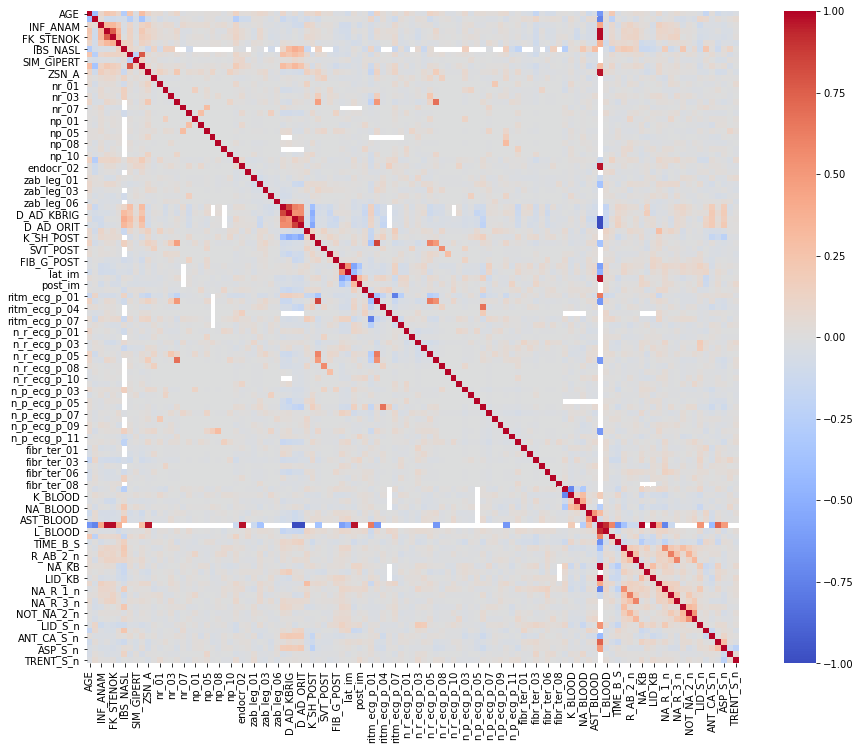

In [15]:
plt.figure(figsize = (16, 12))
sns.heatmap(corr_mat, square=True, vmin=-1, vmax=1, cmap='coolwarm')
pass

# Подготовка данных

## Предварительная обработка данных
Создание пайплайна для обработки данных, включающего в себя удаление столбцов с пропущенными значениями, заполнение оставшихся пропущенных значений медианой и нормализацию

In [16]:
from sklearn.pipeline import Pipeline
from sklearn.base import BaseEstimator, TransformerMixin
from sklearn.preprocessing import MinMaxScaler
from sklearn.impute import SimpleImputer

class AttributeRemover(BaseEstimator, TransformerMixin):
    def __init__(self, threshold=0.5):
        self.threshold = threshold
    def fit(self, X, y=None):
        return self
    def transform(self, X):
        X_remove = X.copy()
        miss_val_counts = X_remove.isnull().sum()
        for key in X_remove.keys():
            if miss_val_counts[key] / X.shape[0] > self.threshold:
                del X_remove[key]
        return X_remove

threshold=0.5

prepare_pipeline = Pipeline(steps=[
        ('remover', AttributeRemover(threshold)),
        ('imputer', SimpleImputer(strategy = "median")),
        ('min_max_scaler', MinMaxScaler())
    ])
X_trains_remove = {}
for i in X_trains.keys():
    tmp = prepare_pipeline.fit_transform(X_trains[i])
    X_trains_remove[i] = pd.DataFrame(tmp, columns = AttributeRemover(threshold).transform(X_trains[i]).columns)    
X_trains_remove['LET_IS']

,AGE,SEX,INF_ANAM,STENOK_AN,FK_STENOK,IBS_POST,GB,SIM_GIPERT,DLIT_AG,ZSN_A,...,NOT_NA_1_n,NOT_NA_2_n,NOT_NA_3_n,LID_S_n,B_BLOK_S_n,ANT_CA_S_n,GEPAR_S_n,ASP_S_n,TIKL_S_n,TRENT_S_n
0,0.560606,1.0,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.000000,0.0,...,0.00,0.000000,0.0,1.0,0.0,1.0,1.0,1.0,0.0,1.0
1,0.575758,0.0,0.333333,0.000000,0.0,1.0,0.666667,1.0,0.142857,0.0,...,0.00,0.000000,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0
2,0.575758,1.0,0.000000,0.666667,0.5,1.0,0.000000,0.0,0.000000,0.0,...,0.00,0.000000,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0
3,0.166667,1.0,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.000000,0.0,...,0.00,0.000000,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0
4,0.424242,1.0,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.000000,0.0,...,0.00,0.000000,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
1270,0.106061,1.0,0.333333,0.000000,0.0,1.0,0.000000,0.0,0.000000,0.0,...,0.00,0.000000,0.0,1.0,0.0,1.0,1.0,1.0,0.0,0.0
1271,0.560606,1.0,0.000000,0.166667,0.5,0.0,0.000000,1.0,0.714286,0.0,...,0.00,0.000000,0.0,0.0,1.0,0.0,0.0,1.0,0.0,0.0
1272,0.575758,0.0,0.000000,0.000000,0.0,1.0,0.666667,0.0,0.142857,0.5,...,1.00,0.666667,1.0,1.0,0.0,1.0,0.0,1.0,0.0,0.0
1273,0.530303,0.0,0.000000,0.000000,0.0,0.0,0.666667,0.0,0.142857,0.0,...,0.00,0.000000,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0


## Построение матрицы корреляции для обработанных данных

In [17]:
corr_mat = X_trains_remove['LET_IS'].corr()
corr_mat

,AGE,SEX,INF_ANAM,STENOK_AN,FK_STENOK,IBS_POST,GB,SIM_GIPERT,DLIT_AG,ZSN_A,...,NOT_NA_1_n,NOT_NA_2_n,NOT_NA_3_n,LID_S_n,B_BLOK_S_n,ANT_CA_S_n,GEPAR_S_n,ASP_S_n,TIKL_S_n,TRENT_S_n
AGE,1.000000,-0.381934,0.086849,0.223539,0.195215,0.098920,0.215818,-0.014850,0.254490,0.124200,...,0.023515,0.000665,0.002299,-0.021434,-0.157042,0.036669,-0.086533,-0.060720,-0.057011,-0.027971
SEX,-0.381934,1.000000,0.035797,-0.095790,-0.112497,-0.094552,-0.256535,-0.056116,-0.316038,-0.081450,...,-0.073212,-0.032419,-0.074805,0.092942,0.082340,-0.016409,0.032699,0.012270,-0.001828,0.059555
INF_ANAM,0.086849,0.035797,1.000000,0.318831,0.331807,0.222226,0.110774,-0.012136,0.133230,0.164824,...,-0.057488,0.031626,-0.021058,-0.098764,-0.005787,-0.038958,-0.013750,-0.042483,-0.012380,0.033345
STENOK_AN,0.223539,-0.095790,0.318831,1.000000,0.728728,0.345614,0.145652,-0.038851,0.209019,0.094114,...,0.051819,0.032170,0.004787,-0.047243,-0.041431,0.001398,0.003350,-0.007309,-0.045090,0.018907
FK_STENOK,0.195215,-0.112497,0.331807,0.728728,1.000000,0.414101,0.141893,-0.037073,0.160245,0.127458,...,0.006288,0.006569,-0.016817,-0.075319,-0.058107,-0.043600,-0.043823,-0.078865,-0.056519,0.051372
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
ANT_CA_S_n,0.036669,-0.016409,-0.038958,0.001398,-0.043600,0.025297,0.076090,0.010968,0.075444,-0.009867,...,0.054862,0.032068,0.002284,-0.004902,-0.140156,1.000000,-0.002410,0.080255,0.024942,0.019329
GEPAR_S_n,-0.086533,0.032699,-0.013750,0.003350,-0.043823,-0.048067,0.003779,-0.067767,0.022867,-0.065653,...,0.074613,0.061236,0.020991,0.062606,-0.007965,-0.002410,1.000000,0.266275,-0.001420,-0.017892
ASP_S_n,-0.060720,0.012270,-0.042483,-0.007309,-0.078865,-0.034488,0.012041,-0.051478,0.027453,-0.051057,...,0.013350,-0.054803,-0.009529,0.051088,0.034226,0.080255,0.266275,1.000000,-0.095643,-0.226850
TIKL_S_n,-0.057011,-0.001828,-0.012380,-0.045090,-0.056519,-0.029629,-0.052923,0.047410,-0.039808,0.010901,...,0.001931,-0.019872,-0.030485,-0.024162,0.040280,0.024942,-0.001420,-0.095643,1.000000,0.038506


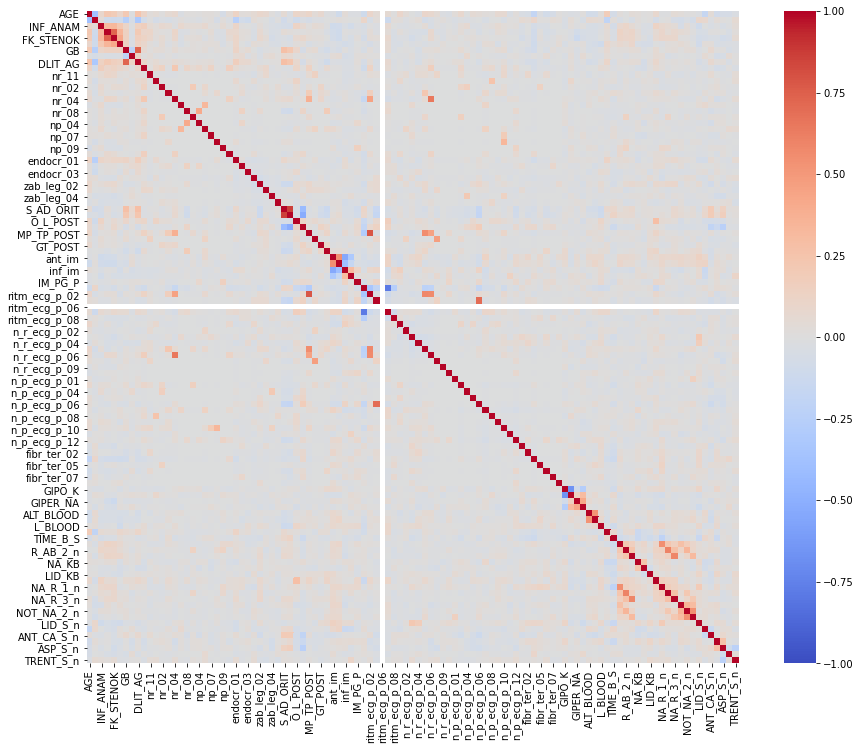

In [18]:
plt.figure(figsize = (16, 12))
sns.heatmap(corr_mat, square=True, vmin=-1, vmax=1, cmap='coolwarm')
pass

## Анализ структуры данных с помощью elpigraph

Создание нового пайплайна для отображения признаков на результате работы (без нормализации). Обработка данных через него.

In [ ]:
import elpigraph
graph_pipeline = Pipeline(steps=[
        ('remover', AttributeRemover(threshold)),
        ('imputer', SimpleImputer(strategy = "median"))
        #('min_max_scaler', MinMaxScaler())
    ])
tmp = graph_pipeline.fit_transform(X_trains['LET_IS_BIN'])
nice_data = pd.DataFrame(tmp, columns = AttributeRemover(threshold).transform(X_trains['LET_IS_BIN']).columns)
data = X_trains_remove['LET_IS_BIN'].to_numpy()

Генерация графа с 200 вершинами

In [39]:
tree_200 = elpigraph.computeElasticPrincipalTree(data, 200)

Generating the initial configuration
Creating a chain in the 1st PC with 2 nodes
90% of the points have been used as initial conditions. Resetting.
Constructing tree 1 of 1 / Subset 1 of 1
Performing PCA
Using standard PCA
107 dimensions are being used
100.0 % of the original variance has been retained
The elastic matrix is being used. Edge configuration will be ignored
Computing EPG with  200  nodes on  1275  points and  107  dimensions
Nodes =  2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89 90 91 92 93 94 95 96 97 98 99 100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162 163 164 165

Вывод результата алгоритма. Для вывода используется метод главных компонент (PCA) для уменьшения размерности массива данных до двумерного. В данном графике красные точки соответствуют смертельным исходам, а фиолетовые - выжившим пациентам.

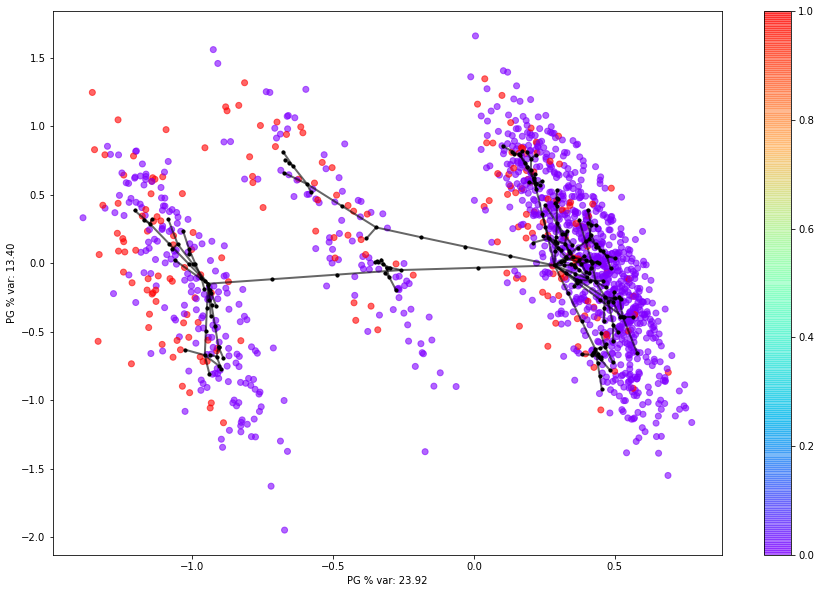

In [205]:
elpigraph.plot.ColoredPlotPG(data, tree_200[0], X_color=y_trains['LET_IS_BIN'].to_numpy(), X_cmap='rainbow', node_size=10)

Метод главных компонент разделил данные на три неравномерных кластера. Произведя анализ распределений для каждого признака, можно сказать, что такое разделение было основано на 4ех признаках:

In [113]:
nice_data.keys()[45]

'ritm_ecg_p_01'

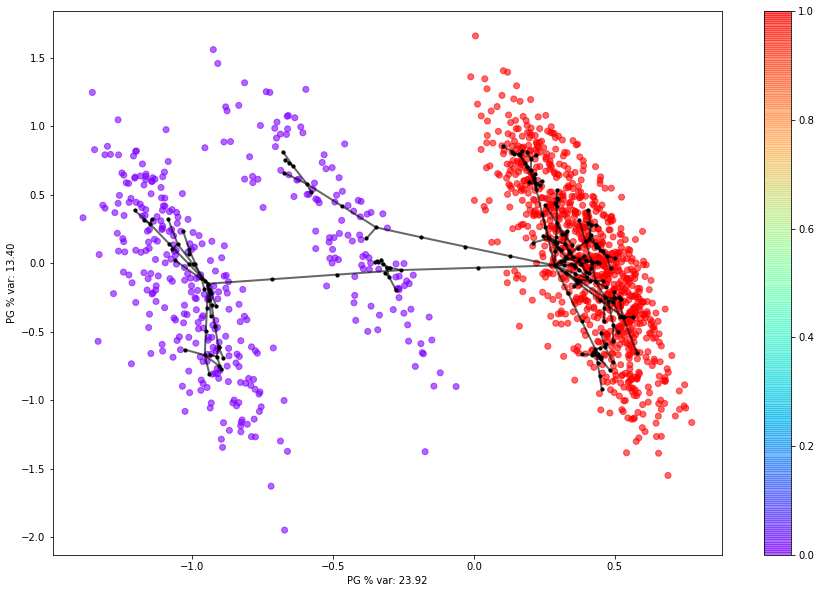

In [207]:
show_key = nice_data.keys()[45]
elpigraph.plot.ColoredPlotPG(data, tree_200[0], X_color=nice_data[show_key].to_numpy(), X_cmap='rainbow', node_size=10)

In [119]:
nice_data.keys()[46]

'ritm_ecg_p_02'

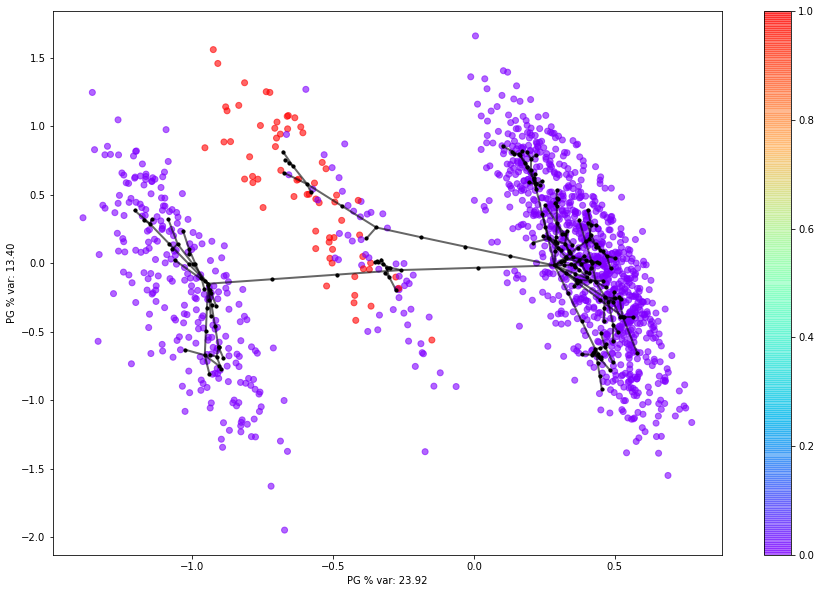

In [208]:
show_key = nice_data.keys()[46]
elpigraph.plot.ColoredPlotPG(data, tree_200[0], X_color=nice_data[show_key].to_numpy(), X_cmap='rainbow', node_size=10)

In [120]:
nice_data.keys()[49]

'ritm_ecg_p_07'

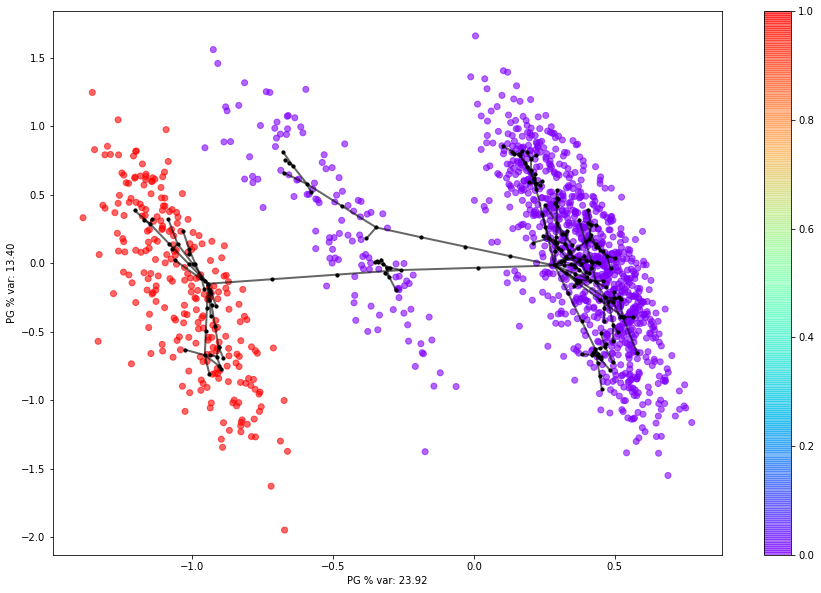

In [209]:
show_key = nice_data.keys()[49]
elpigraph.plot.ColoredPlotPG(data, tree_200[0], X_color=nice_data[show_key].to_numpy(), X_cmap='rainbow', node_size=10)

In [122]:
nice_data.keys()[50]

'ritm_ecg_p_08'

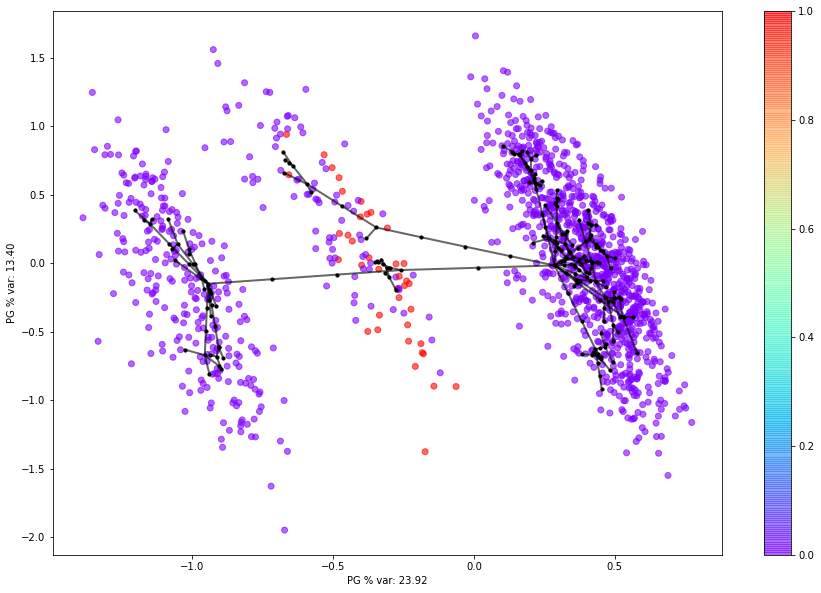

In [210]:
show_key = nice_data.keys()[50]
elpigraph.plot.ColoredPlotPG(data, tree_200[0], X_color=nice_data[show_key].to_numpy(), X_cmap='rainbow', node_size=10)

Графики для всех признаков доступны в приложении 1.

### OverSampling

Ввиду несбалансированности датасета необходимо использовать методы увеличения количества записей с ключевым для нас признаком, то есть записей ЭКГ пациентов с летальными исходами. Для этого будет использовать специальная библиотека imbalanced dataset 

In [126]:
from sklearn.utils import resample

class OverSampler(BaseEstimator, TransformerMixin):
    def __init__(self):
        pass
    def fit(self, X, y=None):
        return self
    def transform(self, X, y):
        X_c = X.copy()
        y_c = y.copy()
        y_c.index = range(y_c.size)
        train_data = pd.concat([X, y_c], axis=1)
        class_split = {}
        feature_name = y_c.name
        for i in y_c.unique():
            class_split[i] = train_data[train_data[feature_name] == i]
        samples_value = max([len(class_split[i]) for i in class_split.keys()])
        class_split_upsample = {}
        train_data = pd.DataFrame()
        for i in class_split.keys():
            class_split_upsample[i] = resample(class_split[i], replace = True, n_samples=samples_value, random_state=42)
            train_data = pd.concat([train_data, class_split_upsample[i]])
        y_result = train_data[feature_name]
        del train_data[y_c.name]
        X_result = train_data
        return X_result, y_result

In [127]:
from imblearn.over_sampling import SMOTENC

"""class SMOTE_OverSampler(BaseEstimator, TransformerMixin):
    def __init__(self):
        pass
    def fit(self, X, y = None):
        return self
    def transform(self, X, y):
        X_c = X.copy()
        y_c = y.copy()
        sm = SMOTENC(random_state=42, ratio=1.0)
        X_result, y_result = sm.fit_sample(X_c, y_c)
        return X_result, y_result"""

'class SMOTE_OverSampler(BaseEstimator, TransformerMixin):\n    def __init__(self):\n        pass\n    def fit(self, X, y = None):\n        return self\n    def transform(self, X, y):\n        X_c = X.copy()\n        y_c = y.copy()\n        sm = SMOTENC(random_state=42, ratio=1.0)\n        X_result, y_result = sm.fit_sample(X_c, y_c)\n        return X_result, y_result'

In [128]:
X_upsamples = {}
y_upsamples = {}
smote_nc = SMOTENC(categorical_features=[i for i in range(1, 107)], random_state=42)
for i in X_trains_remove.keys():
    #X_upsamples[i], y_upsamples[i] = OverSampler().transform(X_trains_remove[i], y_trains[i])
    X_upsamples[i], y_upsamples[i] = smote_nc.fit_resample(X_trains_remove[i], y_trains[i])

In [129]:
X_upsamples['LET_IS_BIN']

,AGE,SEX,INF_ANAM,STENOK_AN,FK_STENOK,IBS_POST,GB,SIM_GIPERT,DLIT_AG,ZSN_A,...,NOT_NA_1_n,NOT_NA_2_n,NOT_NA_3_n,LID_S_n,B_BLOK_S_n,ANT_CA_S_n,GEPAR_S_n,ASP_S_n,TIKL_S_n,TRENT_S_n
0,0.772727,1.0,0.333333,0.833333,0.5,1.0,0.666667,0.0,0.857143,0.5,...,0.0,0.666667,1.0,0.0,1.0,1.0,1.0,1.0,0.0,0.0
1,0.454545,1.0,0.333333,0.000000,0.0,0.0,0.666667,0.0,0.428571,0.0,...,0.0,0.000000,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0
2,0.196970,1.0,0.000000,0.000000,0.0,0.0,0.000000,1.0,0.142857,0.0,...,0.0,0.000000,0.0,1.0,0.0,1.0,1.0,1.0,0.0,0.0
3,0.348485,1.0,0.666667,1.000000,0.5,1.0,0.666667,0.0,0.428571,0.0,...,0.0,0.000000,0.0,0.0,1.0,0.0,1.0,1.0,0.0,0.0
4,0.636364,0.0,0.000000,0.833333,0.5,1.0,0.666667,0.0,0.714286,0.0,...,0.5,0.666667,0.0,0.0,0.0,1.0,1.0,0.0,0.0,0.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
2139,0.747758,0.0,0.333333,0.166667,0.5,0.5,0.666667,0.0,0.428571,0.0,...,0.0,0.000000,0.0,0.0,0.0,1.0,0.0,0.0,0.0,0.0
2140,0.426636,0.0,0.000000,0.166667,0.5,0.5,0.000000,0.0,0.000000,0.0,...,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2141,0.590946,1.0,0.000000,0.000000,0.0,0.0,0.000000,0.0,0.000000,0.0,...,0.0,0.000000,0.0,0.0,0.0,0.0,0.0,0.0,0.0,0.0
2142,0.555299,1.0,0.000000,1.000000,0.5,1.0,0.666667,0.0,1.000000,0.0,...,0.0,0.000000,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0


In [130]:
y_upsamples['LET_IS_BIN'].value_counts()

1    1072
0    1072
Name: LET_IS_BIN, dtype: int64

Теперь, когда были созданы искусственные записи, и количество записей совпадает, мы можем приступить к экспериментам.

# Оценка различных алгоритмов ML для этих данных

Применим к данным различные алгоритмы машинного обучения и посмотрим, насколько хорошо они справятся с задачей классификации. Будут опробованы следующие алгоритмы:
* Деревья решений (decision trees)
* Random Forest
* Стохастический градиентный спуск (Stochastic Gradient Descent)
* Метод опорных векторов (Support Vector Machine)
* К ближайших соседей (K Nearest Neighbors)

Алгоритмы будут обучаться на тренировочной части данных, затем пробоваться на ней же, а после будут применены к тестовой части данных. В качестве метрик используются:
* Оценка точности в перекрестной валидации (Cross validation)
* Матрица неточностей (confusion matrix)
* Precision, recall и f1_score

## Деревья решений

In [131]:
clfs = {}

#### LET_IS_BIN

In [132]:
from sklearn.tree import DecisionTreeClassifier

class_name = 'LET_IS_BIN'
X_train, y_train = X_upsamples[class_name], y_upsamples[class_name]

clfs[class_name] = DecisionTreeClassifier()
clfs[class_name].fit(X_train, y_train)

DecisionTreeClassifier()

##### Пробы на тренировочном сете

In [133]:
train_predict = clfs[class_name].predict(X_train)
print("Прогнозы {} (5 первых) ".format(class_name), train_predict[:5])
print("Метки {} (5 первых) ".format(class_name), list(y_train[:5]))

Прогнозы LET_IS_BIN (5 первых)  [1 0 0 0 0]
Метки LET_IS_BIN (5 первых)  [1, 0, 0, 0, 0]


##### Cross validation

In [134]:
from sklearn.model_selection import cross_val_score

scores = cross_val_score(clfs[class_name], X_train, y_train,
                         scoring = "accuracy", cv = 5)
print("Scores (cross validation mse): {}".format(scores))
print("Mean:", scores.mean())
print("Standard deviation:", scores.std())

Scores (cross validation mse): [0.65967366 0.88344988 0.8951049  0.87412587 0.88317757]
Mean: 0.839106376489554
Standard deviation: 0.08996323235740192


##### Confusion matrix

[[875 197]
 [178 894]]


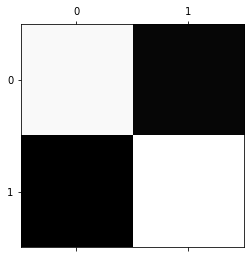

In [135]:
from sklearn.model_selection import cross_val_predict
from sklearn.metrics import confusion_matrix

train_predict = cross_val_predict(clfs[class_name], X_train, y_train, cv=3)
conf_mtrx = confusion_matrix(y_train, train_predict)

row_sum = conf_mtrx.sum(axis=1, keepdims=True)
norm_conf_mtrx = conf_mtrx / row_sum

print(conf_mtrx)
plt.matshow(norm_conf_mtrx, cmap=plt.cm.gray)
plt.show()

##### Precision and recall

In [136]:
from sklearn.metrics import precision_score, recall_score, f1_score

print(precision_score(train_predict, y_train, average=None))
print(recall_score(train_predict, y_train, average=None))
print(f1_score(train_predict, y_train, average=None))


[0.81623134 0.83395522]
[0.83095916 0.81943171]
[0.82352941 0.82662968]


##### Пробы на тестовом сете

In [137]:
X_test = pd.DataFrame(prepare_pipeline.fit_transform(X_tests[class_name]),
                      columns = AttributeRemover(threshold).transform(X_tests[class_name]).columns)
y_test = y_tests[class_name]
y_test.index = range(y_test.size)

In [138]:
X_test

,AGE,SEX,INF_ANAM,STENOK_AN,FK_STENOK,IBS_POST,GB,SIM_GIPERT,DLIT_AG,ZSN_A,...,NOT_NA_1_n,NOT_NA_2_n,NOT_NA_3_n,LID_S_n,B_BLOK_S_n,ANT_CA_S_n,GEPAR_S_n,ASP_S_n,TIKL_S_n,TRENT_S_n
0,0.451613,1.0,0.000000,0.000000,0.00,1.0,0.666667,0.0,0.285714,0.0,...,0.00,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0
1,0.435484,1.0,0.000000,1.000000,0.50,0.5,0.000000,0.0,0.000000,0.0,...,0.25,0.0,0.0,1.0,0.0,1.0,1.0,1.0,0.0,0.0
2,0.580645,1.0,0.333333,1.000000,0.50,0.5,0.666667,0.0,1.000000,0.0,...,0.00,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
3,0.370968,1.0,1.000000,0.833333,0.50,0.5,0.000000,1.0,0.857143,0.0,...,0.25,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0
4,0.225806,1.0,0.333333,0.500000,0.75,1.0,0.666667,0.0,1.000000,0.0,...,0.00,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
420,0.645161,1.0,0.000000,0.166667,0.50,0.5,0.000000,0.0,0.000000,0.0,...,0.00,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0
421,0.064516,1.0,0.333333,0.833333,0.50,0.5,0.666667,0.0,0.428571,0.0,...,0.00,0.0,0.0,1.0,1.0,0.0,1.0,1.0,0.0,0.0
422,0.564516,0.0,0.000000,0.333333,0.50,0.5,0.666667,0.0,0.428571,0.0,...,0.00,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0
423,0.693548,1.0,0.000000,1.000000,0.50,0.5,0.666667,0.0,1.000000,0.0,...,0.25,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0


In [139]:
y_test

0      0
1      0
2      0
3      0
4      0
      ..
420    0
421    0
422    0
423    0
424    0
Name: LET_IS_BIN, Length: 425, dtype: int64

In [140]:
y_test.value_counts()

0    357
1     68
Name: LET_IS_BIN, dtype: int64

In [141]:
test_predict = clfs[class_name].predict(X_test)
print("Прогнозы {} (5 первых) ".format(class_name), test_predict[:5])
print("Метки {} (5 первых) ".format(class_name), list(y_test[:5]))

Прогнозы LET_IS_BIN (5 первых)  [0 0 0 1 0]
Метки LET_IS_BIN (5 первых)  [0, 0, 0, 0, 0]


##### Cross validation

In [142]:
from sklearn.model_selection import cross_val_score

scores = cross_val_score(clfs[class_name], X_test, y_test,
                         scoring = "accuracy", cv = 5)
print("Scores (cross validation mse): {}".format(scores))
print("Mean:", scores.mean())
print("Standard deviation:", scores.std())

Scores (cross validation mse): [0.8        0.75294118 0.72941176 0.84705882 0.8       ]
Mean: 0.7858823529411765
Standard deviation: 0.041024931233324


##### Confusion matrix

[[304  53]
 [ 39  29]]


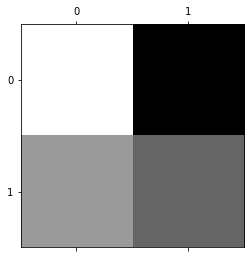

In [143]:
from sklearn.model_selection import cross_val_predict
from sklearn.metrics import confusion_matrix

test_predict = cross_val_predict(clfs[class_name], X_test, y_test, cv=3)
conf_mtrx = confusion_matrix(y_test, test_predict)

row_sum = conf_mtrx.sum(axis=1, keepdims=True)
norm_conf_mtrx = conf_mtrx / row_sum

print(conf_mtrx)
plt.matshow(norm_conf_mtrx, cmap=plt.cm.gray)
plt.show()

##### Precision and recall

In [144]:
from sklearn.metrics import precision_score, recall_score, f1_score

print(precision_score(test_predict, y_test, average=None))
print(recall_score(test_predict, y_test, average=None))
print(f1_score(test_predict, y_test, average=None))


[0.85154062 0.42647059]
[0.88629738 0.35365854]
[0.86857143 0.38666667]


## Random Forest

In [145]:
clfs = {}

#### LET_IS_BIN

In [146]:
from sklearn.ensemble import RandomForestClassifier

class_name = 'LET_IS_BIN'
X_train, y_train = X_upsamples[class_name], y_upsamples[class_name]

clfs[class_name] = RandomForestClassifier()
clfs[class_name].fit(X_train, y_train)

RandomForestClassifier()

##### Пробы на тренировочном сете

In [147]:
train_predict = clfs[class_name].predict(X_train)
print("Прогнозы {} (5 первых) ".format(class_name), train_predict[:5])
print("Метки {} (5 первых) ".format(class_name), list(y_train[:5]))

Прогнозы LET_IS_BIN (5 первых)  [1 0 0 0 0]
Метки LET_IS_BIN (5 первых)  [1, 0, 0, 0, 0]


##### Cross validation

In [148]:
from sklearn.model_selection import cross_val_score

scores = cross_val_score(clfs[class_name], X_train, y_train,
                         scoring = "accuracy", cv = 5)
print("Scores (cross validation mse): {}".format(scores))
print("Mean:", scores.mean())
print("Standard deviation:", scores.std())

Scores (cross validation mse): [0.66200466 0.96270396 0.96969697 0.97668998 0.95093458]
Mean: 0.9044060301069647
Standard deviation: 0.12149885088516739


##### Confusion matrix

[[1015   57]
 [ 156  916]]


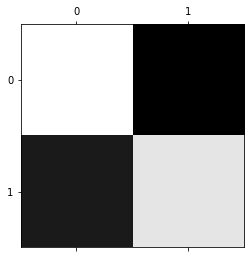

In [149]:
from sklearn.model_selection import cross_val_predict
from sklearn.metrics import confusion_matrix

train_predict = cross_val_predict(clfs[class_name], X_train, y_train, cv=3)
conf_mtrx = confusion_matrix(y_train, train_predict)

row_sum = conf_mtrx.sum(axis=1, keepdims=True)
norm_conf_mtrx = conf_mtrx / row_sum

print(conf_mtrx)
plt.matshow(norm_conf_mtrx, cmap=plt.cm.gray)
plt.show()

##### Precision and recall

In [150]:
from sklearn.metrics import precision_score, recall_score, f1_score

print(precision_score(train_predict, y_train, average=None))
print(recall_score(train_predict, y_train, average=None))
print(f1_score(train_predict, y_train, average=None))


[0.94682836 0.85447761]
[0.86678053 0.94141829]
[0.9050379  0.89584352]


##### Пробы на тестовом сете

In [151]:
X_test = pd.DataFrame(prepare_pipeline.fit_transform(X_tests[class_name]),
                      columns = AttributeRemover(threshold).transform(X_tests[class_name]).columns)
y_test = y_tests[class_name]
y_test.index = range(y_test.size)

In [152]:
X_test

,AGE,SEX,INF_ANAM,STENOK_AN,FK_STENOK,IBS_POST,GB,SIM_GIPERT,DLIT_AG,ZSN_A,...,NOT_NA_1_n,NOT_NA_2_n,NOT_NA_3_n,LID_S_n,B_BLOK_S_n,ANT_CA_S_n,GEPAR_S_n,ASP_S_n,TIKL_S_n,TRENT_S_n
0,0.451613,1.0,0.000000,0.000000,0.00,1.0,0.666667,0.0,0.285714,0.0,...,0.00,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0
1,0.435484,1.0,0.000000,1.000000,0.50,0.5,0.000000,0.0,0.000000,0.0,...,0.25,0.0,0.0,1.0,0.0,1.0,1.0,1.0,0.0,0.0
2,0.580645,1.0,0.333333,1.000000,0.50,0.5,0.666667,0.0,1.000000,0.0,...,0.00,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
3,0.370968,1.0,1.000000,0.833333,0.50,0.5,0.000000,1.0,0.857143,0.0,...,0.25,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0
4,0.225806,1.0,0.333333,0.500000,0.75,1.0,0.666667,0.0,1.000000,0.0,...,0.00,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
420,0.645161,1.0,0.000000,0.166667,0.50,0.5,0.000000,0.0,0.000000,0.0,...,0.00,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0
421,0.064516,1.0,0.333333,0.833333,0.50,0.5,0.666667,0.0,0.428571,0.0,...,0.00,0.0,0.0,1.0,1.0,0.0,1.0,1.0,0.0,0.0
422,0.564516,0.0,0.000000,0.333333,0.50,0.5,0.666667,0.0,0.428571,0.0,...,0.00,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0
423,0.693548,1.0,0.000000,1.000000,0.50,0.5,0.666667,0.0,1.000000,0.0,...,0.25,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0


In [153]:
y_test

0      0
1      0
2      0
3      0
4      0
      ..
420    0
421    0
422    0
423    0
424    0
Name: LET_IS_BIN, Length: 425, dtype: int64

In [154]:
y_test.value_counts()

0    357
1     68
Name: LET_IS_BIN, dtype: int64

In [155]:
test_predict = clfs[class_name].predict(X_test)
print("Прогнозы {} (5 первых) ".format(class_name), test_predict[:5])
print("Метки {} (5 первых) ".format(class_name), list(y_test[:5]))

Прогнозы LET_IS_BIN (5 первых)  [0 0 0 0 0]
Метки LET_IS_BIN (5 первых)  [0, 0, 0, 0, 0]


##### Cross validation

In [156]:
from sklearn.model_selection import cross_val_score

scores = cross_val_score(clfs[class_name], X_test, y_test,
                         scoring = "accuracy", cv = 5)
print("Scores (cross validation mse): {}".format(scores))
print("Mean:", scores.mean())
print("Standard deviation:", scores.std())

Scores (cross validation mse): [0.87058824 0.84705882 0.87058824 0.85882353 0.85882353]
Mean: 0.8611764705882352
Standard deviation: 0.00880389973358576


##### Confusion matrix

[[357   0]
 [ 58  10]]


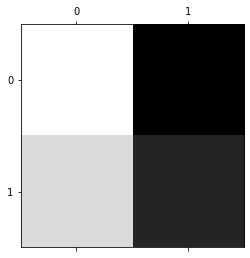

In [157]:
from sklearn.model_selection import cross_val_predict
from sklearn.metrics import confusion_matrix

test_predict = cross_val_predict(clfs[class_name], X_test, y_test, cv=3)
conf_mtrx = confusion_matrix(y_test, test_predict)

row_sum = conf_mtrx.sum(axis=1, keepdims=True)
norm_conf_mtrx = conf_mtrx / row_sum

print(conf_mtrx)
plt.matshow(norm_conf_mtrx, cmap=plt.cm.gray)
plt.show()

##### Precision and recall

In [158]:
from sklearn.metrics import precision_score, recall_score, f1_score

print(precision_score(test_predict, y_test, average=None))
print(recall_score(test_predict, y_test, average=None))
print(f1_score(test_predict, y_test, average=None))


[1.         0.14705882]
[0.86024096 1.        ]
[0.92487047 0.25641026]


## Stochastic Gradient Descent (SGD)

In [159]:
clfs = {}

#### LET_IS_BIN

In [160]:
from sklearn.linear_model import SGDClassifier

class_name = 'LET_IS_BIN'
X_train, y_train = X_upsamples[class_name], y_upsamples[class_name]

clfs[class_name] = SGDClassifier(random_state = 42)
clfs[class_name].fit(X_train, y_train)

SGDClassifier(random_state=42)

##### Пробы на тренировочном сете

In [161]:
train_predict = clfs[class_name].predict(X_train)
print("Прогнозы {} (5 первых) ".format(class_name), train_predict[:5])
print("Метки {} (5 первых) ".format(class_name), list(y_train[:5]))

Прогнозы LET_IS_BIN (5 первых)  [1 0 0 0 0]
Метки LET_IS_BIN (5 первых)  [1, 0, 0, 0, 0]


##### Cross validation

In [162]:
from sklearn.model_selection import cross_val_score

scores = cross_val_score(clfs[class_name], X_train, y_train,
                         scoring = "accuracy", cv = 5)
print("Scores (cross validation mse): {}".format(scores))
print("Mean:", scores.mean())
print("Standard deviation:", scores.std())

Scores (cross validation mse): [0.55710956 0.82517483 0.86946387 0.86247086 0.88084112]
Mean: 0.7990120471428883
Standard deviation: 0.12238282850075682


##### Confusion matrix

[[907 165]
 [209 863]]


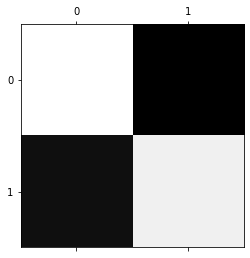

In [163]:
from sklearn.model_selection import cross_val_predict
from sklearn.metrics import confusion_matrix

train_predict = cross_val_predict(clfs[class_name], X_train, y_train, cv=3)
conf_mtrx = confusion_matrix(y_train, train_predict)

row_sum = conf_mtrx.sum(axis=1, keepdims=True)
norm_conf_mtrx = conf_mtrx / row_sum

print(conf_mtrx)
plt.matshow(norm_conf_mtrx, cmap=plt.cm.gray)
plt.show()

##### Precision and recall

In [164]:
from sklearn.metrics import precision_score, recall_score, f1_score

print(precision_score(train_predict, y_train, average=None))
print(recall_score(train_predict, y_train, average=None))
print(f1_score(train_predict, y_train, average=None))


[0.84608209 0.80503731]
[0.81272401 0.83949416]
[0.82906764 0.82190476]


##### Пробы на тестовом сете

In [165]:
X_test = pd.DataFrame(prepare_pipeline.fit_transform(X_tests[class_name]),
                      columns = AttributeRemover(threshold).transform(X_tests[class_name]).columns)
y_test = y_tests[class_name]
y_test.index = range(y_test.size)

In [166]:
X_test

,AGE,SEX,INF_ANAM,STENOK_AN,FK_STENOK,IBS_POST,GB,SIM_GIPERT,DLIT_AG,ZSN_A,...,NOT_NA_1_n,NOT_NA_2_n,NOT_NA_3_n,LID_S_n,B_BLOK_S_n,ANT_CA_S_n,GEPAR_S_n,ASP_S_n,TIKL_S_n,TRENT_S_n
0,0.451613,1.0,0.000000,0.000000,0.00,1.0,0.666667,0.0,0.285714,0.0,...,0.00,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0
1,0.435484,1.0,0.000000,1.000000,0.50,0.5,0.000000,0.0,0.000000,0.0,...,0.25,0.0,0.0,1.0,0.0,1.0,1.0,1.0,0.0,0.0
2,0.580645,1.0,0.333333,1.000000,0.50,0.5,0.666667,0.0,1.000000,0.0,...,0.00,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
3,0.370968,1.0,1.000000,0.833333,0.50,0.5,0.000000,1.0,0.857143,0.0,...,0.25,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0
4,0.225806,1.0,0.333333,0.500000,0.75,1.0,0.666667,0.0,1.000000,0.0,...,0.00,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
420,0.645161,1.0,0.000000,0.166667,0.50,0.5,0.000000,0.0,0.000000,0.0,...,0.00,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0
421,0.064516,1.0,0.333333,0.833333,0.50,0.5,0.666667,0.0,0.428571,0.0,...,0.00,0.0,0.0,1.0,1.0,0.0,1.0,1.0,0.0,0.0
422,0.564516,0.0,0.000000,0.333333,0.50,0.5,0.666667,0.0,0.428571,0.0,...,0.00,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0
423,0.693548,1.0,0.000000,1.000000,0.50,0.5,0.666667,0.0,1.000000,0.0,...,0.25,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0


In [167]:
y_test

0      0
1      0
2      0
3      0
4      0
      ..
420    0
421    0
422    0
423    0
424    0
Name: LET_IS_BIN, Length: 425, dtype: int64

In [168]:
y_test.value_counts()

0    357
1     68
Name: LET_IS_BIN, dtype: int64

In [169]:
test_predict = clfs[class_name].predict(X_test)
print("Прогнозы {} (5 первых) ".format(class_name), test_predict[:5])
print("Метки {} (5 первых) ".format(class_name), list(y_test[:5]))

Прогнозы LET_IS_BIN (5 первых)  [0 0 0 1 0]
Метки LET_IS_BIN (5 первых)  [0, 0, 0, 0, 0]


##### Cross validation

In [170]:
from sklearn.model_selection import cross_val_score

scores = cross_val_score(clfs[class_name], X_test, y_test,
                         scoring = "accuracy", cv = 5)
print("Scores (cross validation mse): {}".format(scores))
print("Mean:", scores.mean())
print("Standard deviation:", scores.std())

Scores (cross validation mse): [0.81176471 0.78823529 0.77647059 0.74117647 0.76470588]
Mean: 0.7764705882352941
Standard deviation: 0.02352941176470588


##### Confusion matrix

[[319  38]
 [ 49  19]]


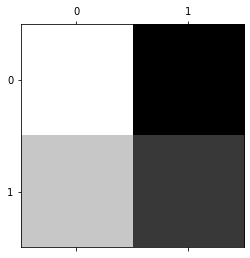

In [171]:
from sklearn.model_selection import cross_val_predict
from sklearn.metrics import confusion_matrix

test_predict = cross_val_predict(clfs[class_name], X_test, y_test, cv=3)
conf_mtrx = confusion_matrix(y_test, test_predict)

row_sum = conf_mtrx.sum(axis=1, keepdims=True)
norm_conf_mtrx = conf_mtrx / row_sum

print(conf_mtrx)
plt.matshow(norm_conf_mtrx, cmap=plt.cm.gray)
plt.show()

##### Precision and recall

In [172]:
from sklearn.metrics import precision_score, recall_score, f1_score

print(precision_score(test_predict, y_test, average=None))
print(recall_score(test_predict, y_test, average=None))
print(f1_score(test_predict, y_test, average=None))


[0.89355742 0.27941176]
[0.86684783 0.33333333]
[0.88  0.304]


## Support Vector Machine

In [173]:
clfs = {}

#### LET_IS_BIN

In [174]:
from sklearn.svm import SVC

class_name = 'LET_IS_BIN'
X_train, y_train = X_upsamples[class_name], y_upsamples[class_name]

clfs[class_name] = SVC()
clfs[class_name].fit(X_train, y_train)

SVC()

##### Пробы на тренировочном сете

In [175]:
train_predict = clfs[class_name].predict(X_train)
print("Прогнозы {} (5 первых) ".format(class_name), train_predict[:5])
print("Метки {} (5 первых) ".format(class_name), list(y_train[:5]))

Прогнозы LET_IS_BIN (5 первых)  [1 0 0 0 0]
Метки LET_IS_BIN (5 первых)  [1, 0, 0, 0, 0]


##### Cross validation

In [176]:
from sklearn.model_selection import cross_val_score

scores = cross_val_score(clfs[class_name], X_train, y_train,
                         scoring = "accuracy", cv = 5)
print("Scores (cross validation mse): {}".format(scores))
print("Mean:", scores.mean())
print("Standard deviation:", scores.std())

Scores (cross validation mse): [0.58275058 0.91375291 0.94638695 0.93006993 0.9182243 ]
Mean: 0.8582369344051587
Standard deviation: 0.13820538463340468


##### Confusion matrix

[[959 113]
 [201 871]]


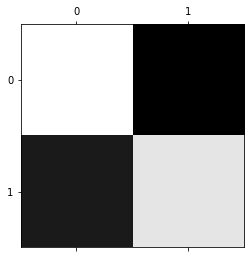

In [177]:
from sklearn.model_selection import cross_val_predict
from sklearn.metrics import confusion_matrix

train_predict = cross_val_predict(clfs[class_name], X_train, y_train, cv=3)
conf_mtrx = confusion_matrix(y_train, train_predict)

row_sum = conf_mtrx.sum(axis=1, keepdims=True)
norm_conf_mtrx = conf_mtrx / row_sum

print(conf_mtrx)
plt.matshow(norm_conf_mtrx, cmap=plt.cm.gray)
plt.show()

##### Precision and recall

In [178]:
from sklearn.metrics import precision_score, recall_score, f1_score

print(precision_score(train_predict, y_train, average=None))
print(recall_score(train_predict, y_train, average=None))
print(f1_score(train_predict, y_train, average=None))


[0.89458955 0.8125    ]
[0.82672414 0.8851626 ]
[0.859319   0.84727626]


##### Пробы на тестовом сете

In [179]:
X_test = pd.DataFrame(prepare_pipeline.fit_transform(X_tests[class_name]),
                      columns = AttributeRemover(threshold).transform(X_tests[class_name]).columns)
y_test = y_tests[class_name]
y_test.index = range(y_test.size)

In [180]:
X_test

,AGE,SEX,INF_ANAM,STENOK_AN,FK_STENOK,IBS_POST,GB,SIM_GIPERT,DLIT_AG,ZSN_A,...,NOT_NA_1_n,NOT_NA_2_n,NOT_NA_3_n,LID_S_n,B_BLOK_S_n,ANT_CA_S_n,GEPAR_S_n,ASP_S_n,TIKL_S_n,TRENT_S_n
0,0.451613,1.0,0.000000,0.000000,0.00,1.0,0.666667,0.0,0.285714,0.0,...,0.00,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0
1,0.435484,1.0,0.000000,1.000000,0.50,0.5,0.000000,0.0,0.000000,0.0,...,0.25,0.0,0.0,1.0,0.0,1.0,1.0,1.0,0.0,0.0
2,0.580645,1.0,0.333333,1.000000,0.50,0.5,0.666667,0.0,1.000000,0.0,...,0.00,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
3,0.370968,1.0,1.000000,0.833333,0.50,0.5,0.000000,1.0,0.857143,0.0,...,0.25,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0
4,0.225806,1.0,0.333333,0.500000,0.75,1.0,0.666667,0.0,1.000000,0.0,...,0.00,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
420,0.645161,1.0,0.000000,0.166667,0.50,0.5,0.000000,0.0,0.000000,0.0,...,0.00,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0
421,0.064516,1.0,0.333333,0.833333,0.50,0.5,0.666667,0.0,0.428571,0.0,...,0.00,0.0,0.0,1.0,1.0,0.0,1.0,1.0,0.0,0.0
422,0.564516,0.0,0.000000,0.333333,0.50,0.5,0.666667,0.0,0.428571,0.0,...,0.00,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0
423,0.693548,1.0,0.000000,1.000000,0.50,0.5,0.666667,0.0,1.000000,0.0,...,0.25,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0


In [181]:
y_test

0      0
1      0
2      0
3      0
4      0
      ..
420    0
421    0
422    0
423    0
424    0
Name: LET_IS_BIN, Length: 425, dtype: int64

In [182]:
y_test.value_counts()

0    357
1     68
Name: LET_IS_BIN, dtype: int64

In [183]:
test_predict = clfs[class_name].predict(X_test)
print("Прогнозы {} (5 первых) ".format(class_name), test_predict[:5])
print("Метки {} (5 первых) ".format(class_name), list(y_test[:5]))

Прогнозы LET_IS_BIN (5 первых)  [0 0 0 1 0]
Метки LET_IS_BIN (5 первых)  [0, 0, 0, 0, 0]


##### Cross validation

In [184]:
from sklearn.model_selection import cross_val_score

scores = cross_val_score(clfs[class_name], X_test, y_test,
                         scoring = "accuracy", cv = 5)
print("Scores (cross validation mse): {}".format(scores))
print("Mean:", scores.mean())
print("Standard deviation:", scores.std())

Scores (cross validation mse): [0.85882353 0.84705882 0.84705882 0.84705882 0.83529412]
Mean: 0.8470588235294118
Standard deviation: 0.007440653318043219


##### Confusion matrix

[[357   0]
 [ 66   2]]


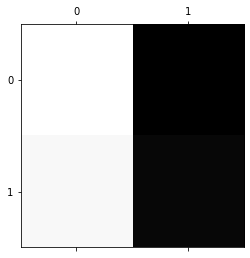

In [185]:
from sklearn.model_selection import cross_val_predict
from sklearn.metrics import confusion_matrix

test_predict = cross_val_predict(clfs[class_name], X_test, y_test, cv=3)
conf_mtrx = confusion_matrix(y_test, test_predict)

row_sum = conf_mtrx.sum(axis=1, keepdims=True)
norm_conf_mtrx = conf_mtrx / row_sum

print(conf_mtrx)
plt.matshow(norm_conf_mtrx, cmap=plt.cm.gray)
plt.show()

##### Precision and recall

In [186]:
from sklearn.metrics import precision_score, recall_score, f1_score

print(precision_score(test_predict, y_test, average=None))
print(recall_score(test_predict, y_test, average=None))
print(f1_score(test_predict, y_test, average=None))


[1.         0.02941176]
[0.84397163 1.        ]
[0.91538462 0.05714286]


## KNN

In [187]:
clfs = {}

#### LET_IS_BIN

In [188]:
from sklearn.neighbors import KNeighborsClassifier

class_name = 'LET_IS_BIN'
X_train, y_train = X_upsamples[class_name], y_upsamples[class_name]

clfs[class_name] = KNeighborsClassifier()
clfs[class_name].fit(X_train, y_train)

KNeighborsClassifier()

##### Пробы на тренировочном сете

In [189]:
train_predict = clfs[class_name].predict(X_train)
print("Прогнозы {} (5 первых) ".format(class_name), train_predict[:5])
print("Метки {} (5 первых) ".format(class_name), list(y_train[:5]))

Прогнозы LET_IS_BIN (5 первых)  [1 1 0 0 1]
Метки LET_IS_BIN (5 первых)  [1, 0, 0, 0, 0]


##### Cross validation

In [190]:
from sklearn.model_selection import cross_val_score

scores = cross_val_score(clfs[class_name], X_train, y_train,
                         scoring = "accuracy", cv = 5)
print("Scores (cross validation mse): {}".format(scores))
print("Mean:", scores.mean())
print("Standard deviation:", scores.std())

Scores (cross validation mse): [0.72027972 0.7995338  0.84149184 0.79020979 0.81308411]
Mean: 0.7929198527329369
Standard deviation: 0.040233103344882025


##### Confusion matrix

[[ 675  397]
 [  44 1028]]


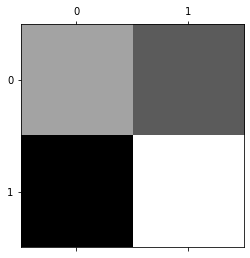

In [191]:
from sklearn.model_selection import cross_val_predict
from sklearn.metrics import confusion_matrix

train_predict = cross_val_predict(clfs[class_name], X_train, y_train, cv=3)
conf_mtrx = confusion_matrix(y_train, train_predict)

row_sum = conf_mtrx.sum(axis=1, keepdims=True)
norm_conf_mtrx = conf_mtrx / row_sum

print(conf_mtrx)
plt.matshow(norm_conf_mtrx, cmap=plt.cm.gray)
plt.show()

##### Precision and recall

In [192]:
from sklearn.metrics import precision_score, recall_score, f1_score

print(precision_score(train_predict, y_train, average=None))
print(recall_score(train_predict, y_train, average=None))
print(f1_score(train_predict, y_train, average=None))


[0.62966418 0.95895522]
[0.93880389 0.72140351]
[0.75376884 0.82338807]


##### Пробы на тестовом сете

In [193]:
X_test = pd.DataFrame(prepare_pipeline.fit_transform(X_tests[class_name]),
                      columns = AttributeRemover(threshold).transform(X_tests[class_name]).columns)
y_test = y_tests[class_name]
y_test.index = range(y_test.size)

In [194]:
X_test

,AGE,SEX,INF_ANAM,STENOK_AN,FK_STENOK,IBS_POST,GB,SIM_GIPERT,DLIT_AG,ZSN_A,...,NOT_NA_1_n,NOT_NA_2_n,NOT_NA_3_n,LID_S_n,B_BLOK_S_n,ANT_CA_S_n,GEPAR_S_n,ASP_S_n,TIKL_S_n,TRENT_S_n
0,0.451613,1.0,0.000000,0.000000,0.00,1.0,0.666667,0.0,0.285714,0.0,...,0.00,0.0,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0
1,0.435484,1.0,0.000000,1.000000,0.50,0.5,0.000000,0.0,0.000000,0.0,...,0.25,0.0,0.0,1.0,0.0,1.0,1.0,1.0,0.0,0.0
2,0.580645,1.0,0.333333,1.000000,0.50,0.5,0.666667,0.0,1.000000,0.0,...,0.00,0.0,0.0,0.0,0.0,0.0,1.0,0.0,0.0,0.0
3,0.370968,1.0,1.000000,0.833333,0.50,0.5,0.000000,1.0,0.857143,0.0,...,0.25,0.0,0.0,0.0,0.0,0.0,1.0,1.0,0.0,0.0
4,0.225806,1.0,0.333333,0.500000,0.75,1.0,0.666667,0.0,1.000000,0.0,...,0.00,0.0,0.0,0.0,1.0,0.0,1.0,0.0,0.0,1.0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
420,0.645161,1.0,0.000000,0.166667,0.50,0.5,0.000000,0.0,0.000000,0.0,...,0.00,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0
421,0.064516,1.0,0.333333,0.833333,0.50,0.5,0.666667,0.0,0.428571,0.0,...,0.00,0.0,0.0,1.0,1.0,0.0,1.0,1.0,0.0,0.0
422,0.564516,0.0,0.000000,0.333333,0.50,0.5,0.666667,0.0,0.428571,0.0,...,0.00,0.0,0.0,0.0,0.0,1.0,1.0,1.0,0.0,0.0
423,0.693548,1.0,0.000000,1.000000,0.50,0.5,0.666667,0.0,1.000000,0.0,...,0.25,0.0,0.0,1.0,0.0,1.0,0.0,0.0,0.0,0.0


In [195]:
y_test

0      0
1      0
2      0
3      0
4      0
      ..
420    0
421    0
422    0
423    0
424    0
Name: LET_IS_BIN, Length: 425, dtype: int64

In [196]:
y_test.value_counts()

0    357
1     68
Name: LET_IS_BIN, dtype: int64

In [197]:
test_predict = clfs[class_name].predict(X_test)
print("Прогнозы {} (5 первых) ".format(class_name), test_predict[:5])
print("Метки {} (5 первых) ".format(class_name), list(y_test[:5]))

Прогнозы LET_IS_BIN (5 первых)  [0 0 1 1 0]
Метки LET_IS_BIN (5 первых)  [0, 0, 0, 0, 0]


##### Cross validation

In [198]:
from sklearn.model_selection import cross_val_score

scores = cross_val_score(clfs[class_name], X_test, y_test,
                         scoring = "accuracy", cv = 5)
print("Scores (cross validation mse): {}".format(scores))
print("Mean:", scores.mean())
print("Standard deviation:", scores.std())

Scores (cross validation mse): [0.85882353 0.84705882 0.84705882 0.82352941 0.84705882]
Mean: 0.844705882352941
Standard deviation: 0.011527010554273779


##### Confusion matrix

[[352   5]
 [ 66   2]]


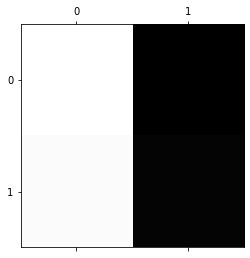

In [199]:
from sklearn.model_selection import cross_val_predict
from sklearn.metrics import confusion_matrix

test_predict = cross_val_predict(clfs[class_name], X_test, y_test, cv=3)
conf_mtrx = confusion_matrix(y_test, test_predict)

row_sum = conf_mtrx.sum(axis=1, keepdims=True)
norm_conf_mtrx = conf_mtrx / row_sum

print(conf_mtrx)
plt.matshow(norm_conf_mtrx, cmap=plt.cm.gray)
plt.show()

##### Precision and recall

In [200]:
from sklearn.metrics import precision_score, recall_score, f1_score

print(precision_score(test_predict, y_test, average=None))
print(recall_score(test_predict, y_test, average=None))
print(f1_score(test_predict, y_test, average=None))

[0.9859944  0.02941176]
[0.84210526 0.28571429]
[0.9083871  0.05333333]


# Заключение (результаты экспериментов и выводы)

Была исследована возможность применения различных алгоритмов машинного обучения в сфере диагностики сердечно-сосудистых заболеваний. Применение алгоритмов машинного обучения на реальных ЭКГ пациентов красноярской больницы, доступных в открытых источниках, показало следующие результаты:
* Если измерять точность классификации с помощью кросс-валидации, лучший результат показывает алгоритм Random forest с 86% точности
* Лучший precision=0.42647059 показывает алгоритм Деревья решений (Decision Trees)
* Лучший recall=1 у алгоритма Random Forest и Support Vector Machine
* Лучший f1_score=0.38666667 показывает алгоритм Деревья решений (Decision Trees)

Из результатов экспериментов можно сделать вывод, что применение этих алгоритмов машинного обучения на этих конкретных данных неэффективно в виду сильной (на порядки) несбалансированности датасета. В данном случае создание искусственных записей с летальными исходами не сильно улучшило результаты, а в случае алгоритма KNN наоборот навредило, вызвав переобучение модели (все 1028 записей с летальным исходом были классифицированы правильно в тренировочной части, однако в тестовой части правильно были выбраны лишь 2 записи). Таким образом, полученные модели показывают низкую эффективность, большое количество ложно-отрицательных случаев и для медицинской диагностики применяться не могут. Необходимо больше данных для летальных исходов для построения корректных моделей по их выявлению.

# Приложение 1 - отображение построенного на данных графа с помощью инструмента ElPiGraph на двумерную плоскость (с помощью метода главных компонент)

0   AGE


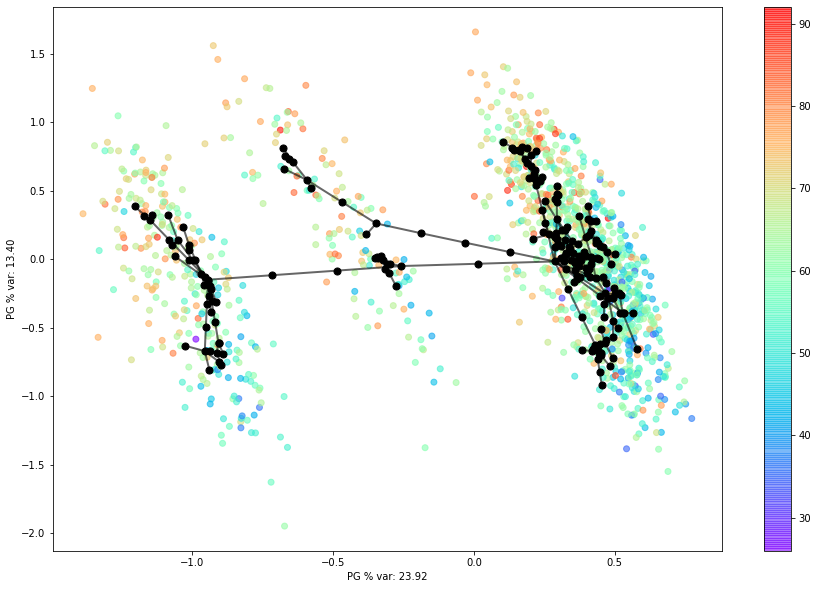

1   SEX


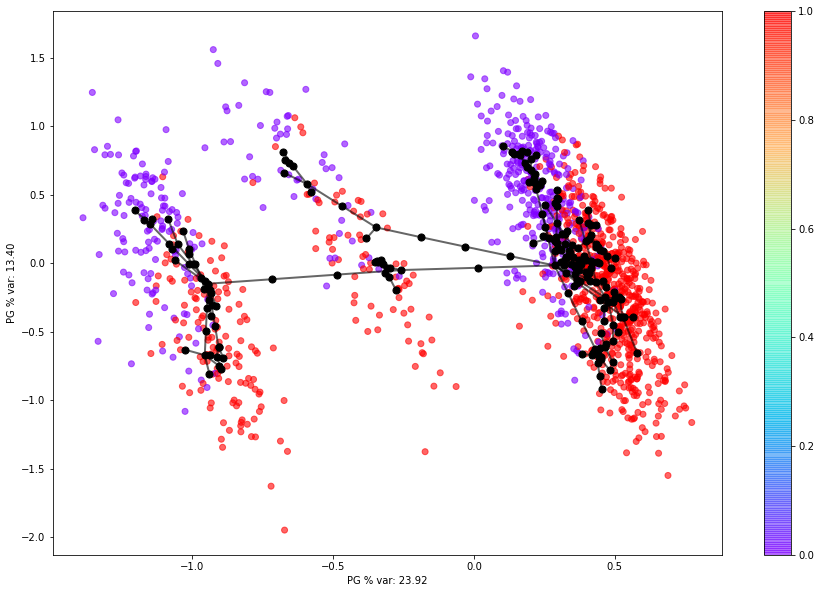

2   INF_ANAM


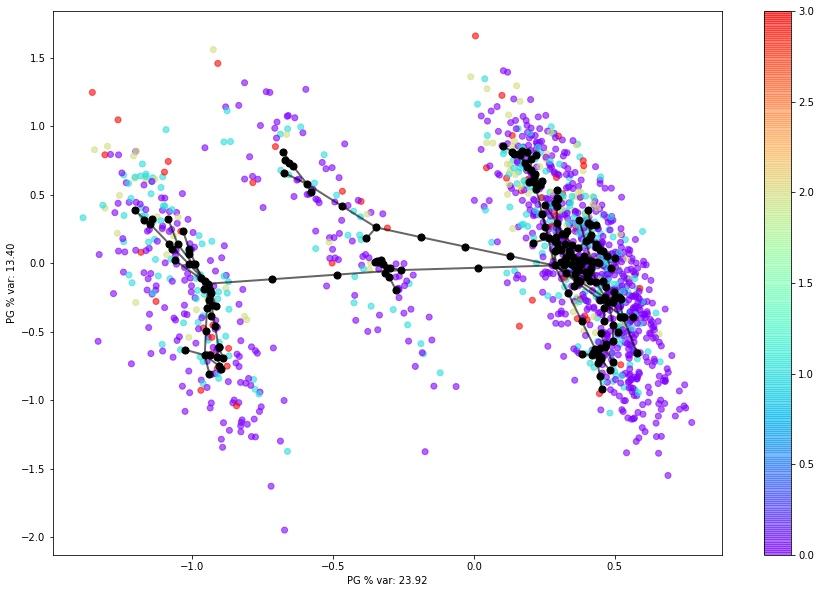

3   STENOK_AN


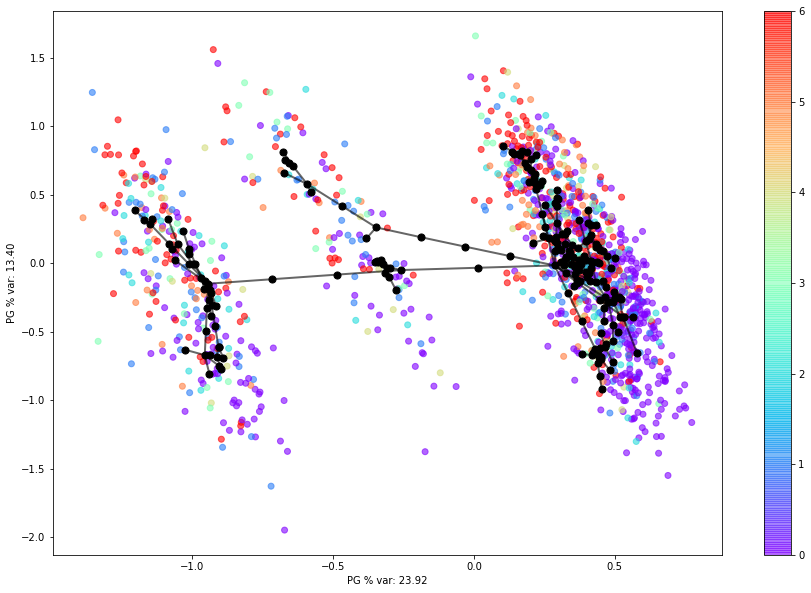

4   FK_STENOK


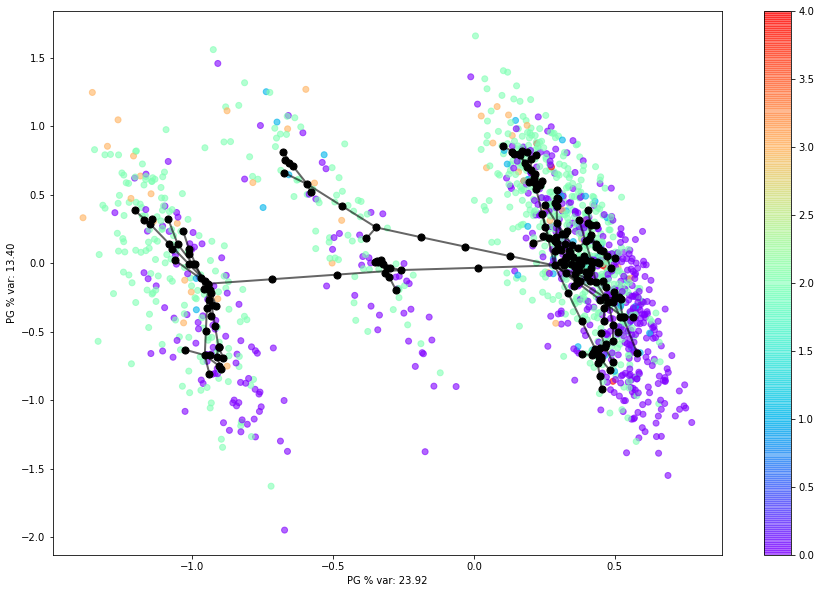

5   IBS_POST


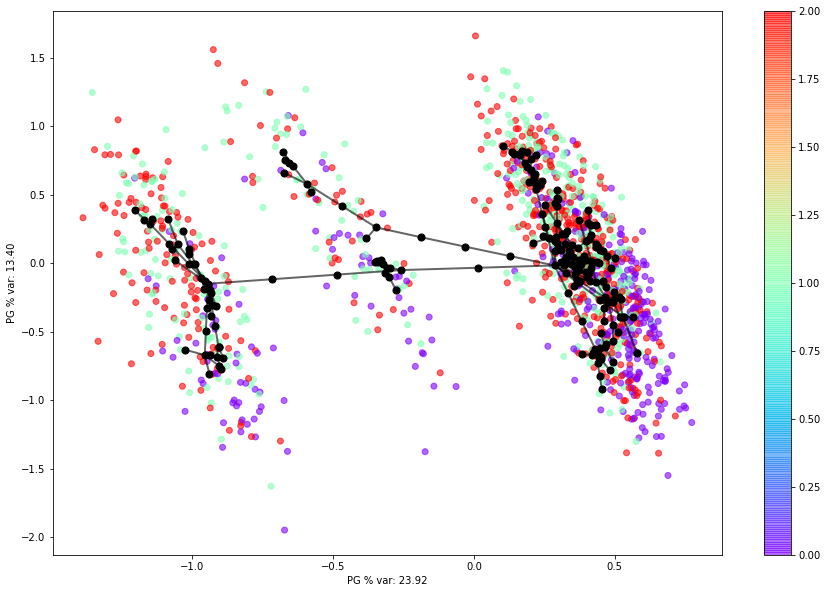

6   GB


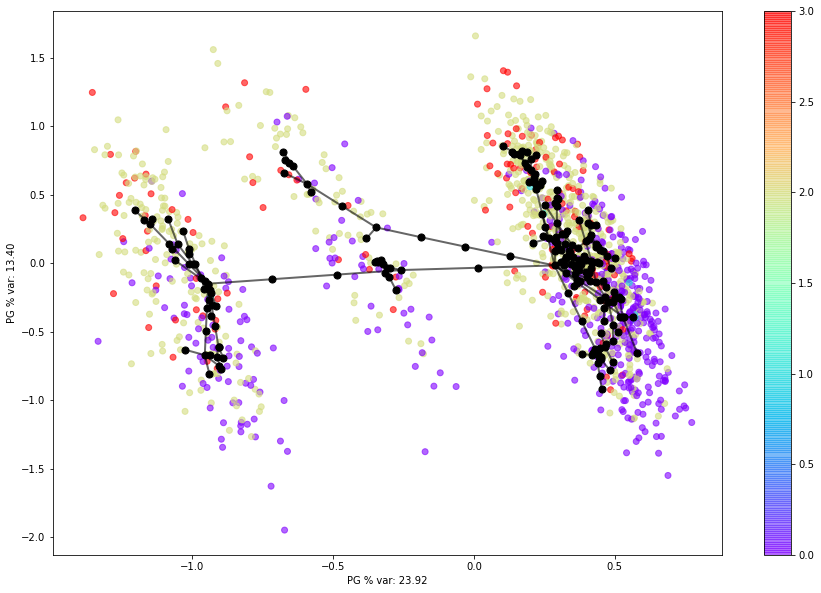

7   SIM_GIPERT


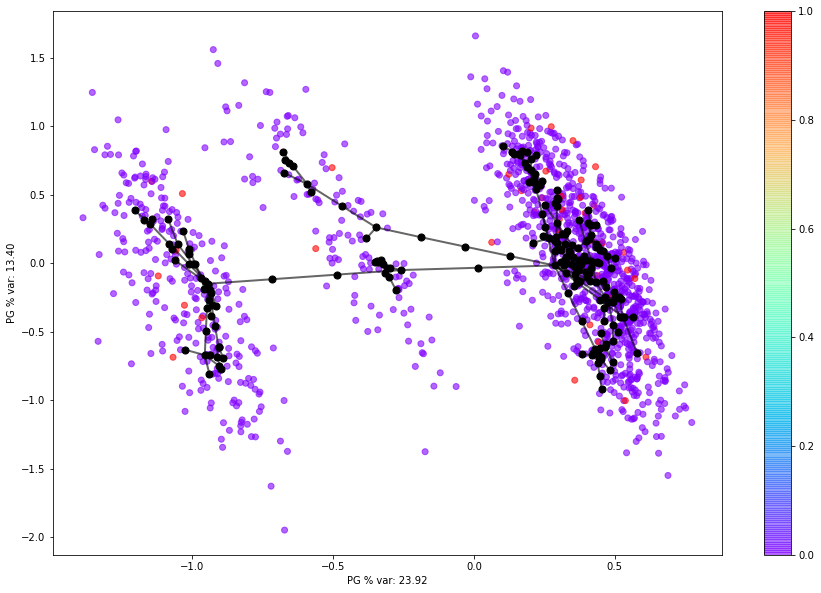

8   DLIT_AG


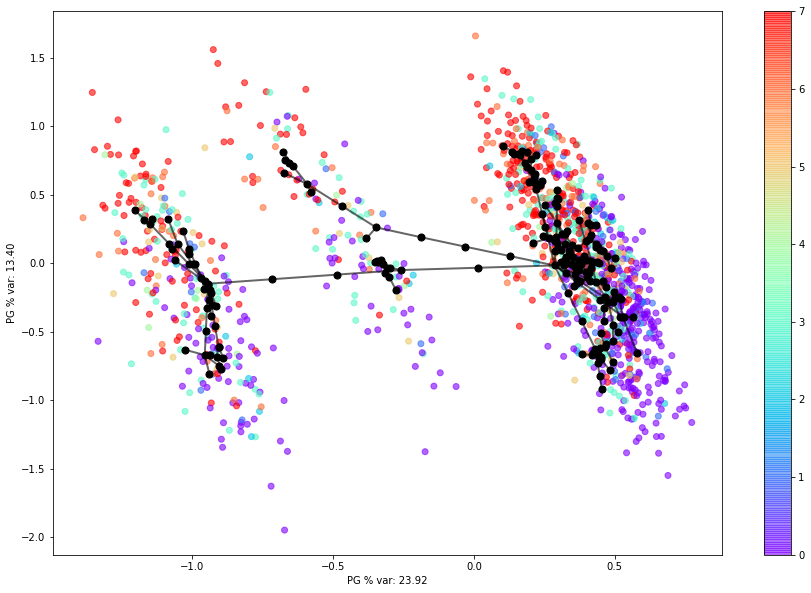

9   ZSN_A


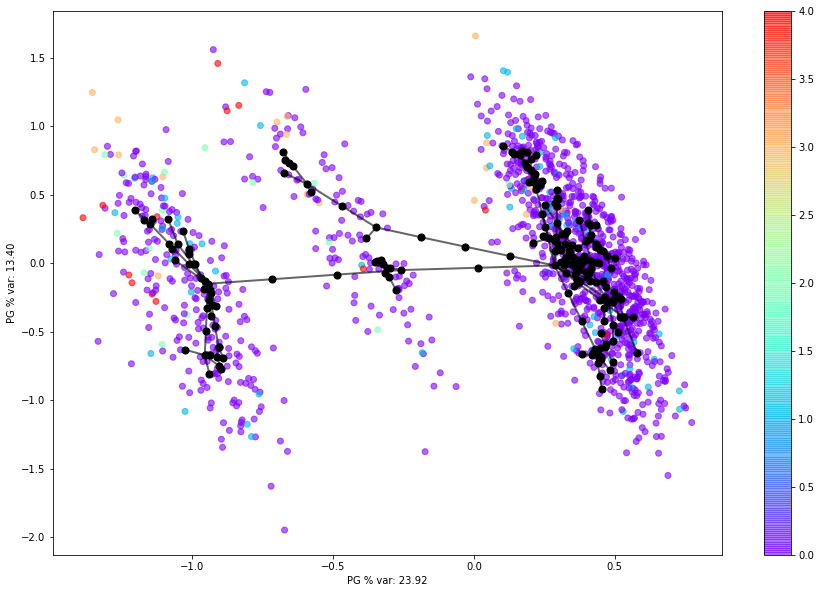

10   nr_11


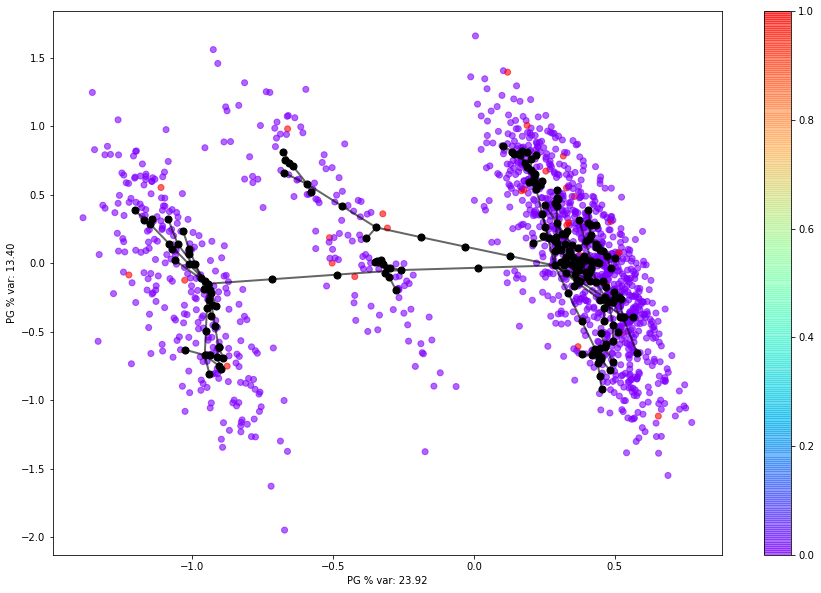

11   nr_01


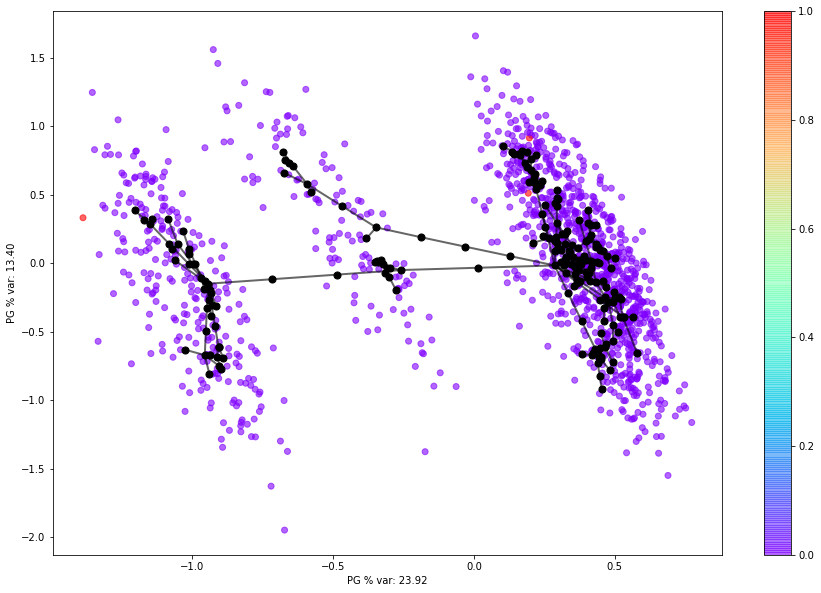

12   nr_02


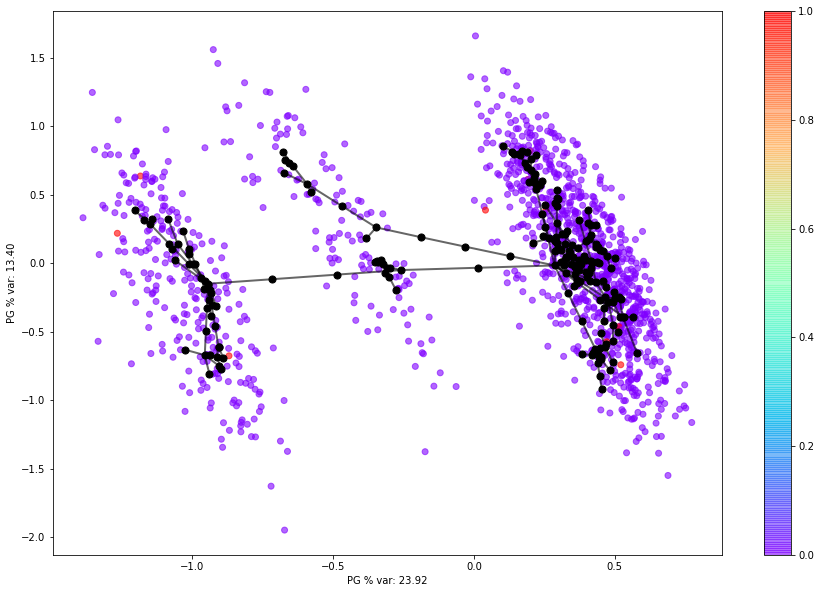

13   nr_03


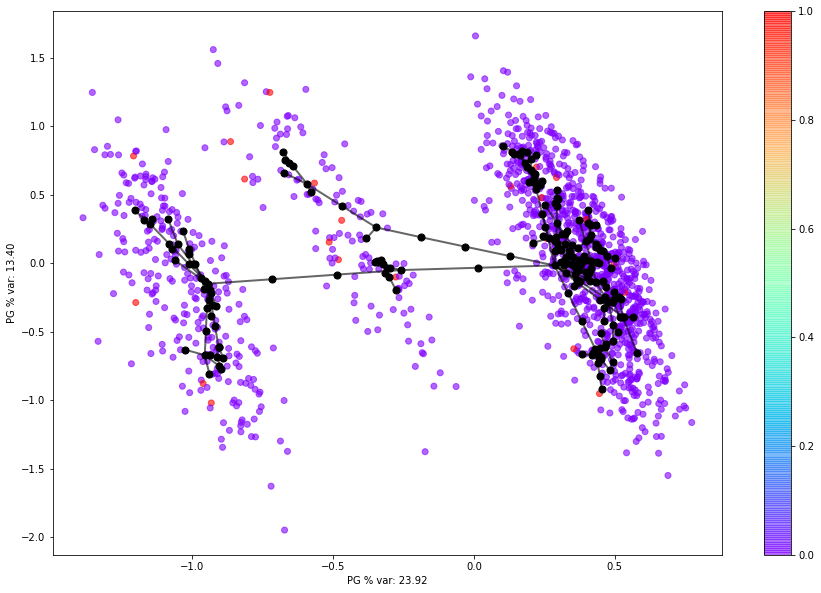

14   nr_04


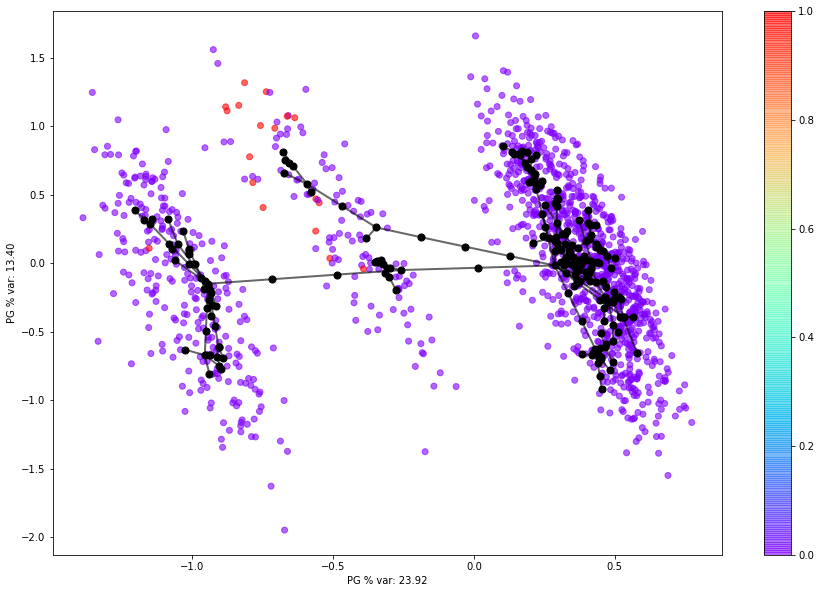

15   nr_07


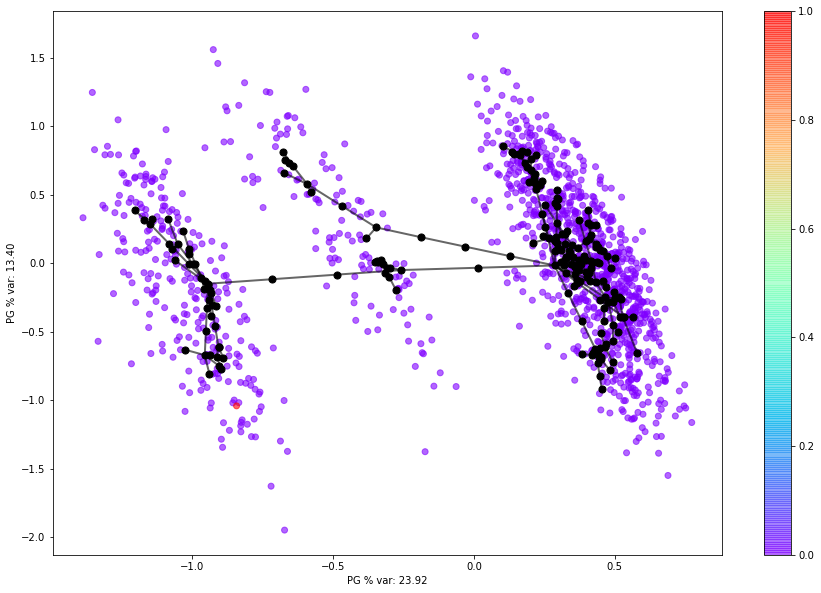

16   nr_08


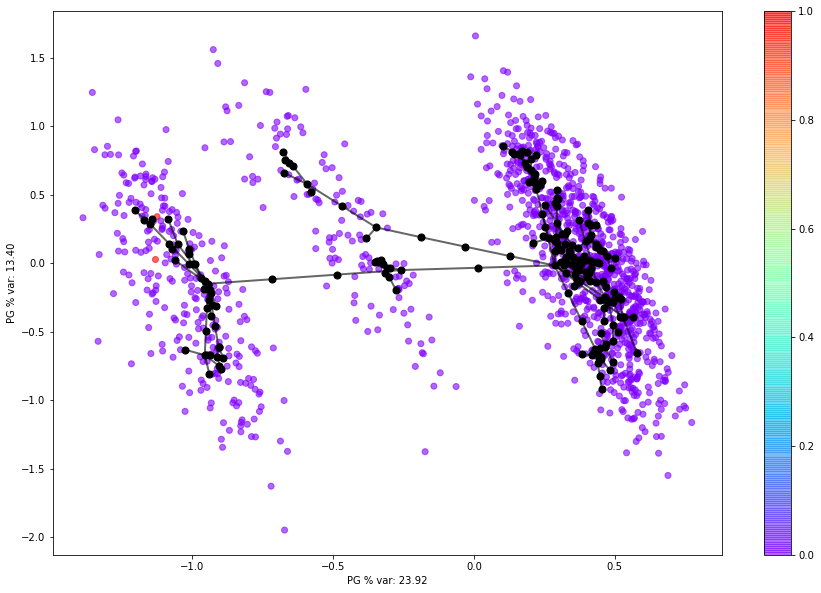

17   np_01


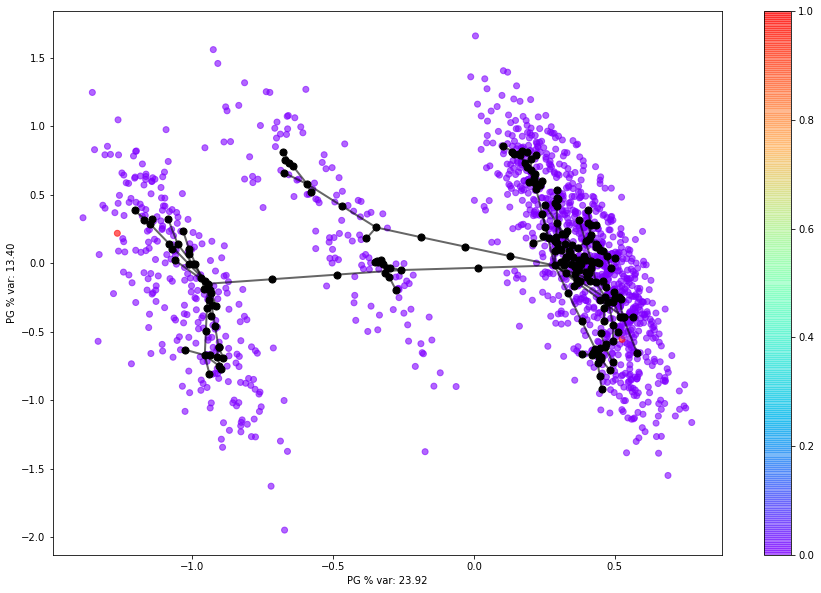

18   np_04


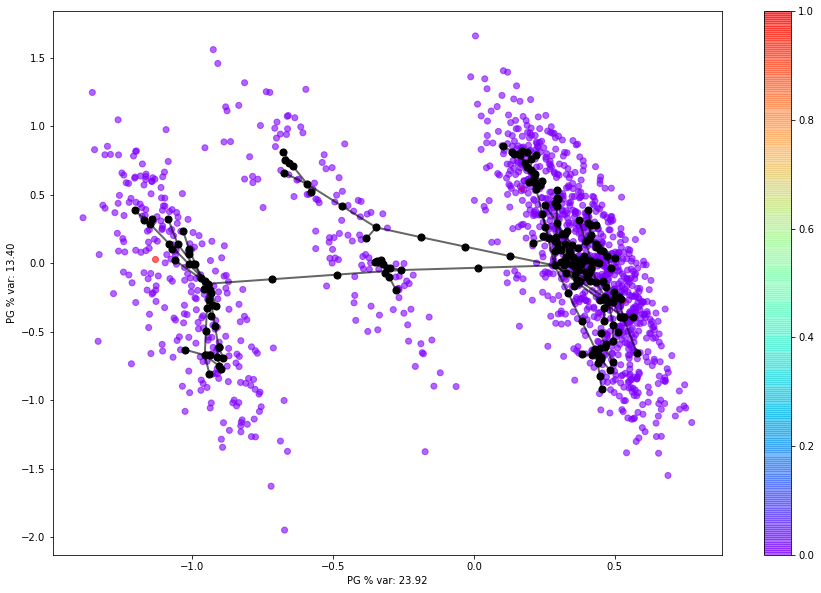

19   np_05


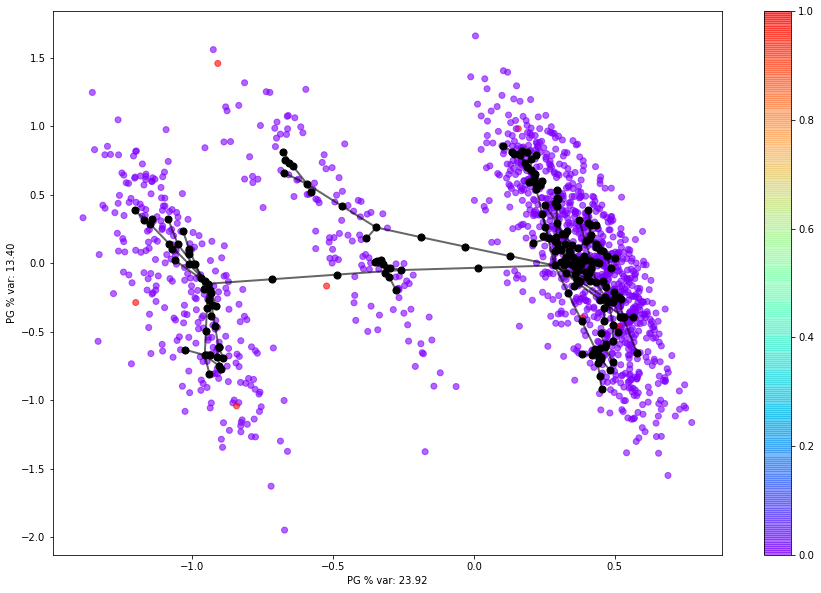

20   np_07


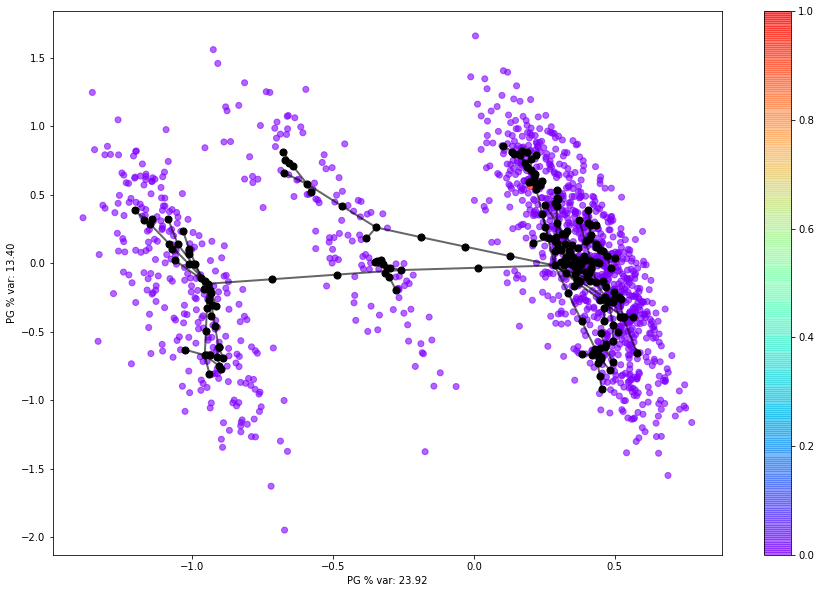

21   np_08


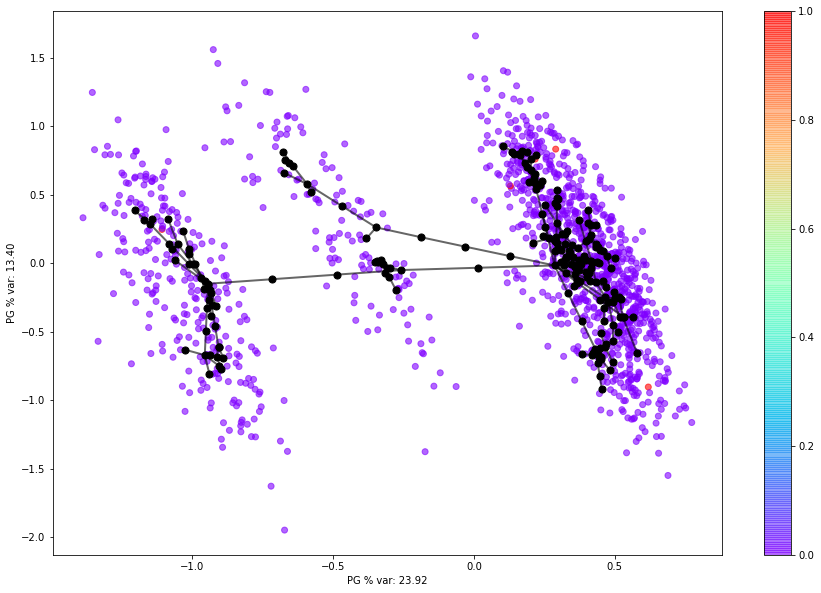

22   np_09


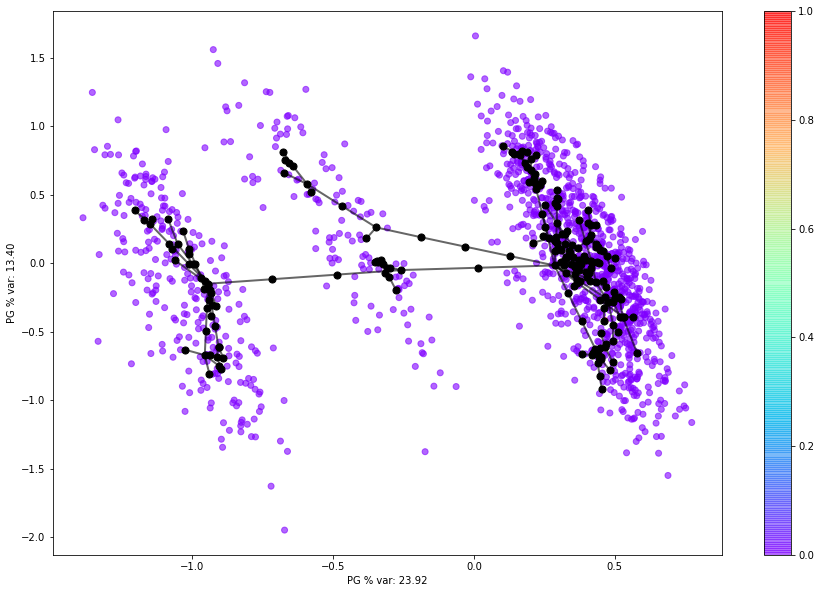

23   np_10


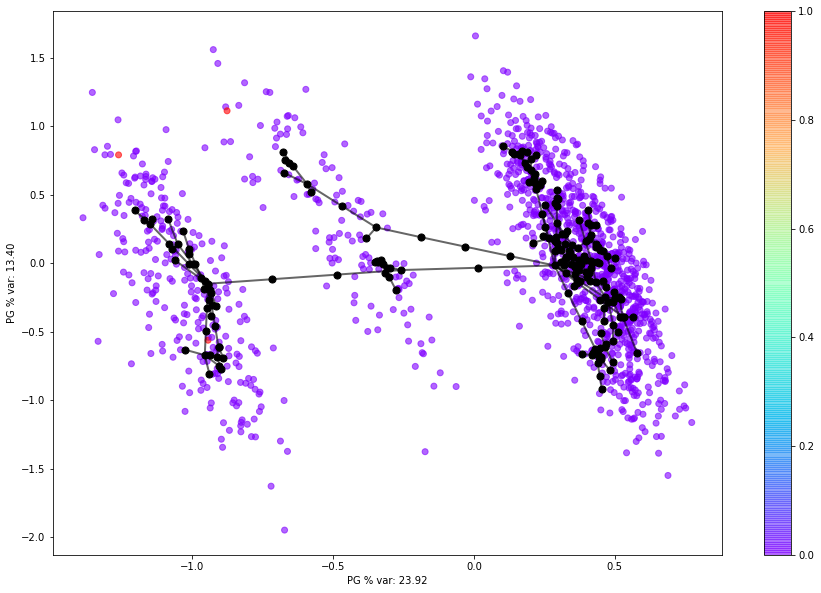

24   endocr_01


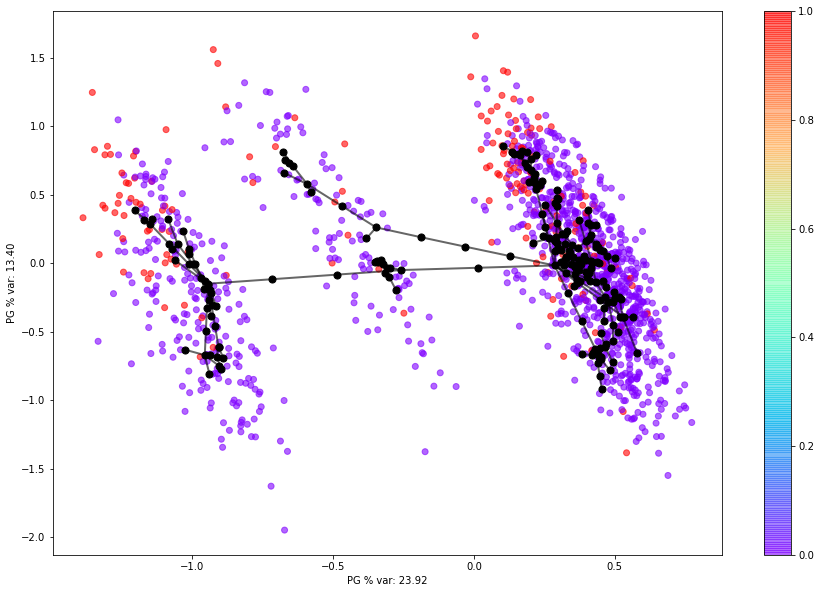

25   endocr_02


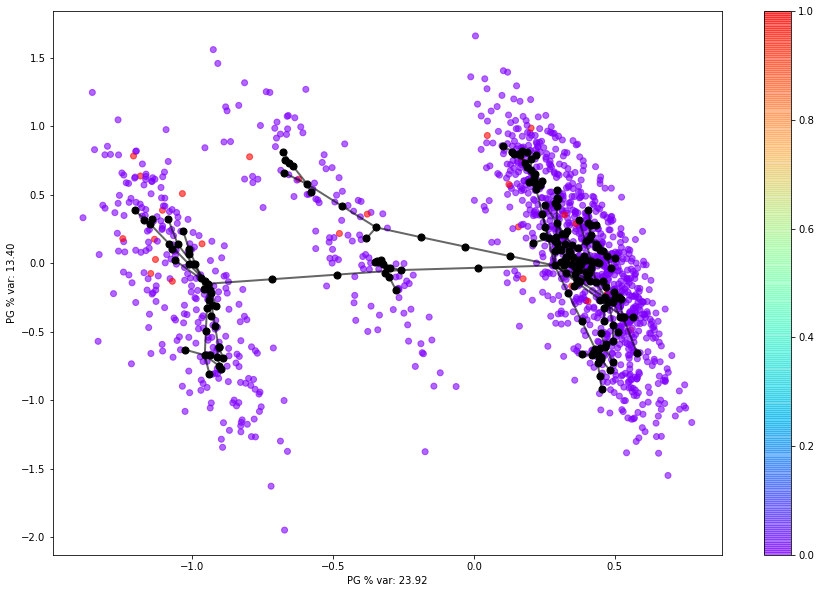

26   endocr_03


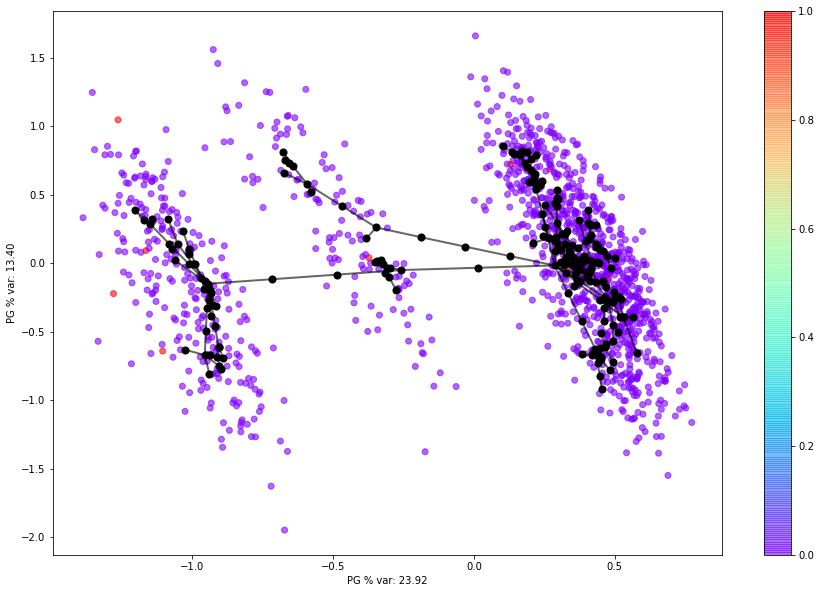

27   zab_leg_01


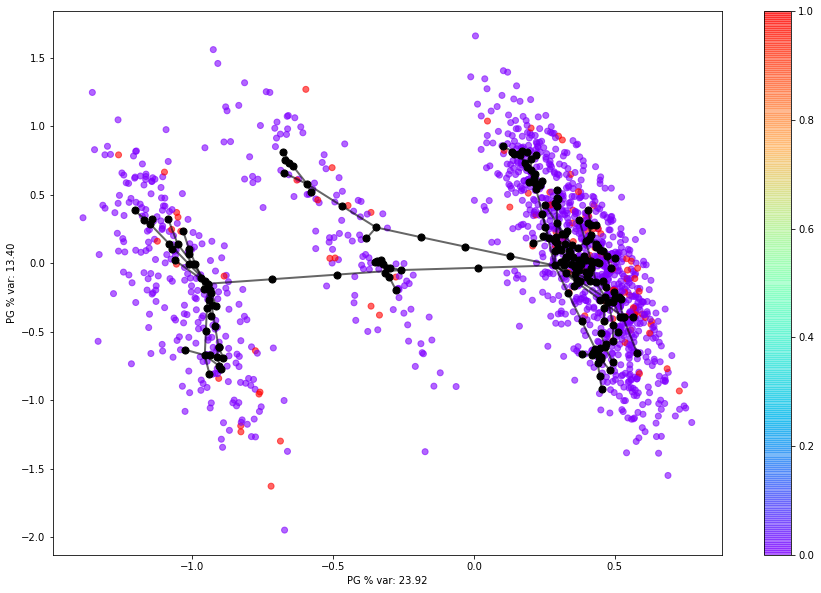

28   zab_leg_02


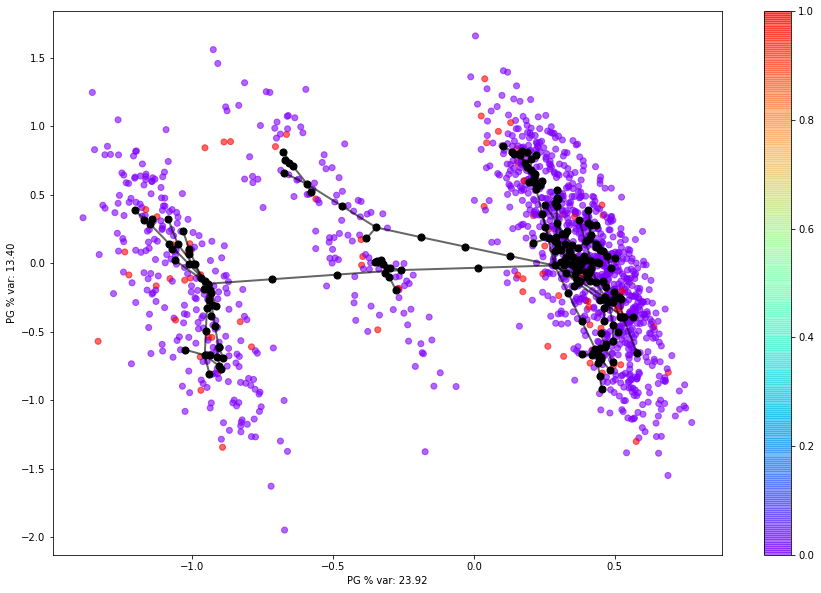

29   zab_leg_03


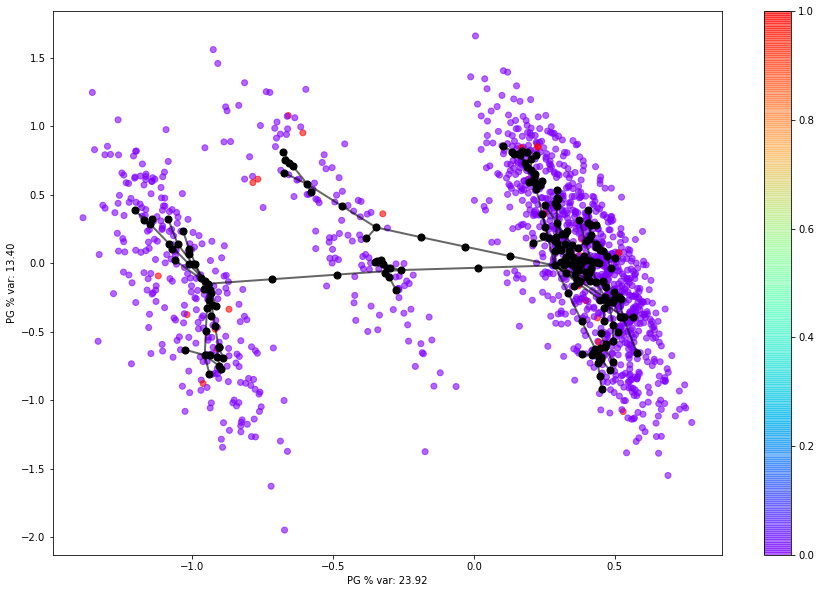

30   zab_leg_04


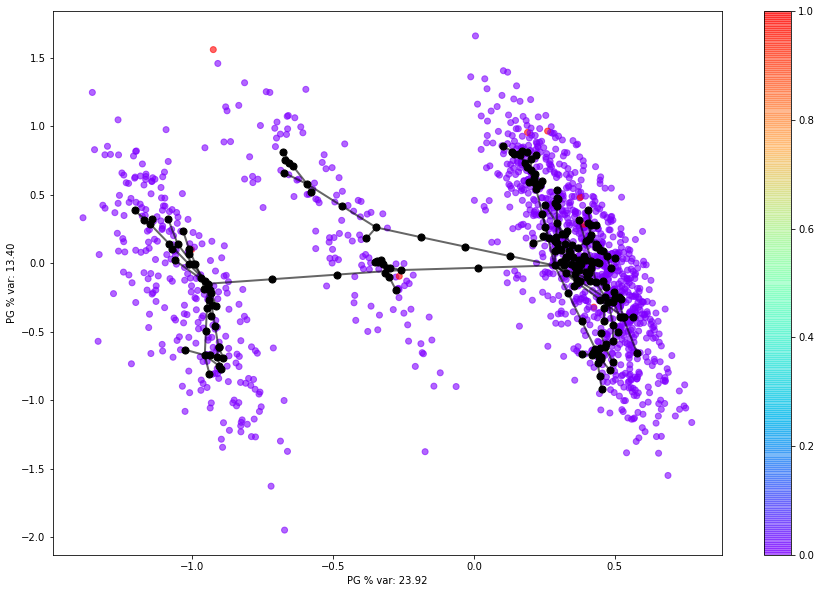

31   zab_leg_06


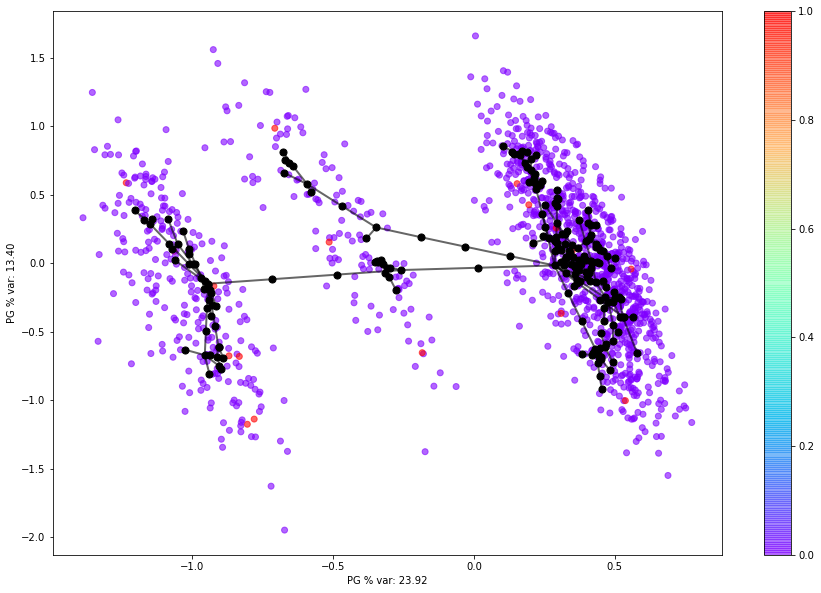

32   S_AD_ORIT


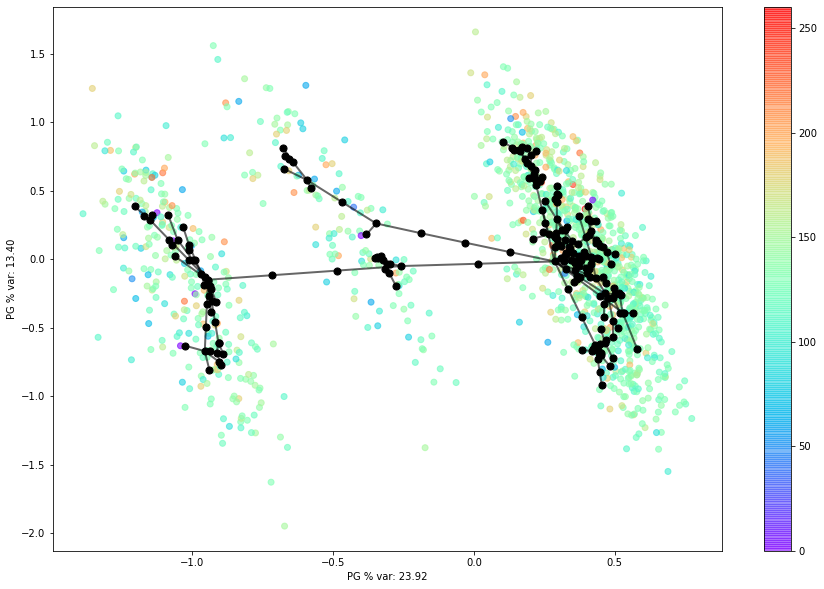

33   D_AD_ORIT


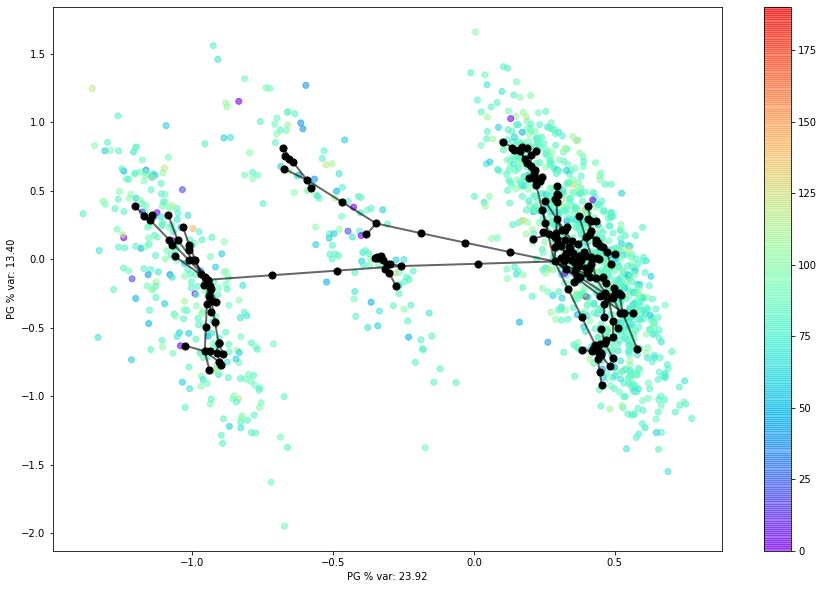

34   O_L_POST


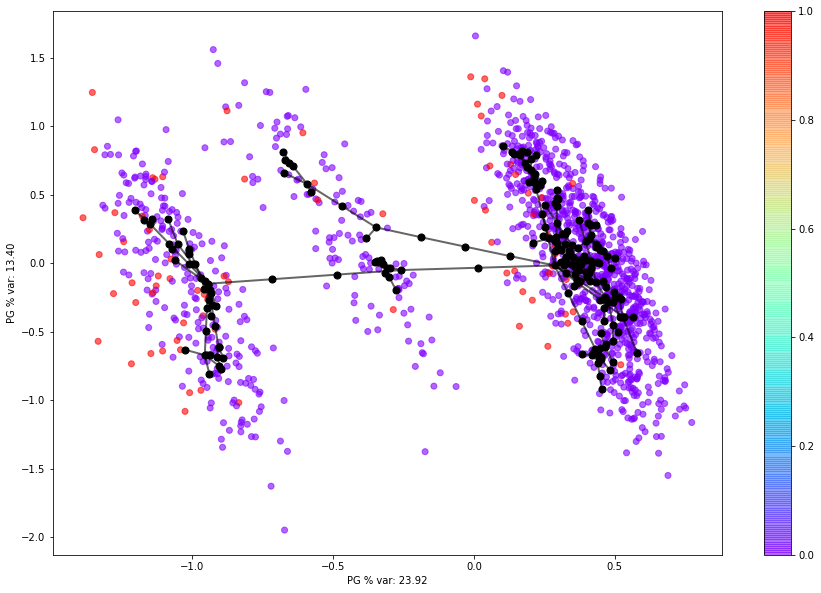

35   K_SH_POST


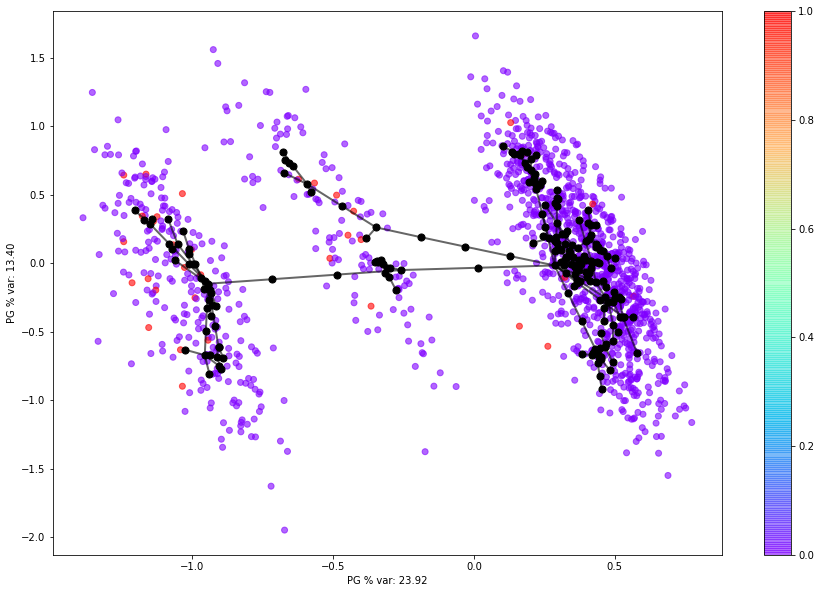

36   MP_TP_POST


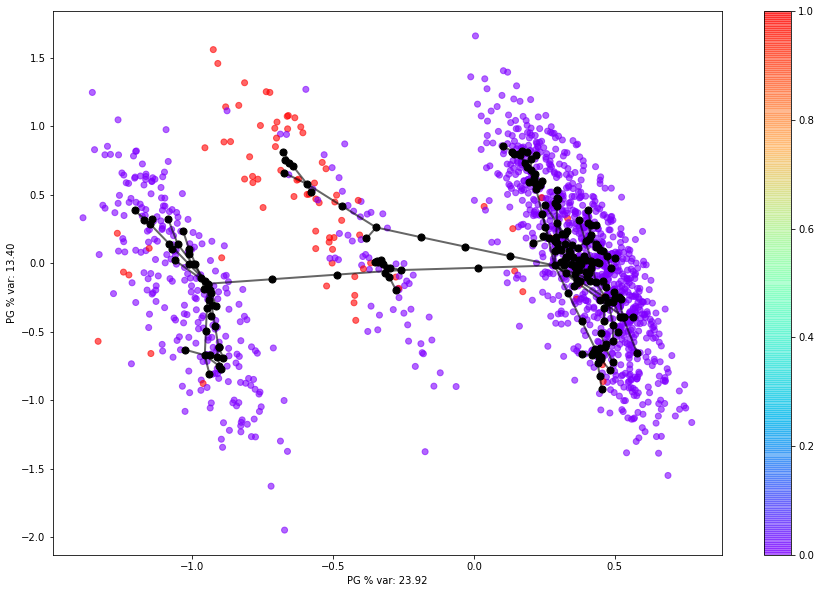

37   SVT_POST


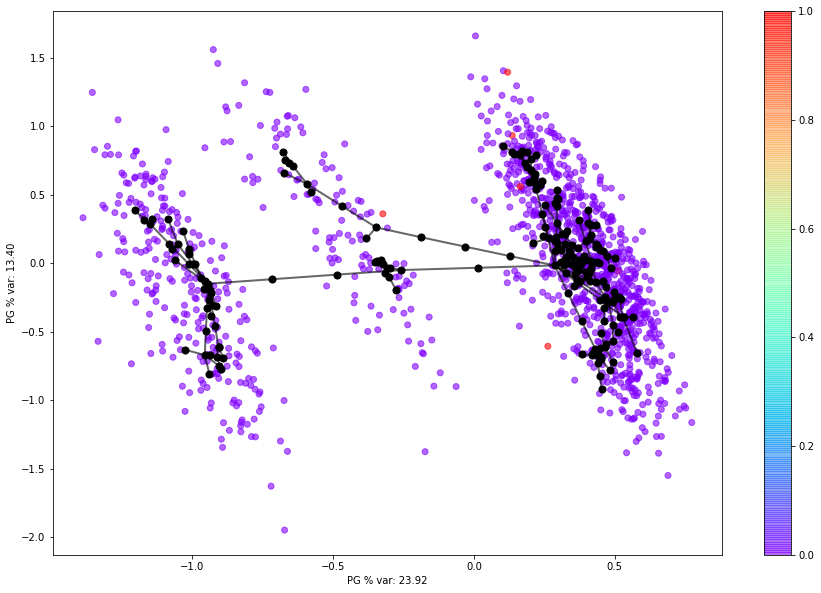

38   GT_POST


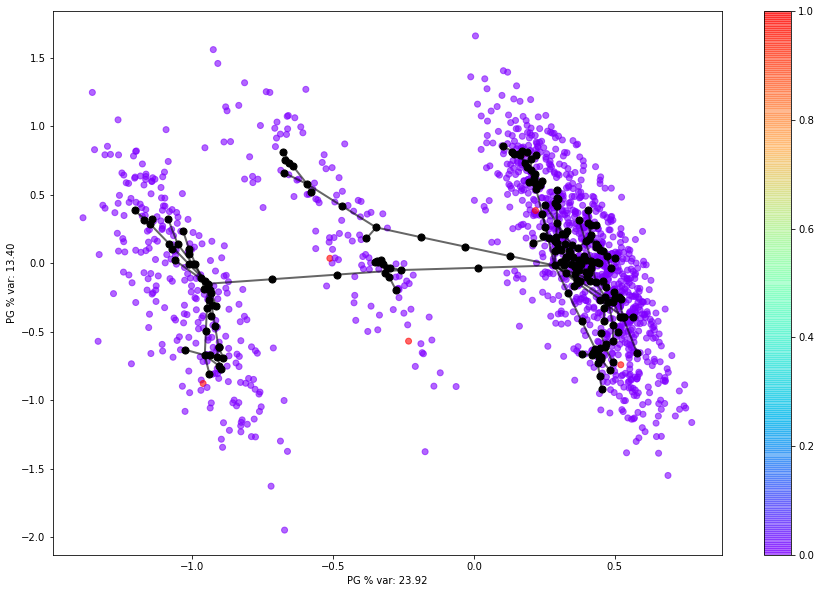

39   FIB_G_POST


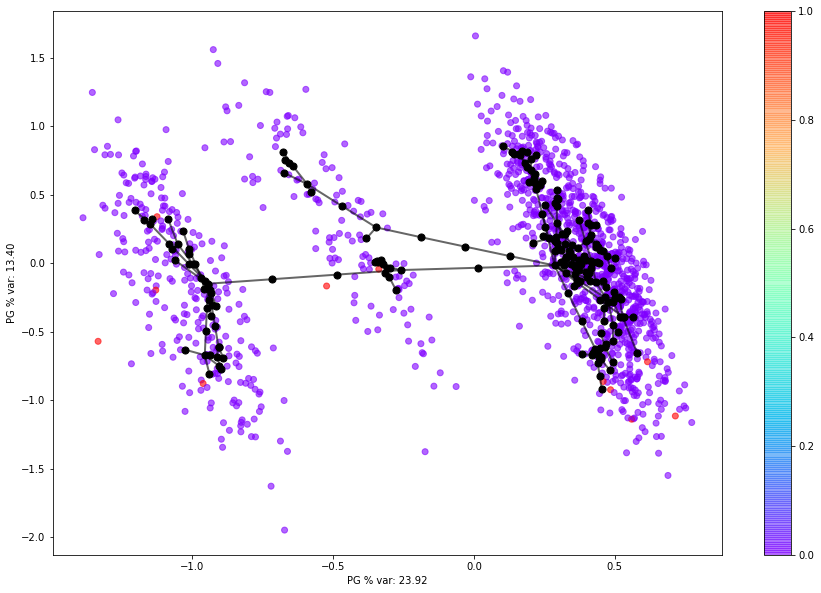

40   ant_im


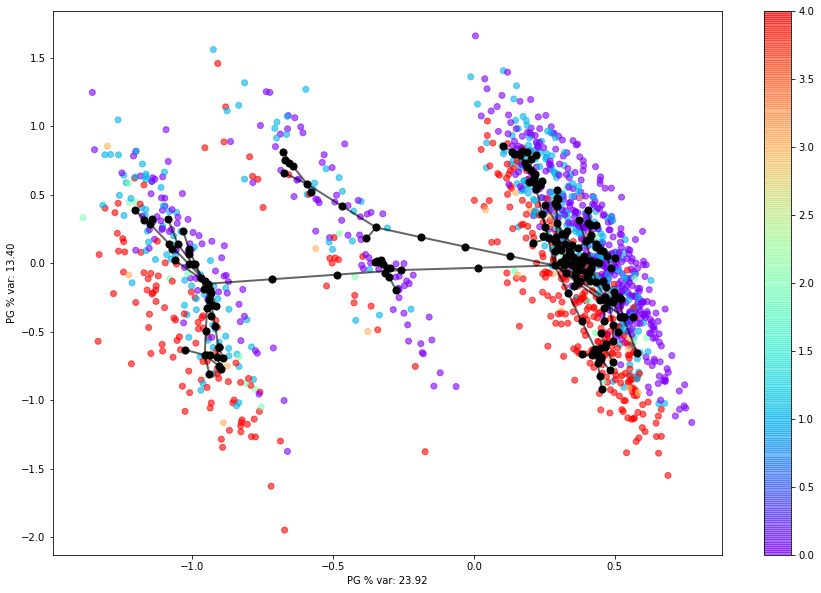

41   lat_im


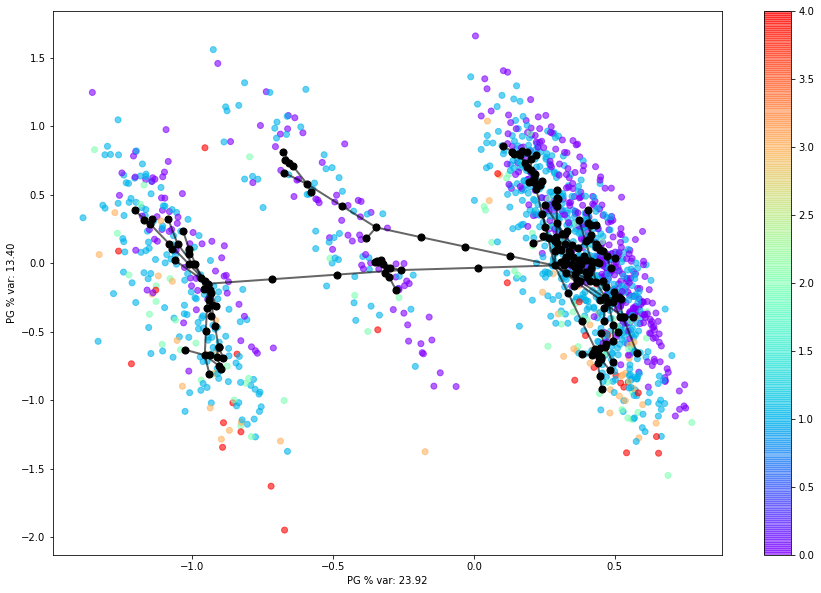

42   inf_im


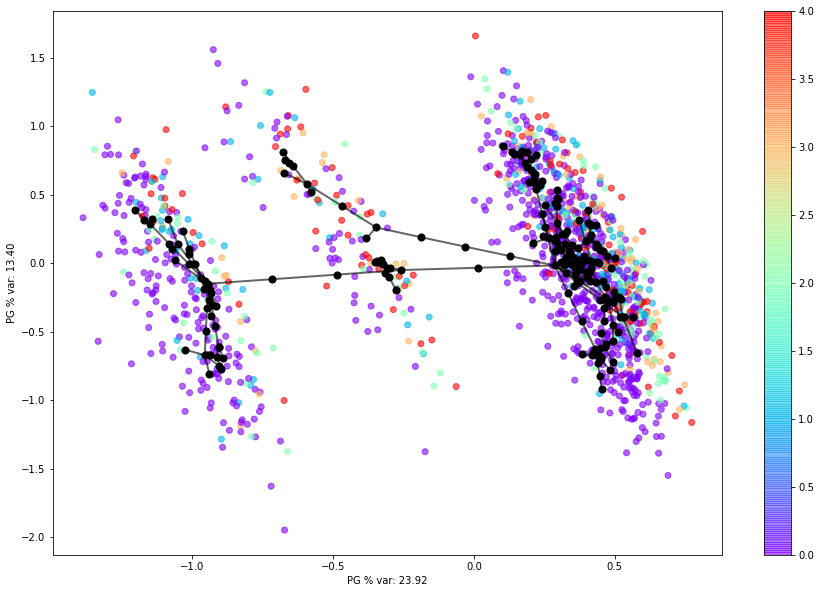

43   post_im


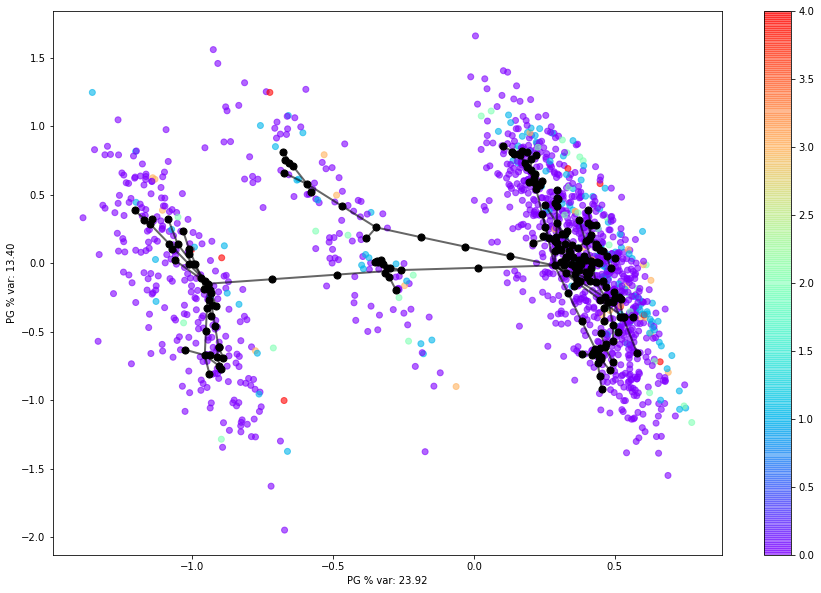

44   IM_PG_P


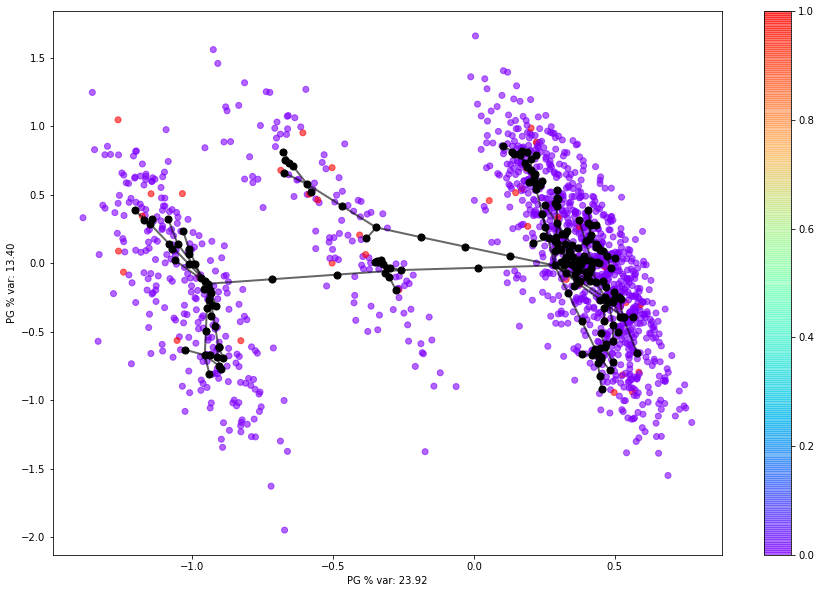

45   ritm_ecg_p_01


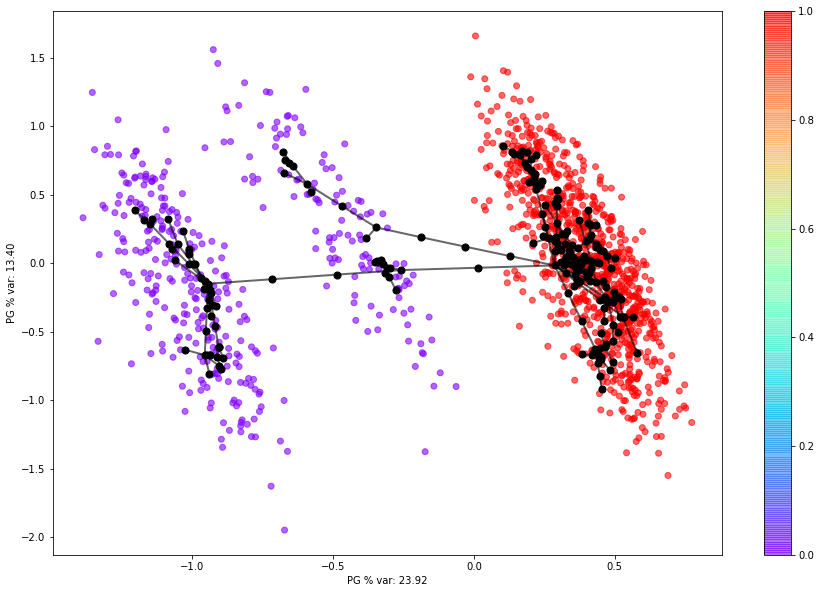

46   ritm_ecg_p_02


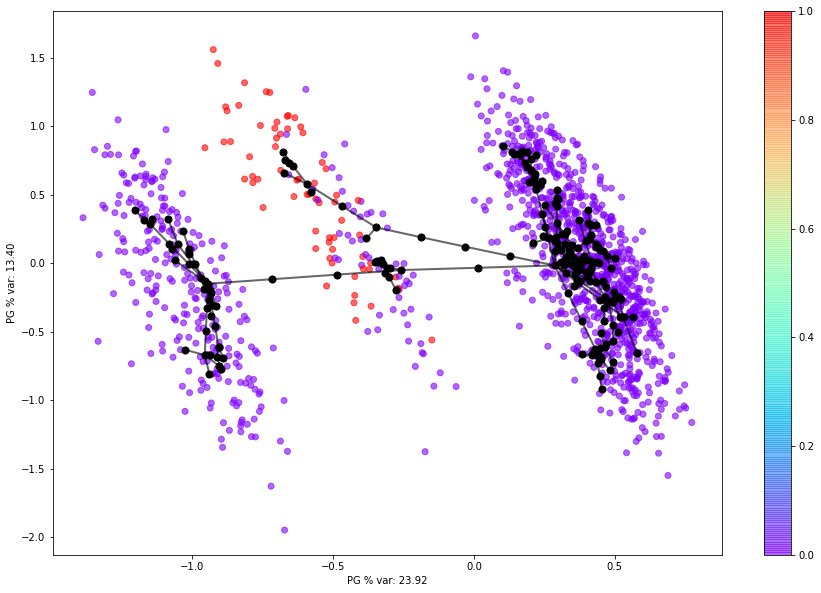

47   ritm_ecg_p_04


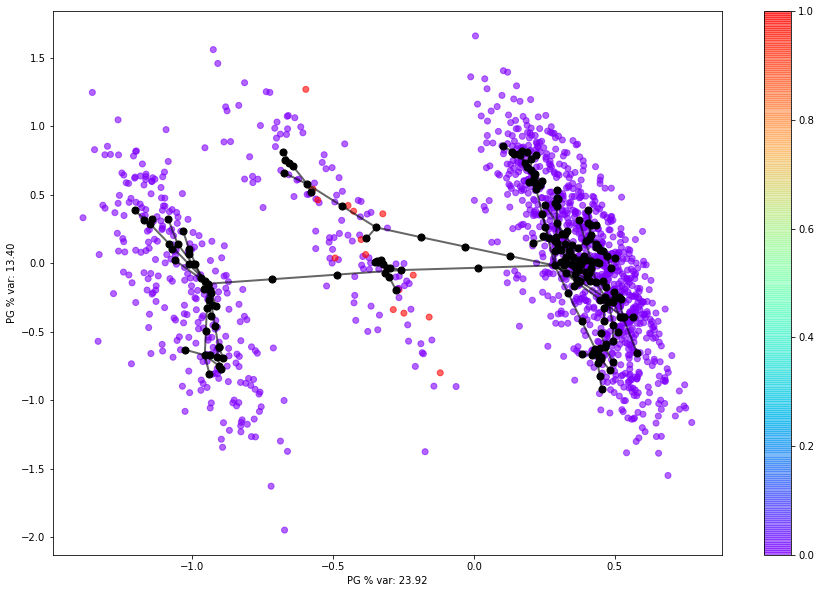

48   ritm_ecg_p_06


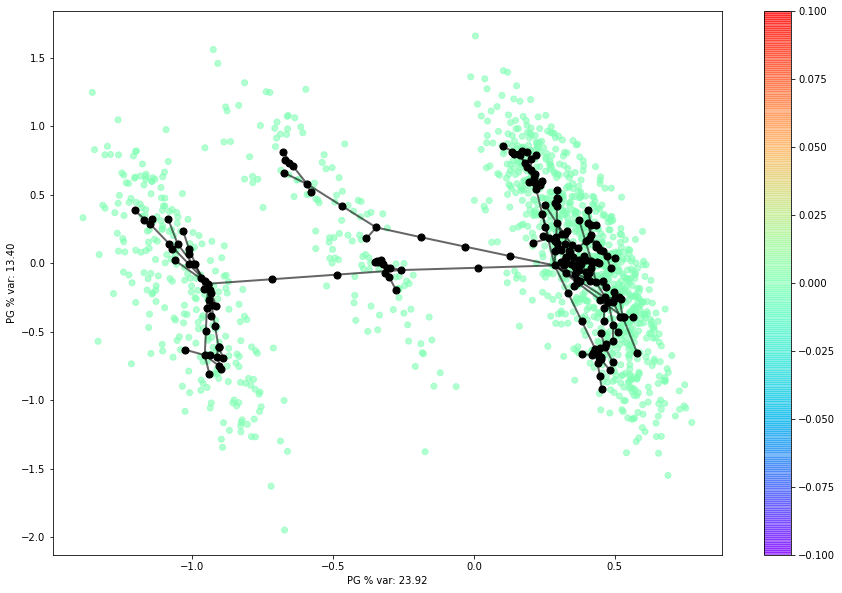

49   ritm_ecg_p_07


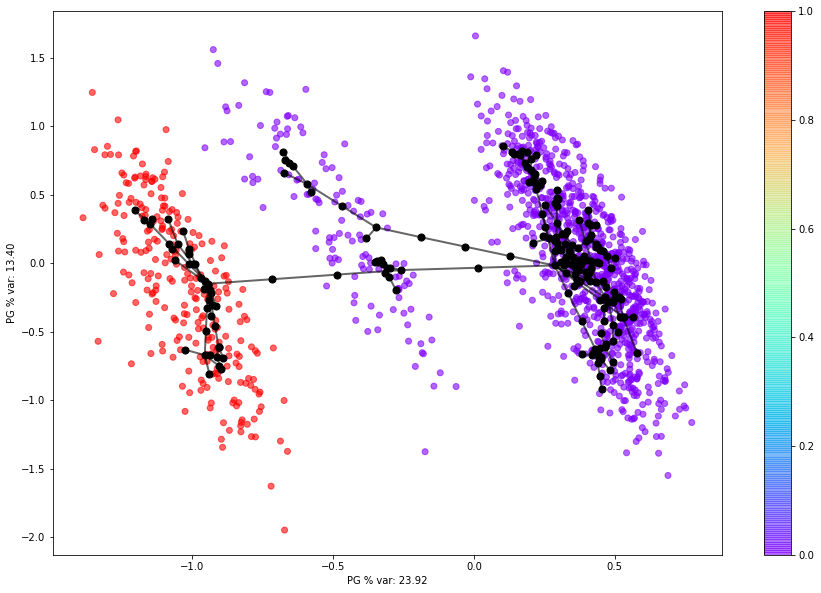

50   ritm_ecg_p_08


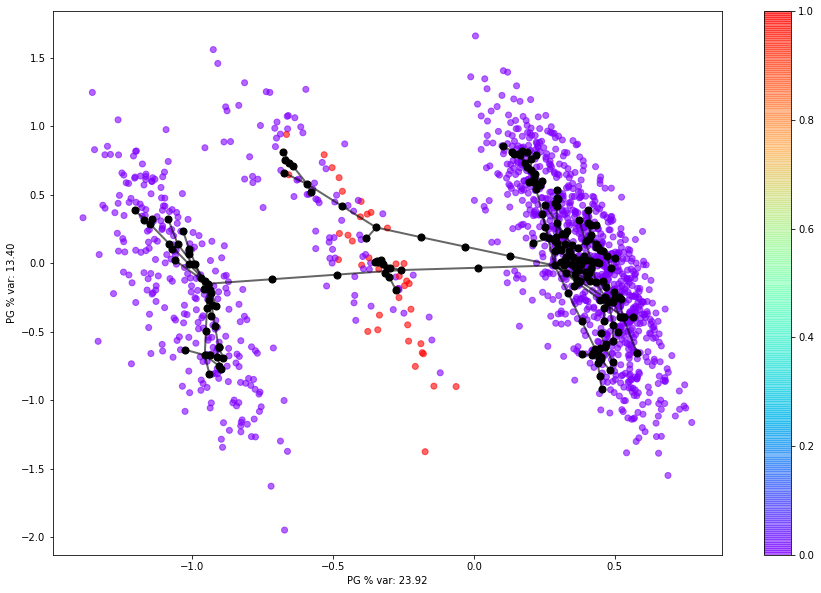

51   n_r_ecg_p_01


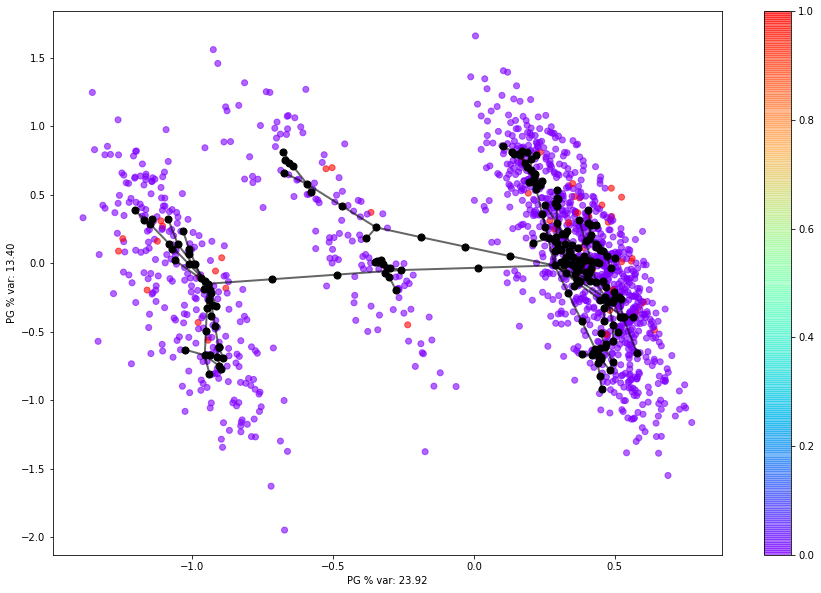

52   n_r_ecg_p_02


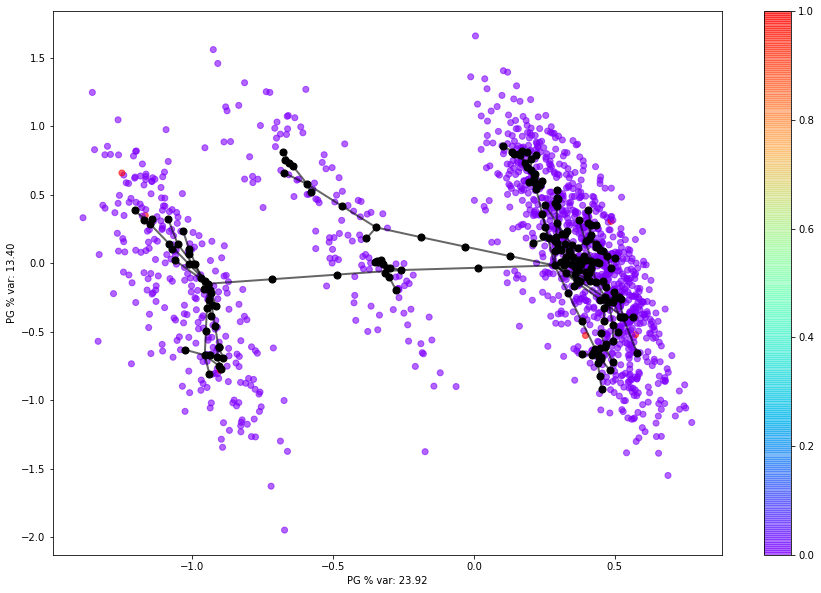

53   n_r_ecg_p_03


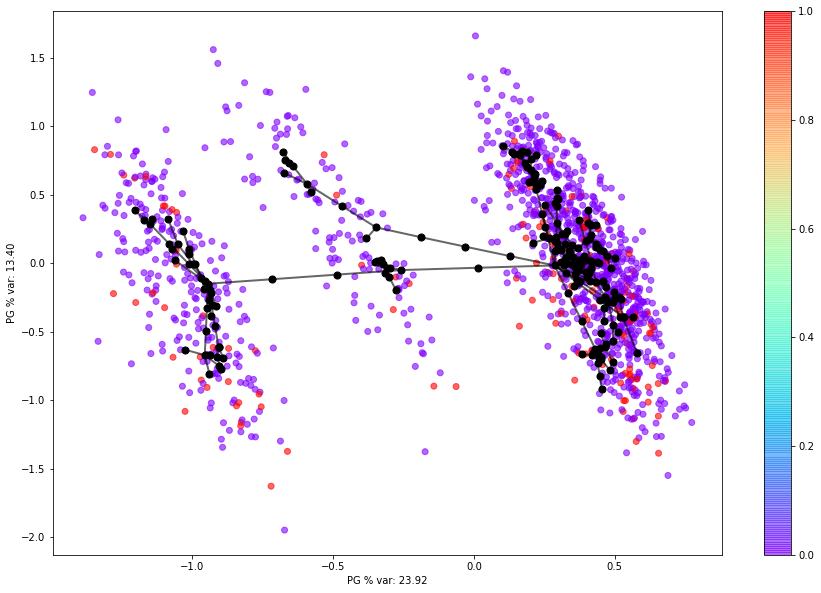

54   n_r_ecg_p_04


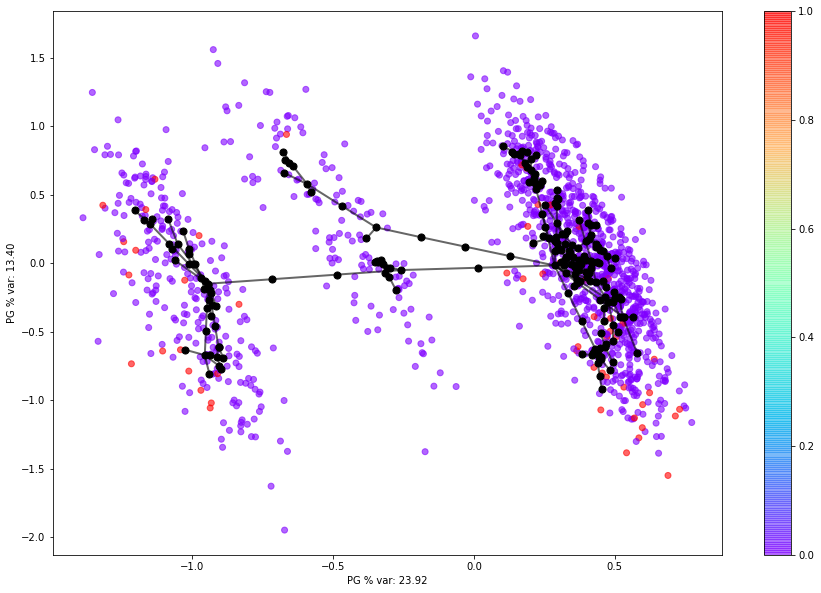

55   n_r_ecg_p_05


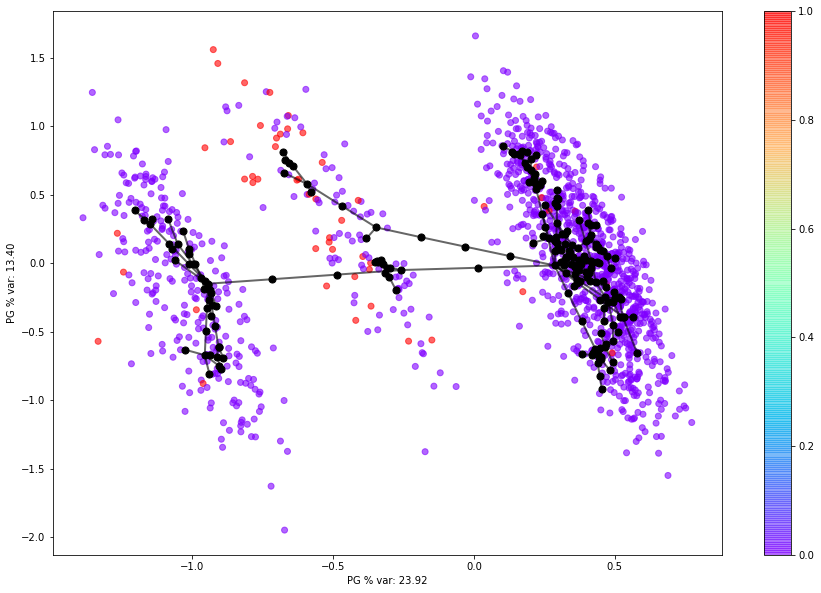

56   n_r_ecg_p_06


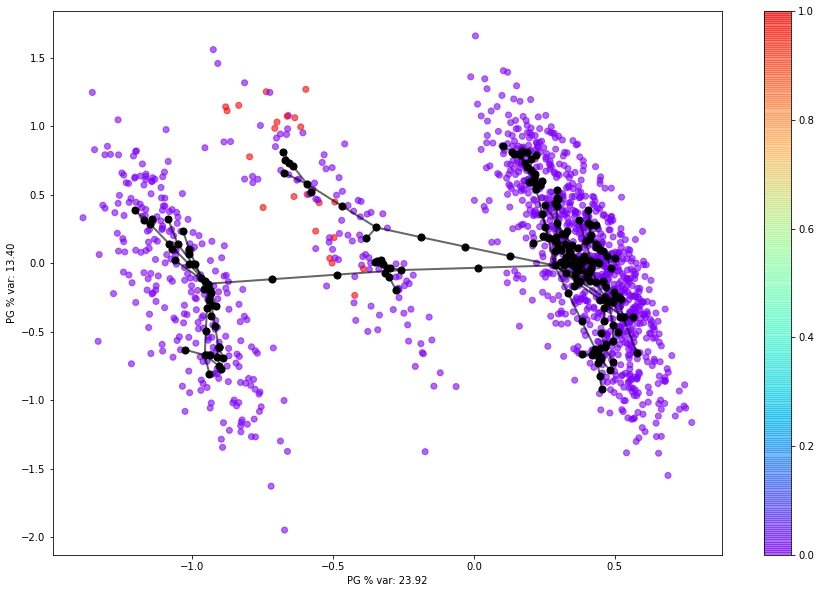

57   n_r_ecg_p_08


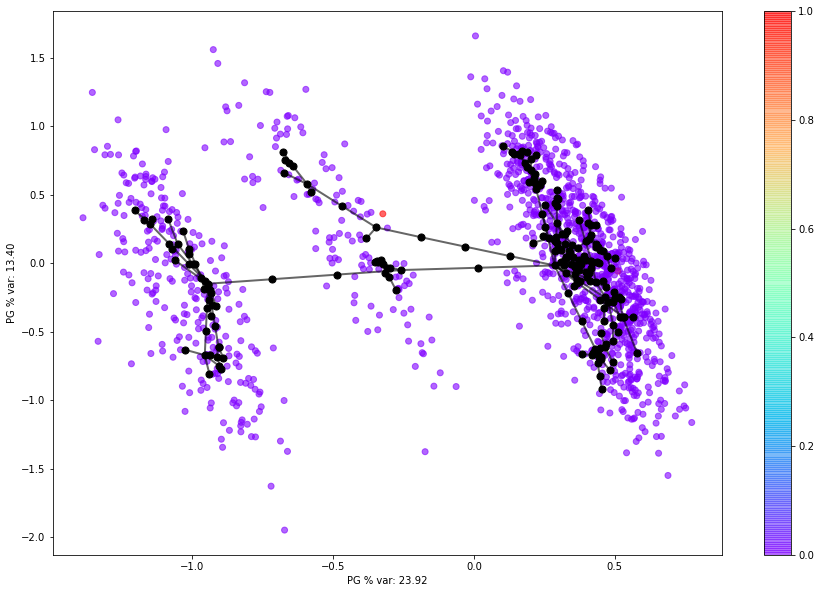

58   n_r_ecg_p_09


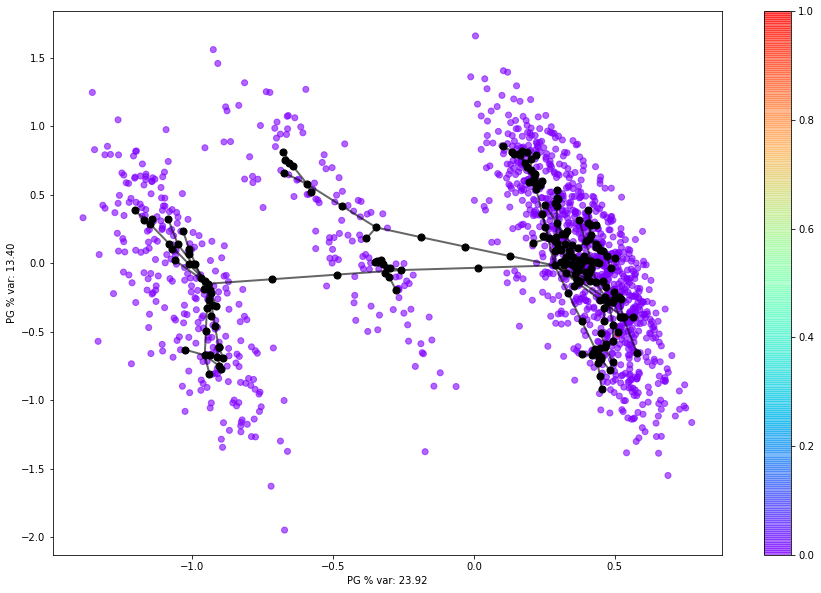

59   n_r_ecg_p_10


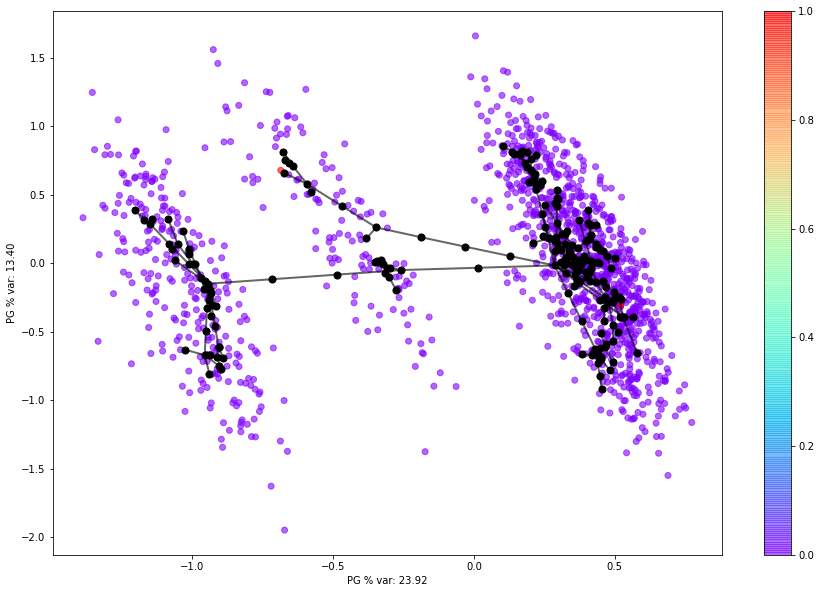

60   n_p_ecg_p_01


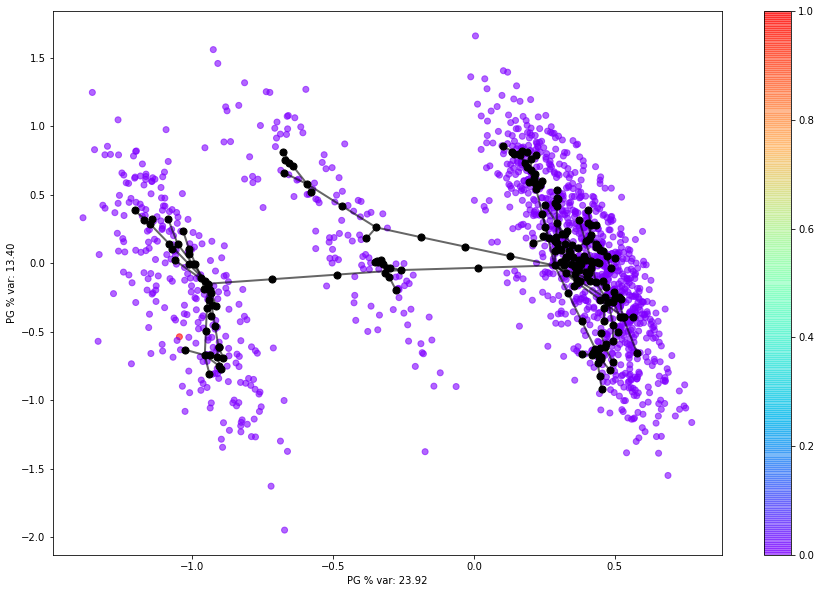

61   n_p_ecg_p_03


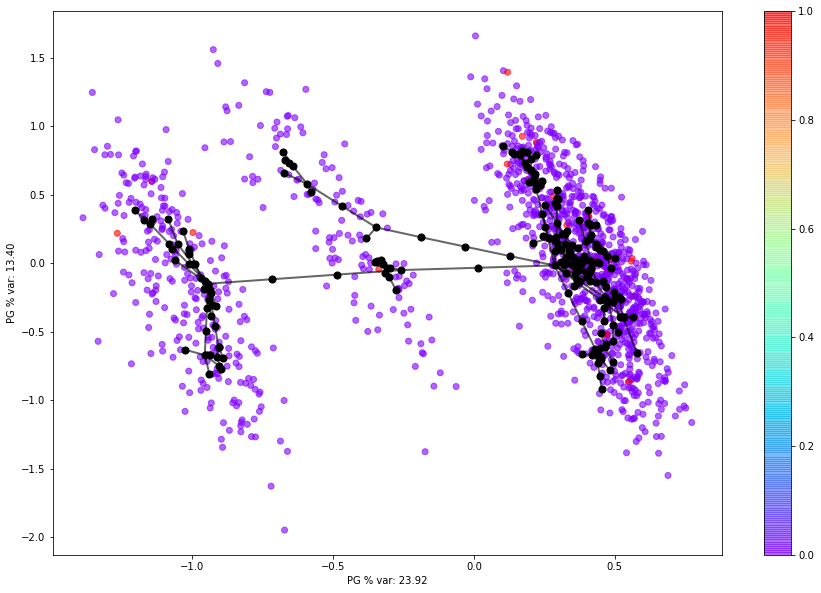

62   n_p_ecg_p_04


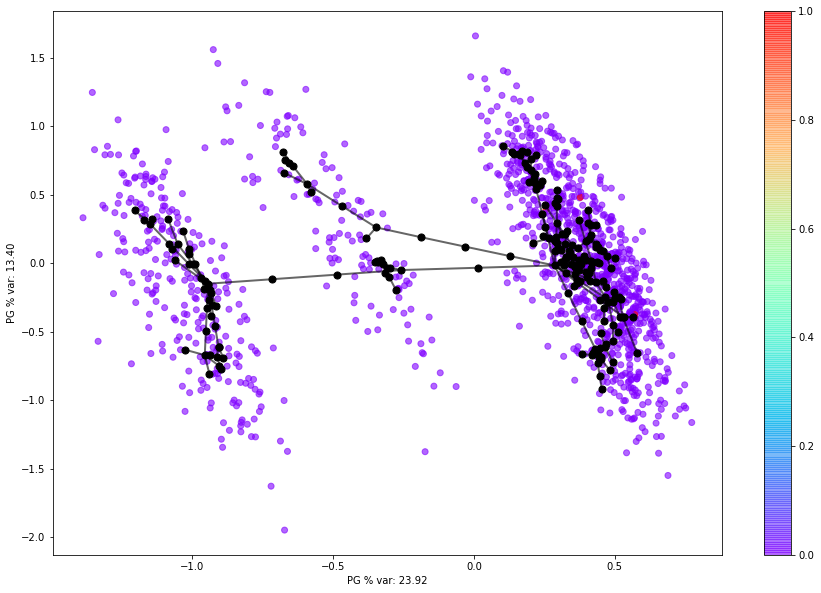

63   n_p_ecg_p_05


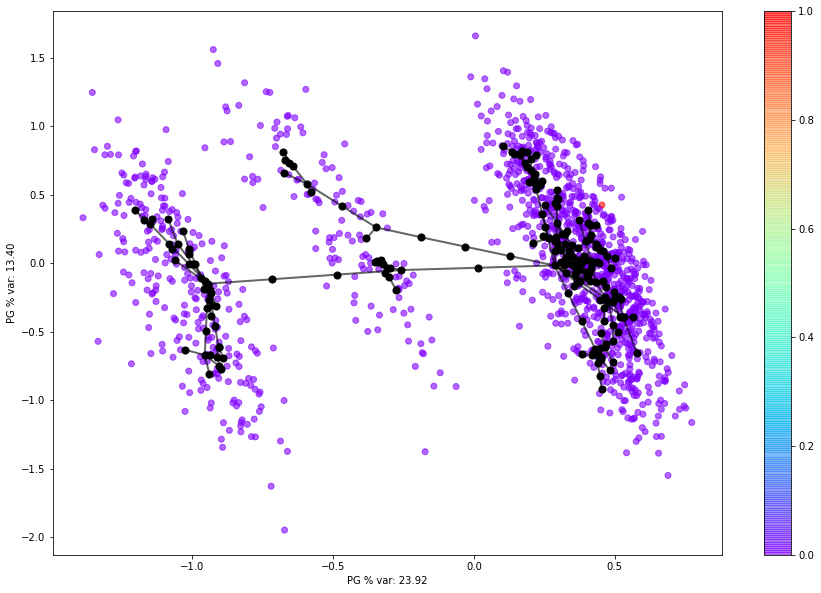

64   n_p_ecg_p_06


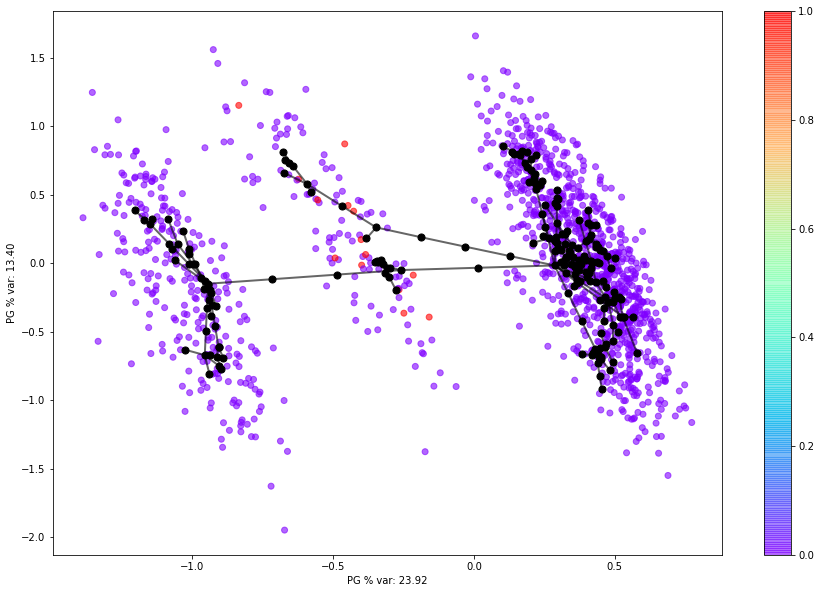

65   n_p_ecg_p_07


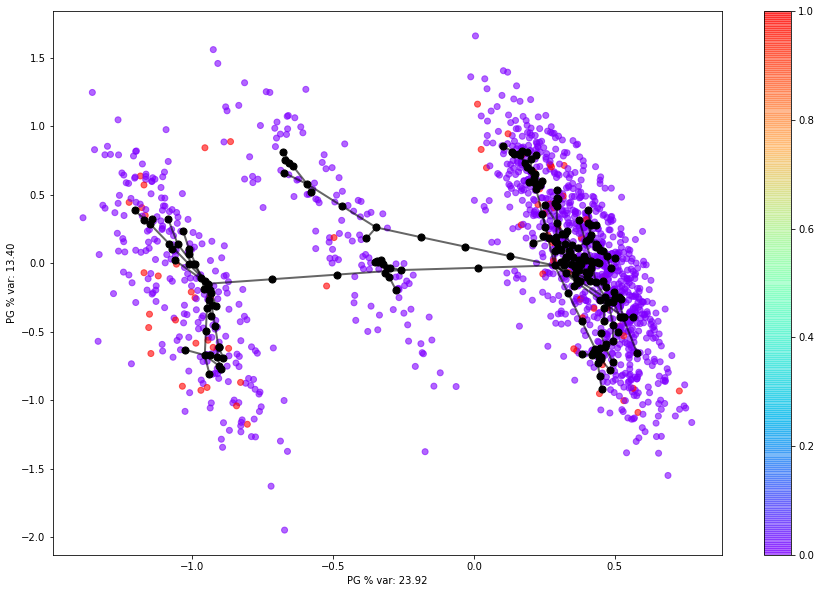

66   n_p_ecg_p_08


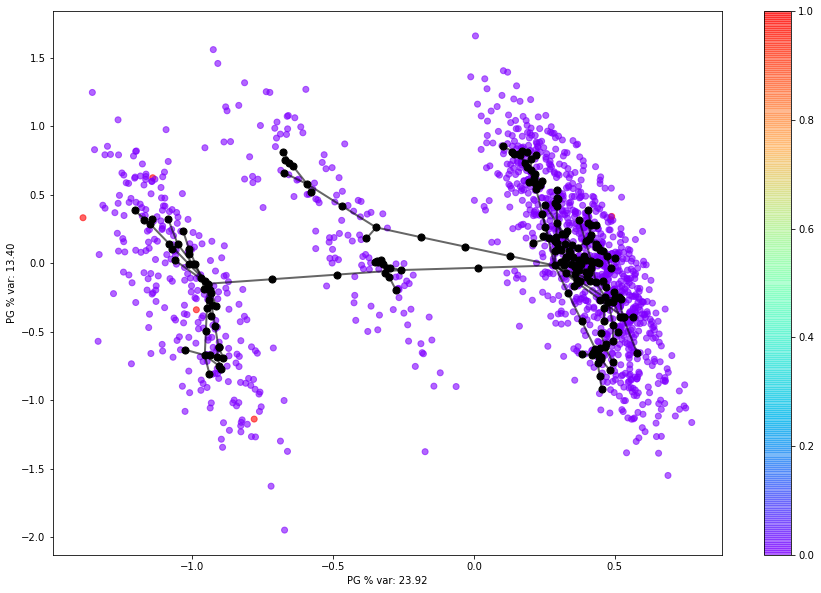

67   n_p_ecg_p_09


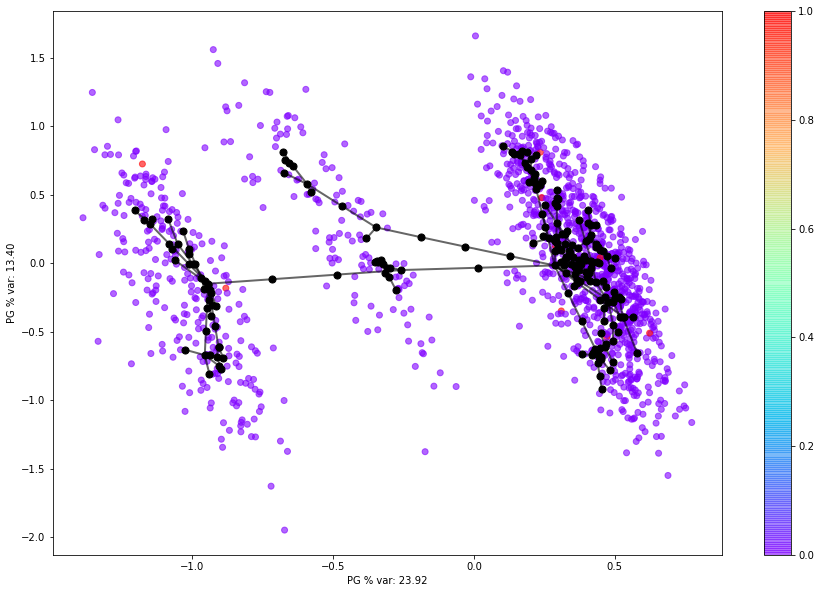

68   n_p_ecg_p_10


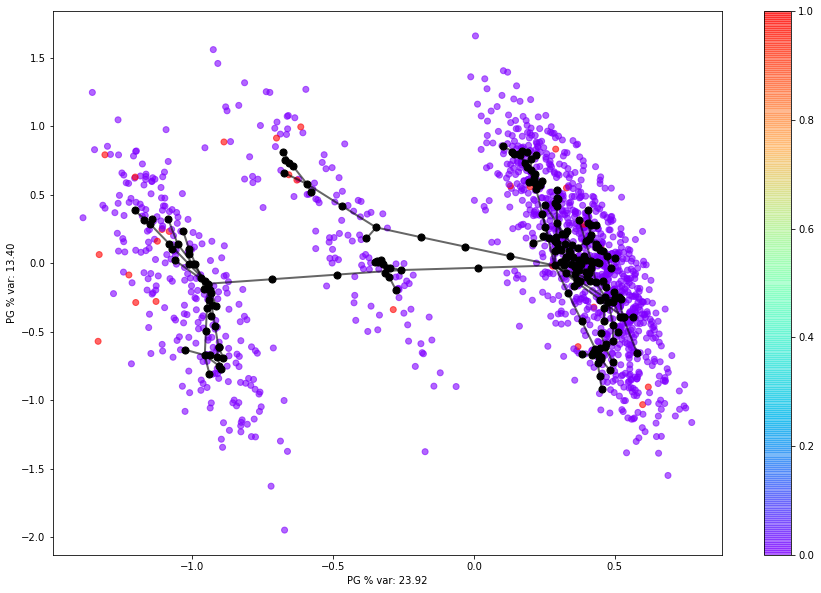

69   n_p_ecg_p_11


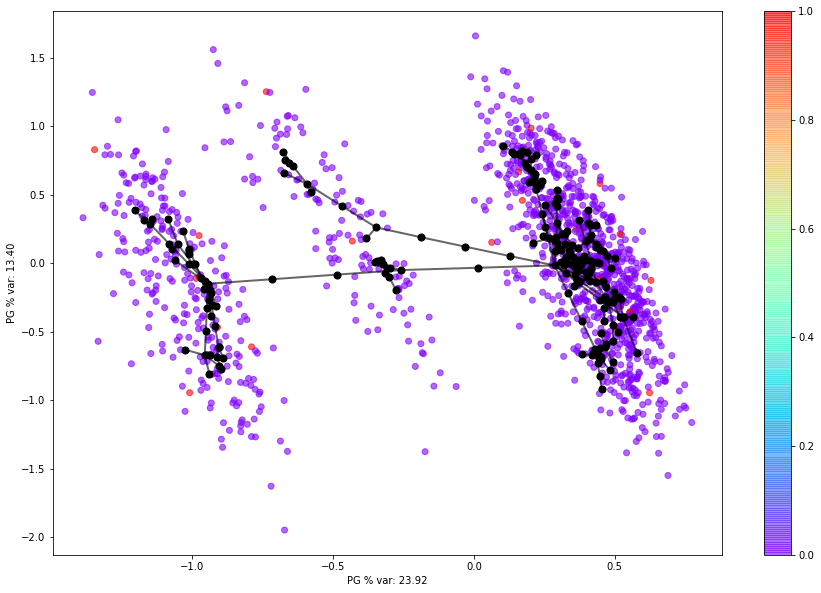

70   n_p_ecg_p_12


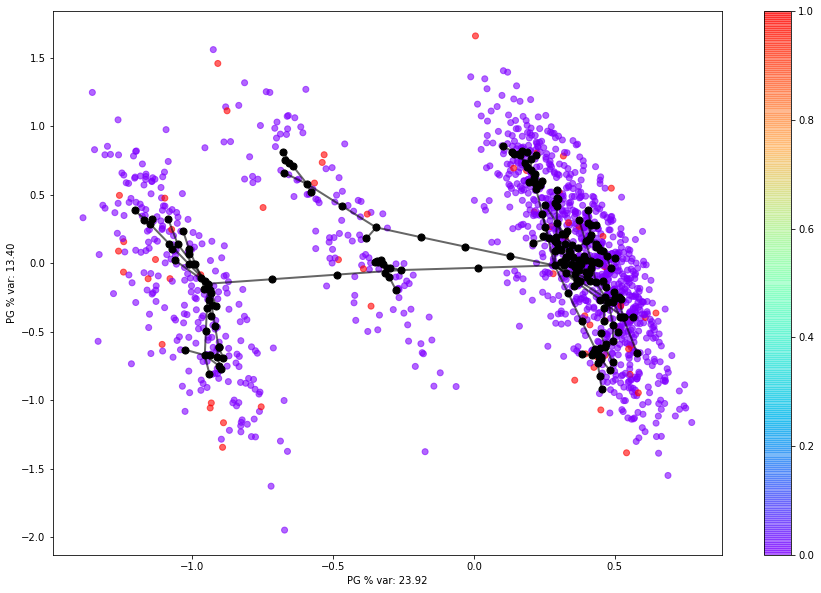

71   fibr_ter_01


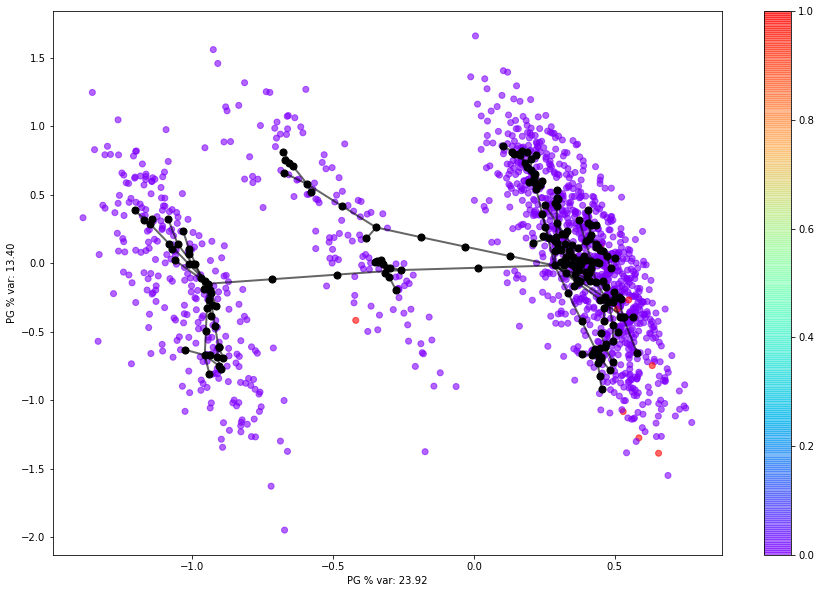

72   fibr_ter_02


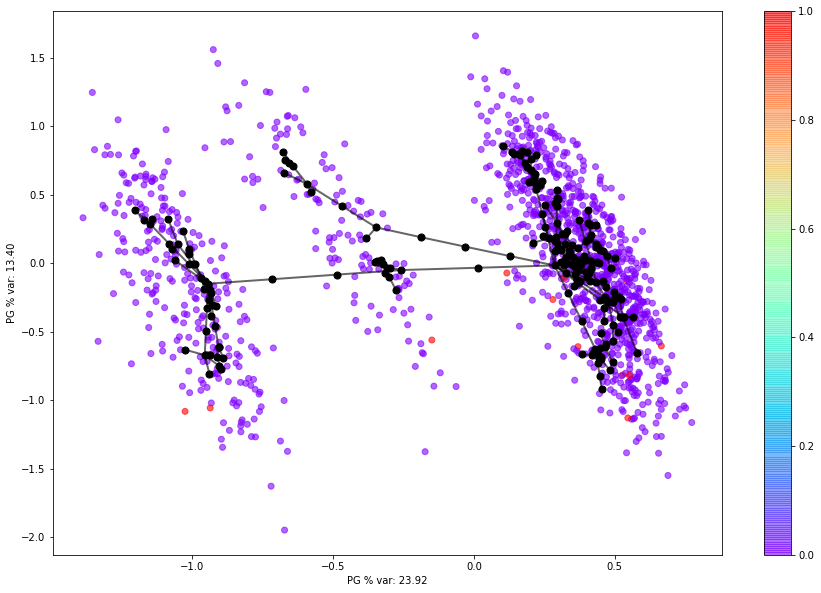

73   fibr_ter_03


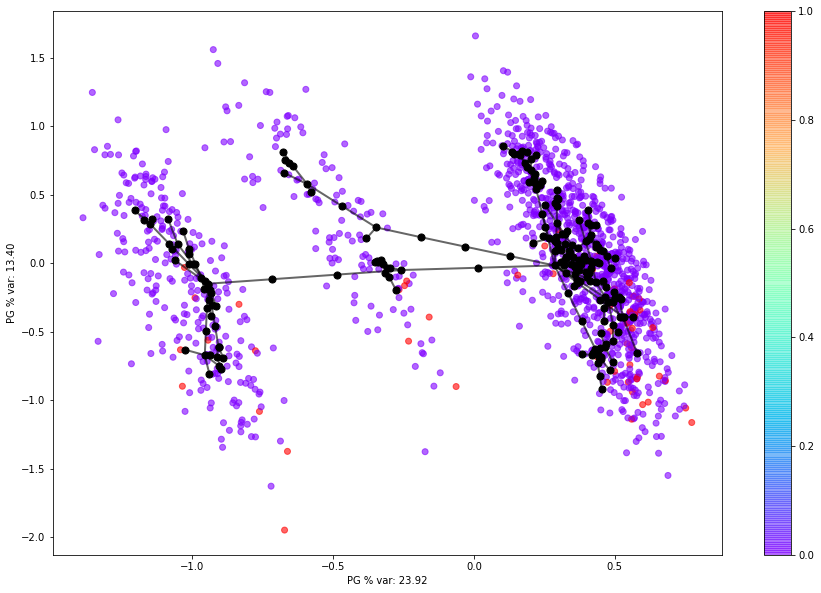

74   fibr_ter_05


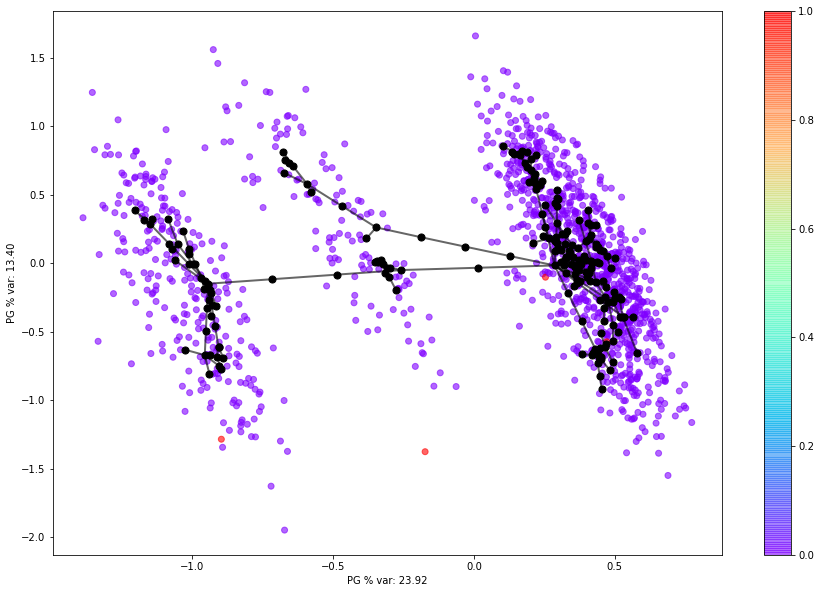

75   fibr_ter_06


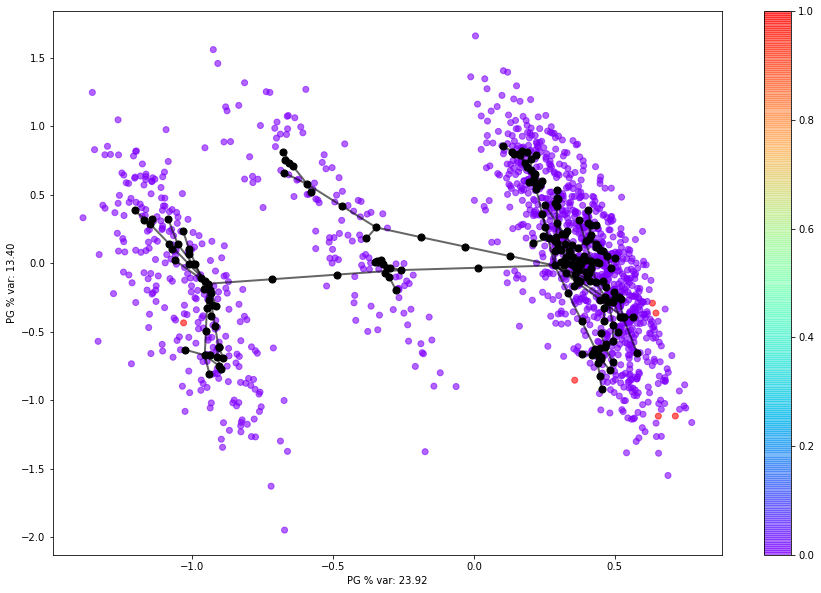

76   fibr_ter_07


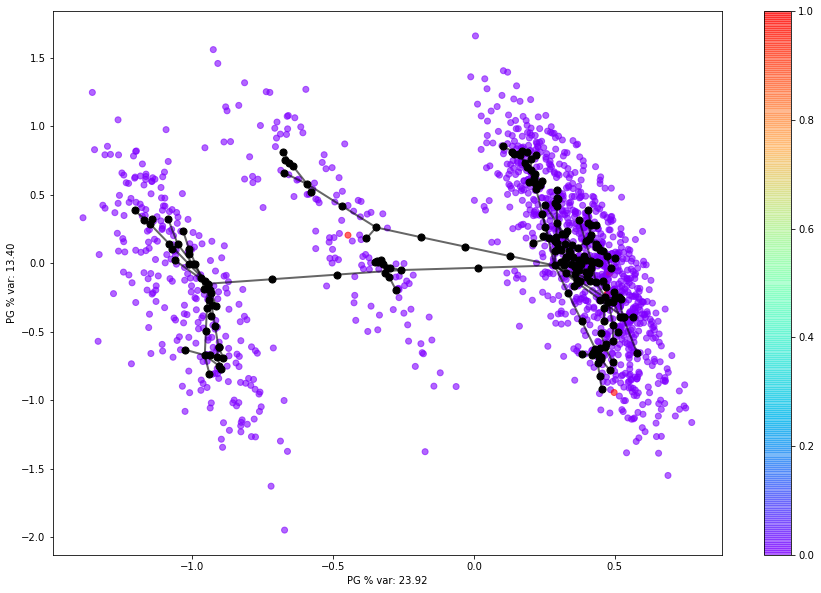

77   fibr_ter_08


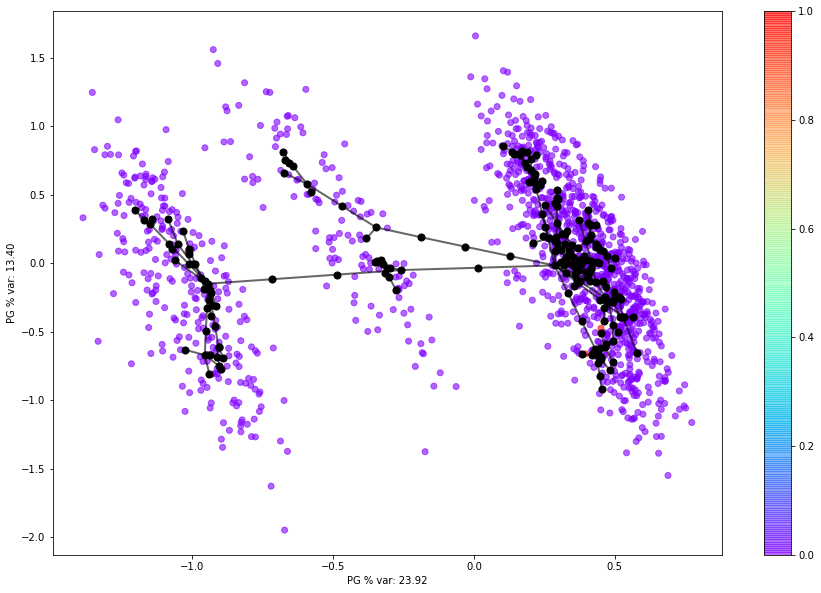

78   GIPO_K


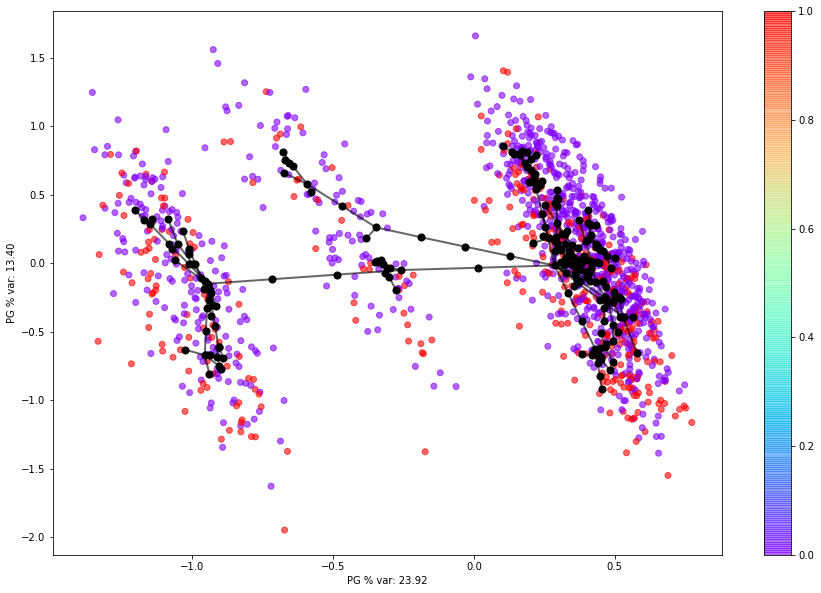

79   K_BLOOD


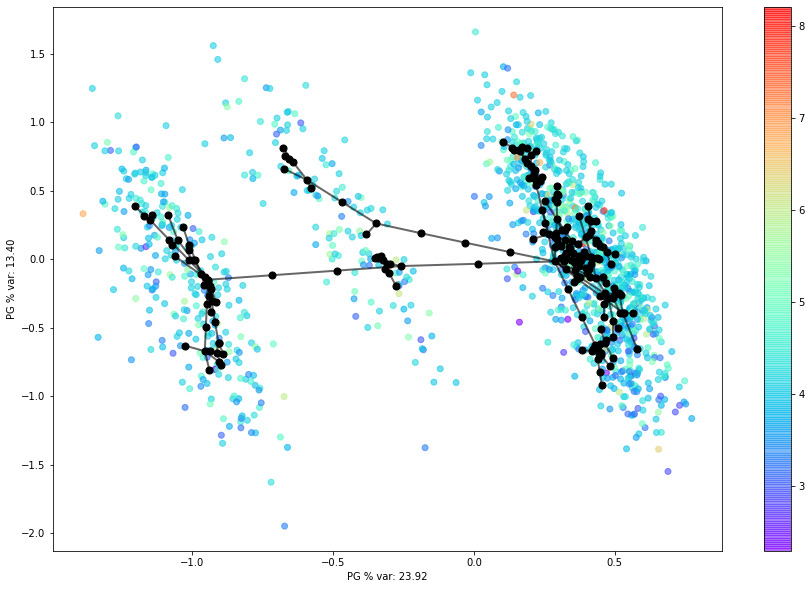

80   GIPER_NA


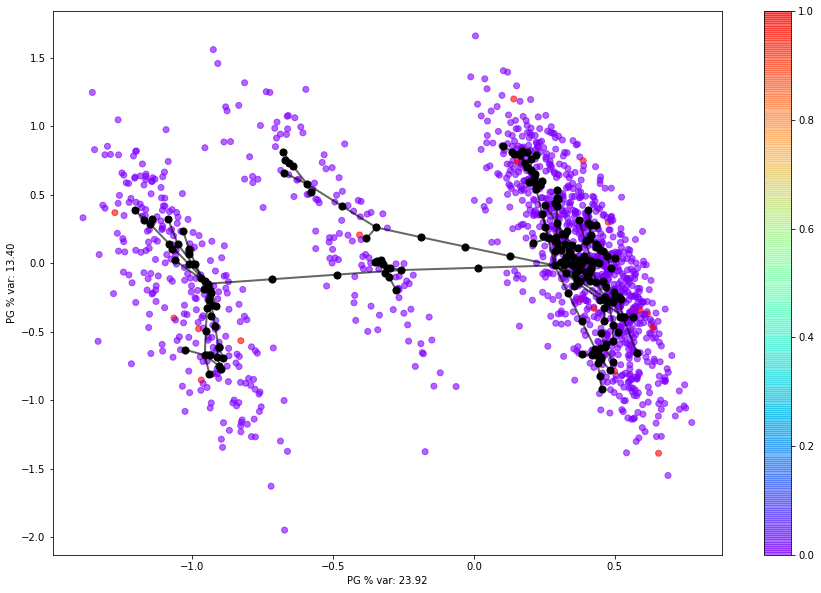

81   NA_BLOOD


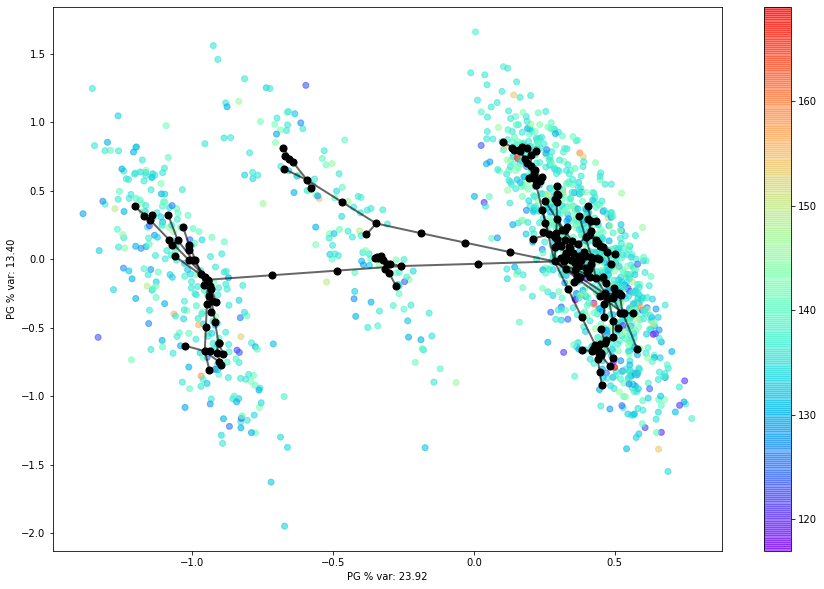

82   ALT_BLOOD


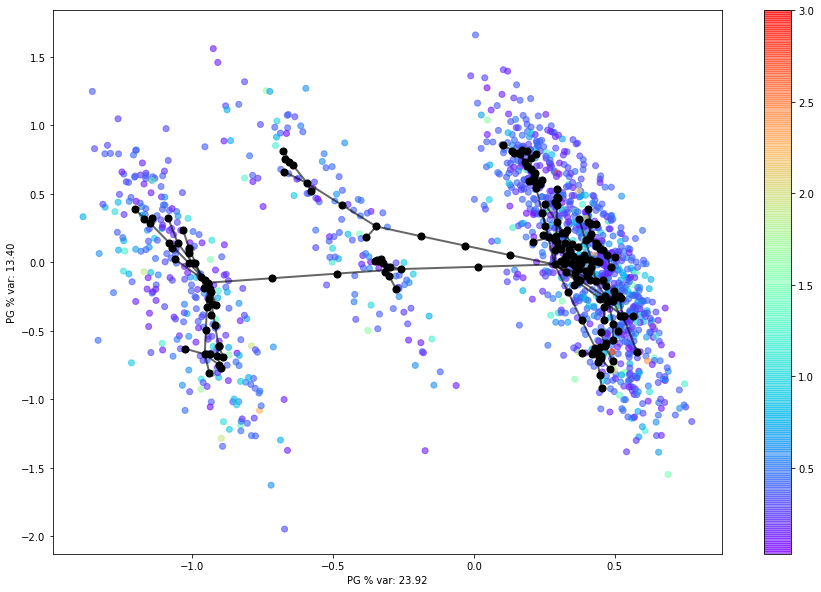

83   AST_BLOOD


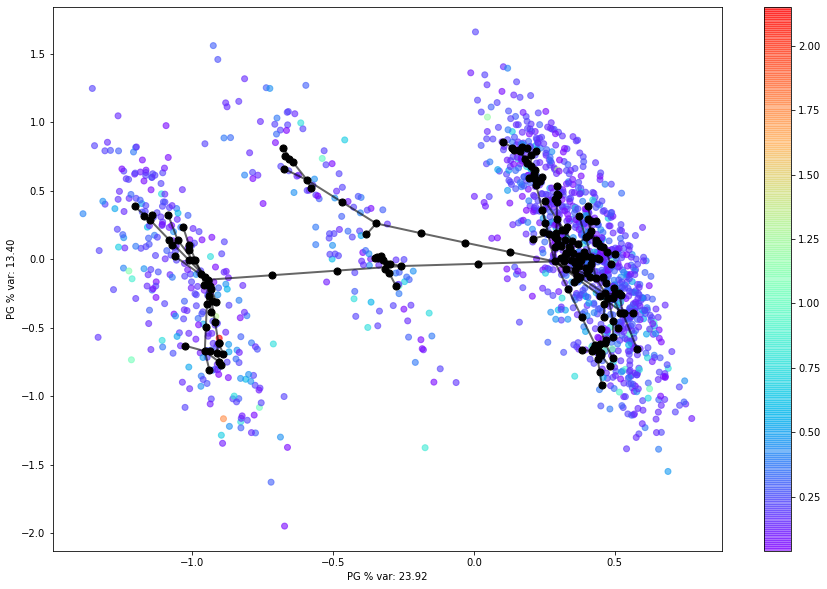

84   L_BLOOD


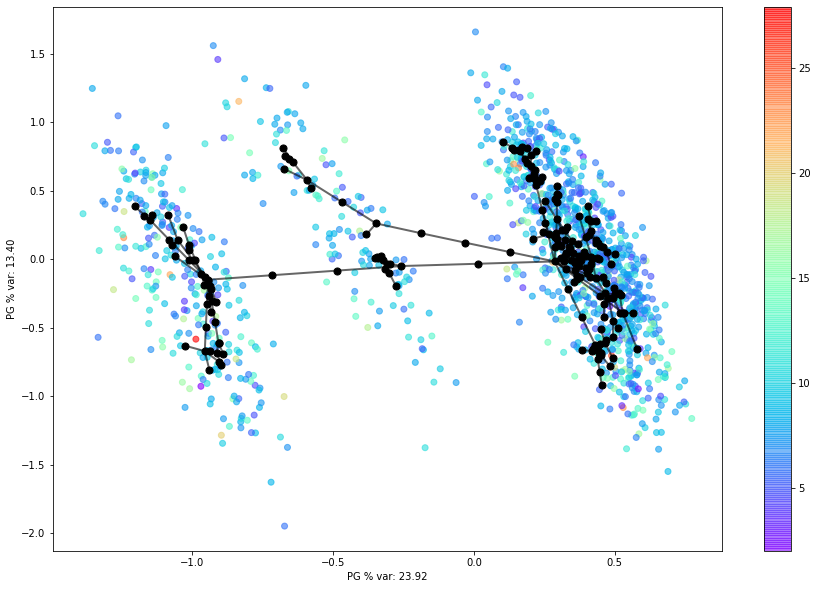

85   ROE


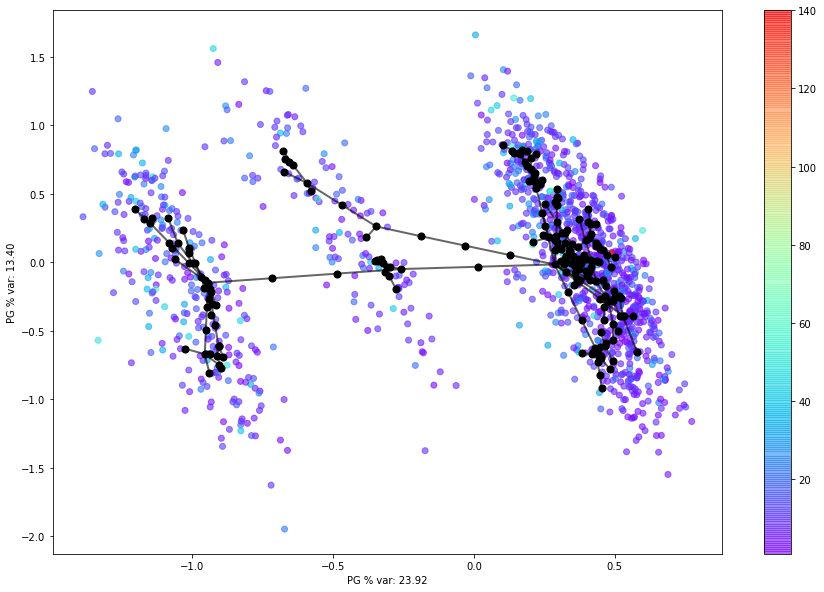

86   TIME_B_S


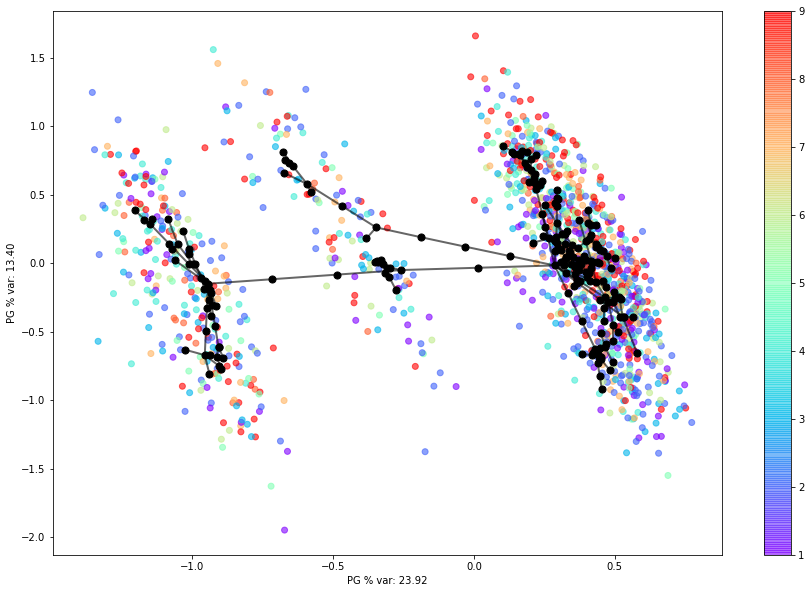

87   R_AB_1_n


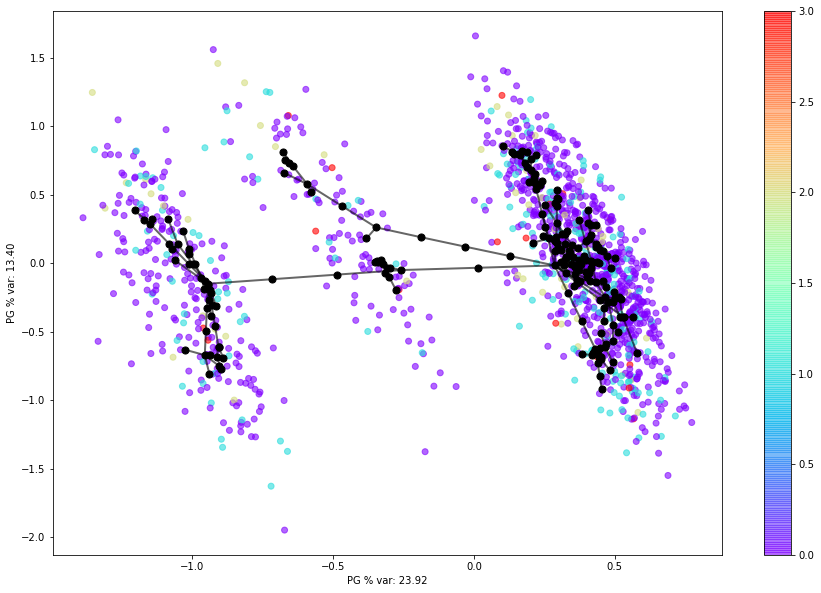

88   R_AB_2_n


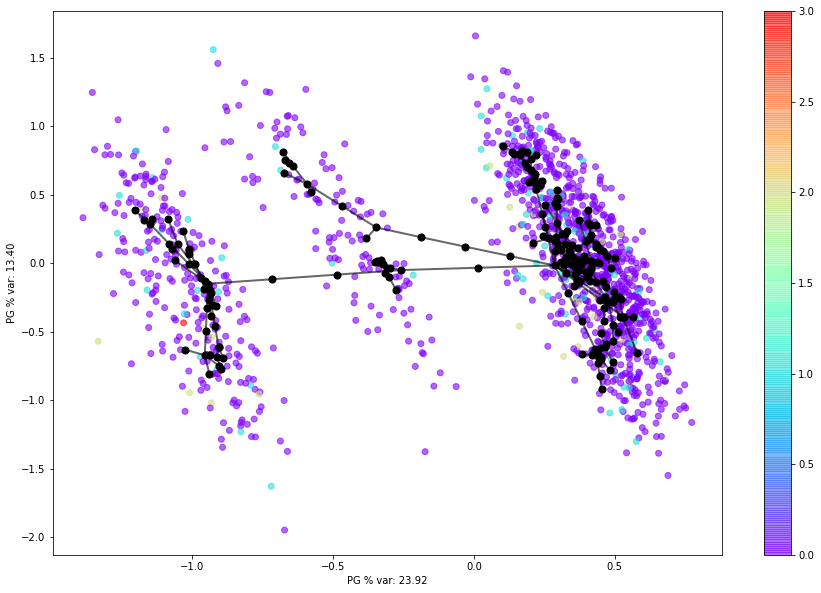

89   R_AB_3_n


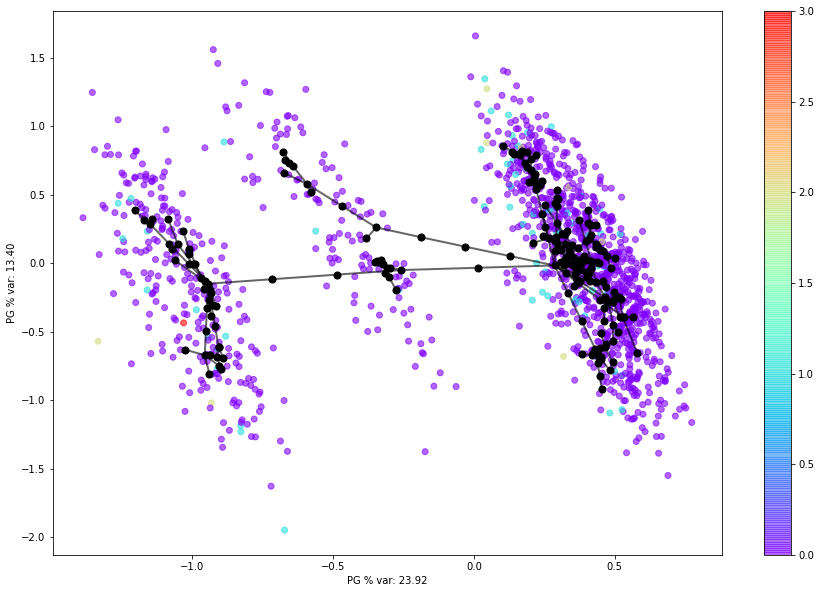

90   NA_KB


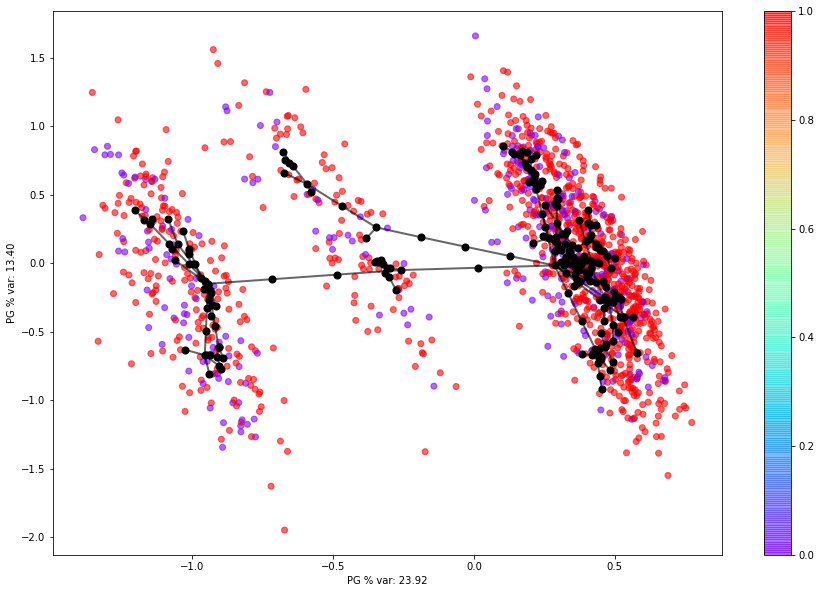

91   NOT_NA_KB


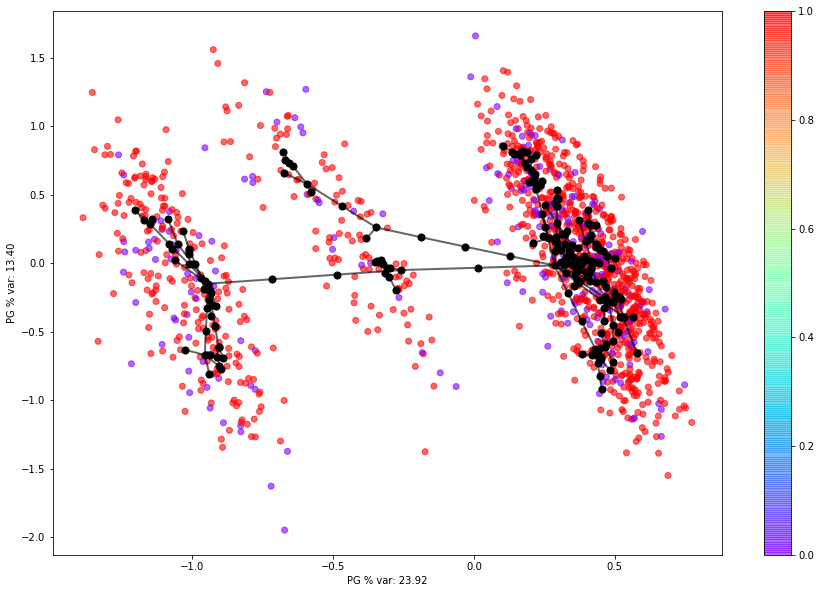

92   LID_KB


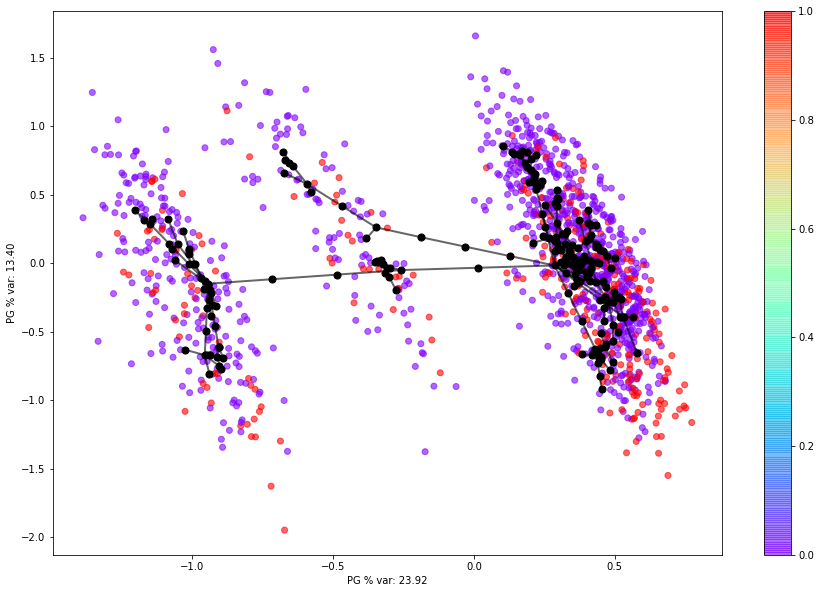

93   NITR_S


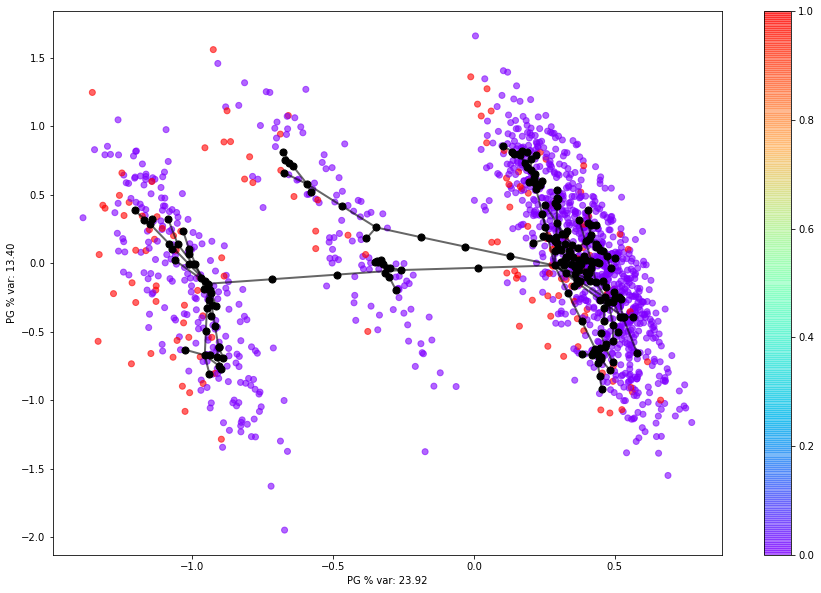

94   NA_R_1_n


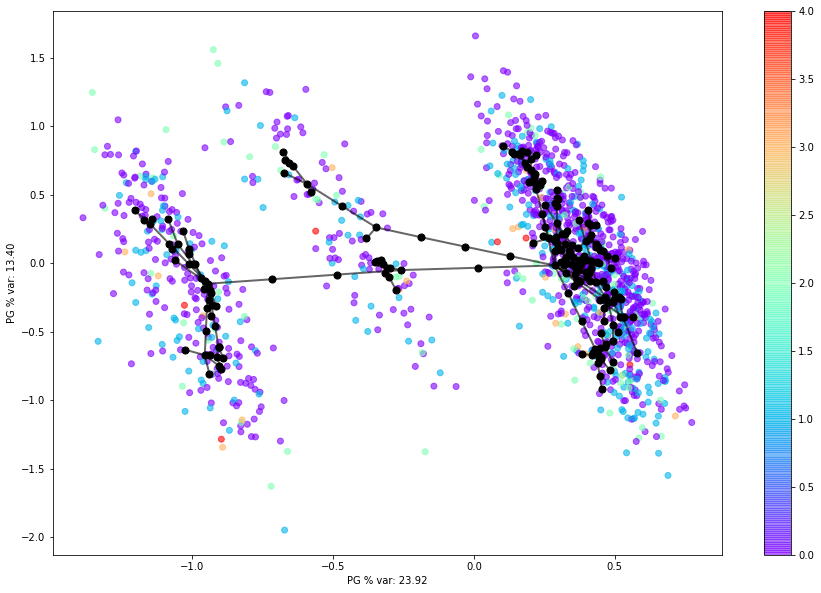

95   NA_R_2_n


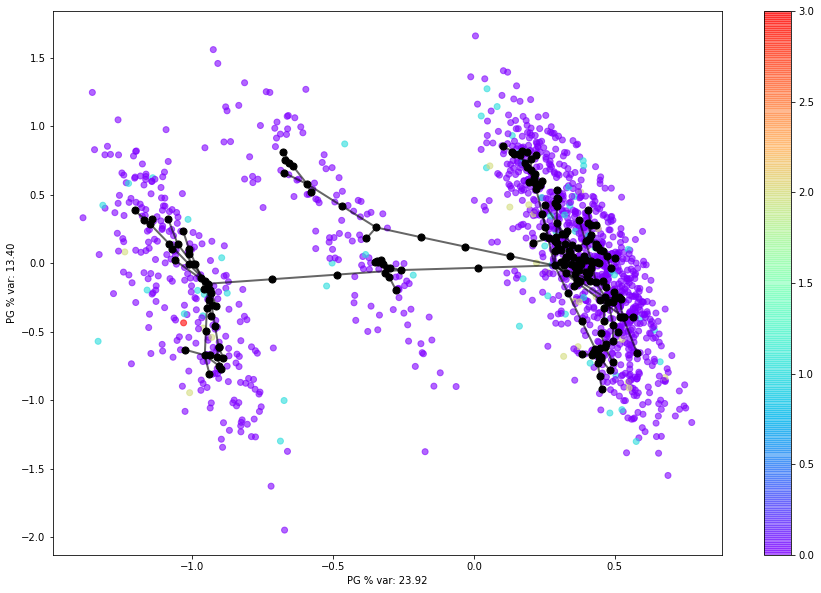

96   NA_R_3_n


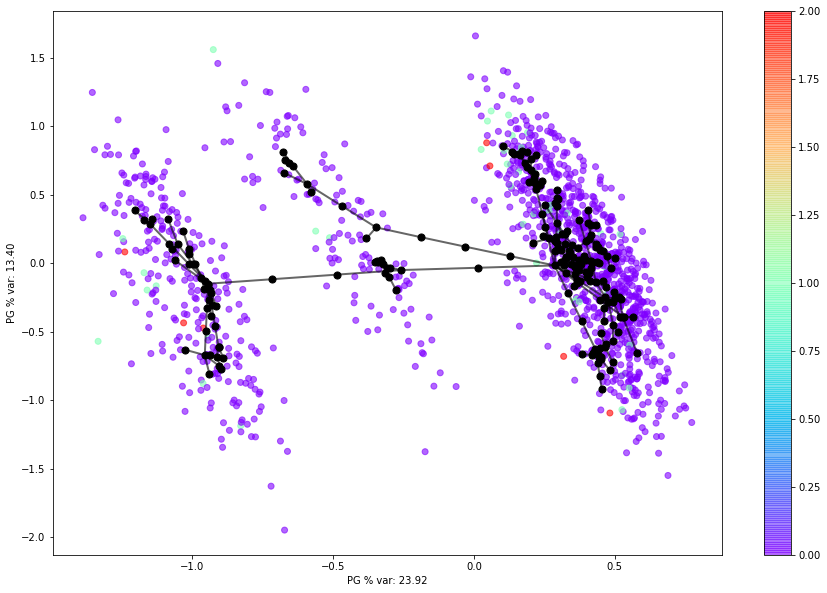

97   NOT_NA_1_n


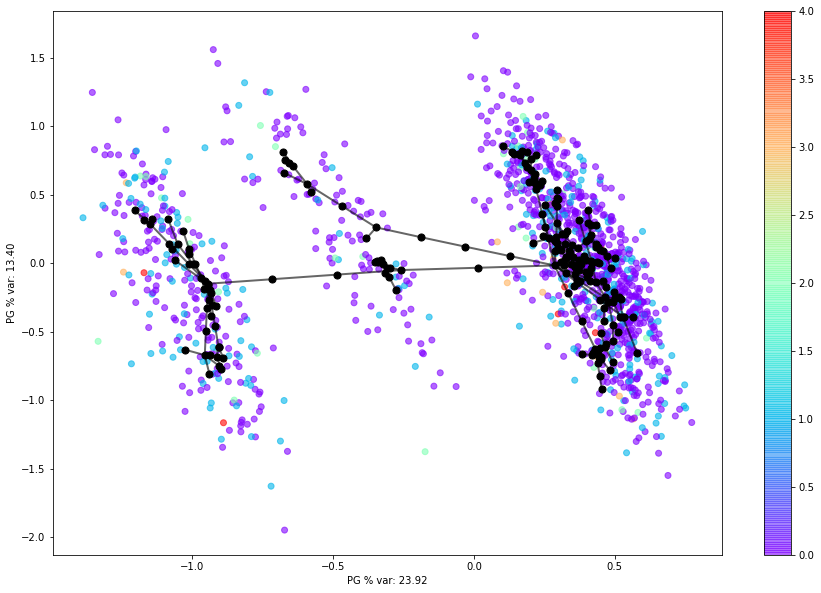

98   NOT_NA_2_n


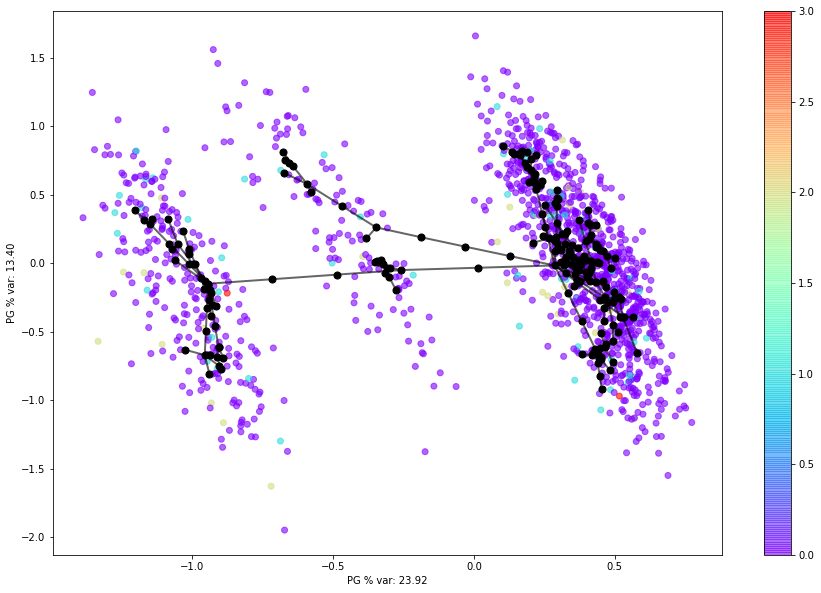

99   NOT_NA_3_n


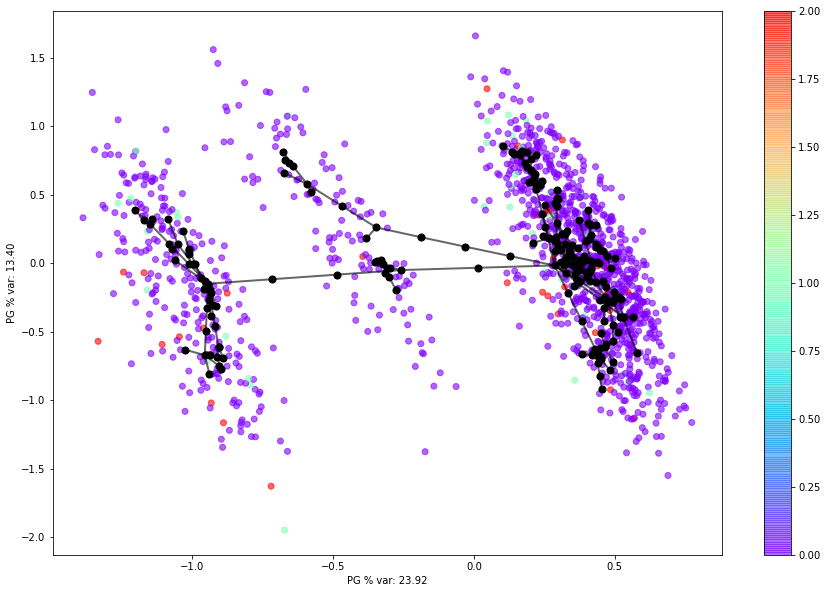

100   LID_S_n


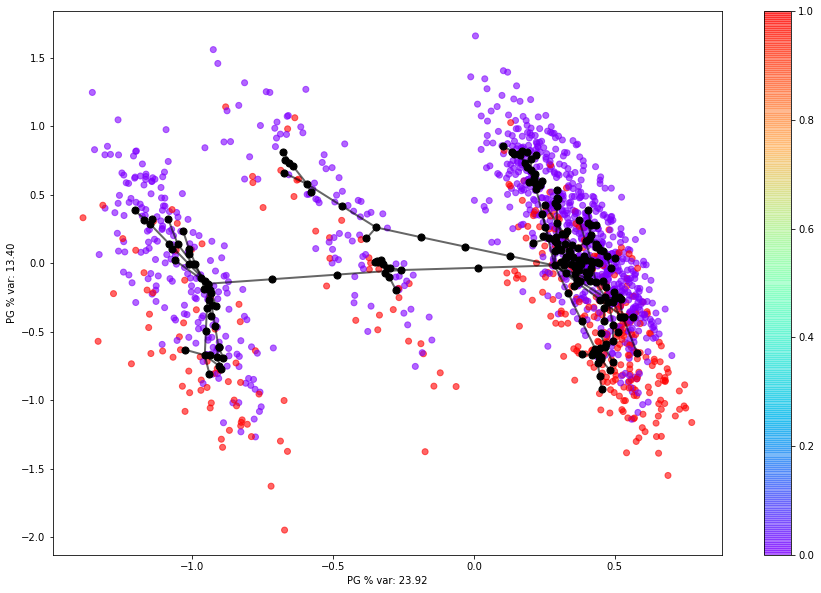

101   B_BLOK_S_n


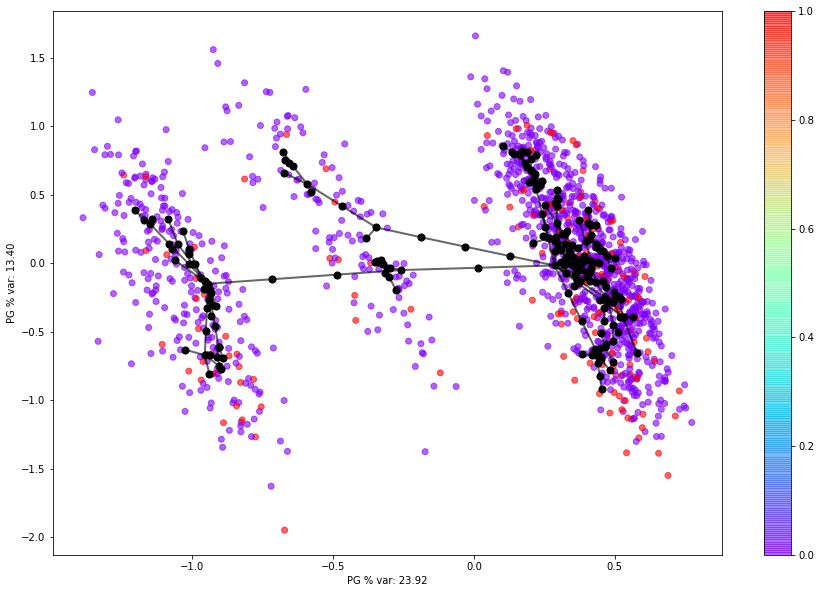

102   ANT_CA_S_n


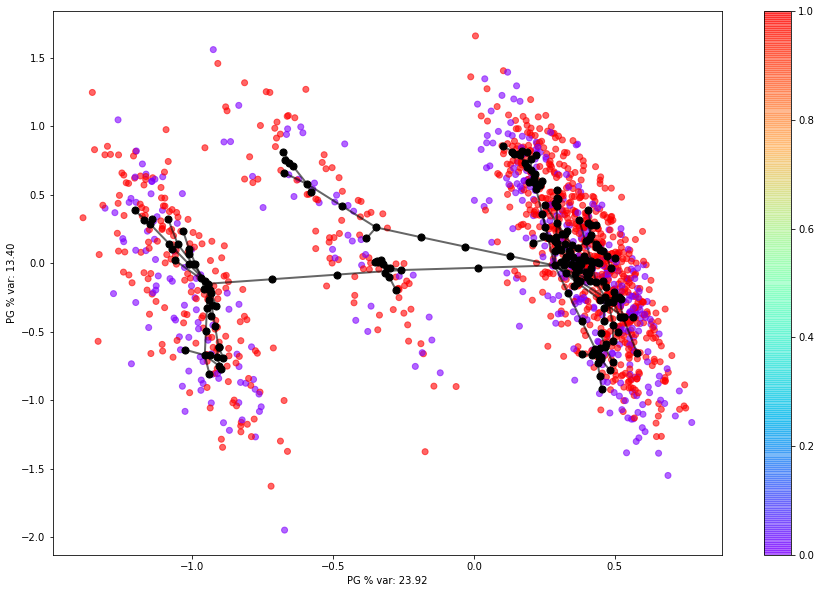

103   GEPAR_S_n


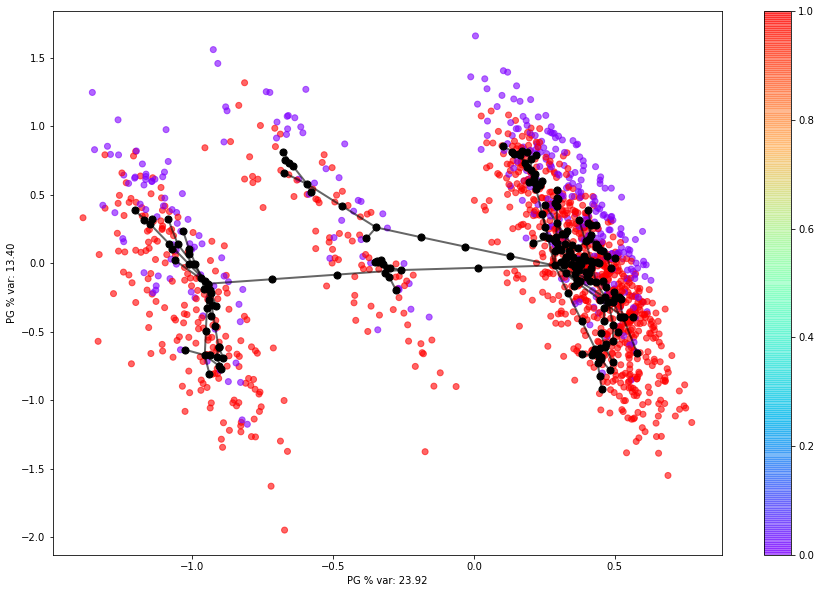

104   ASP_S_n


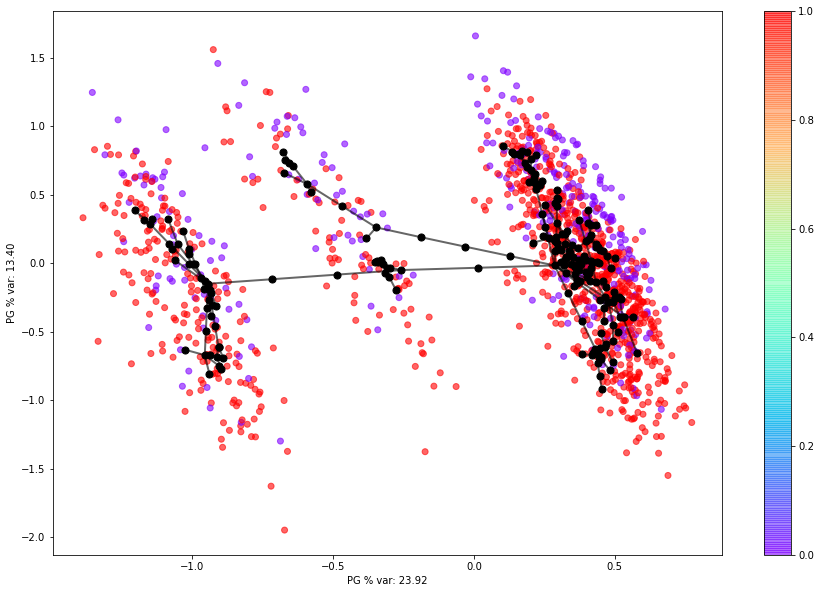

105   TIKL_S_n


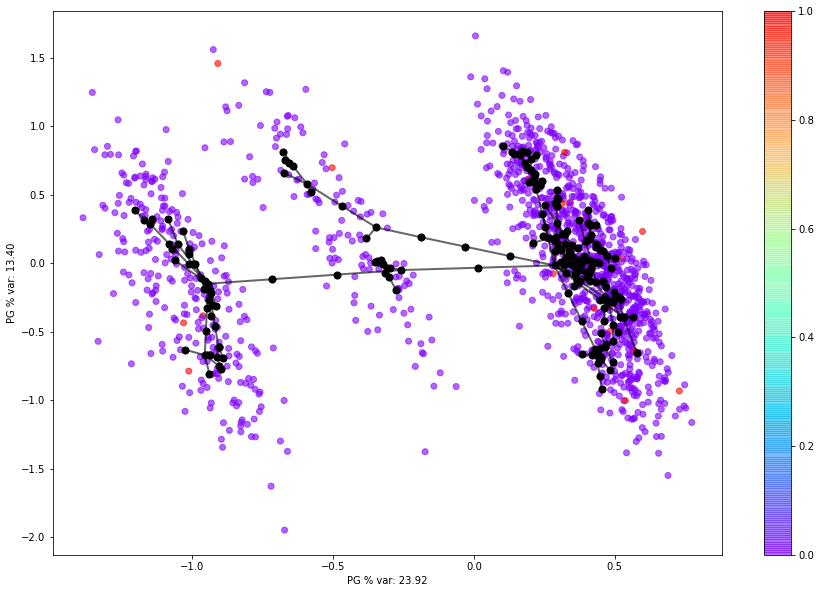

106   TRENT_S_n


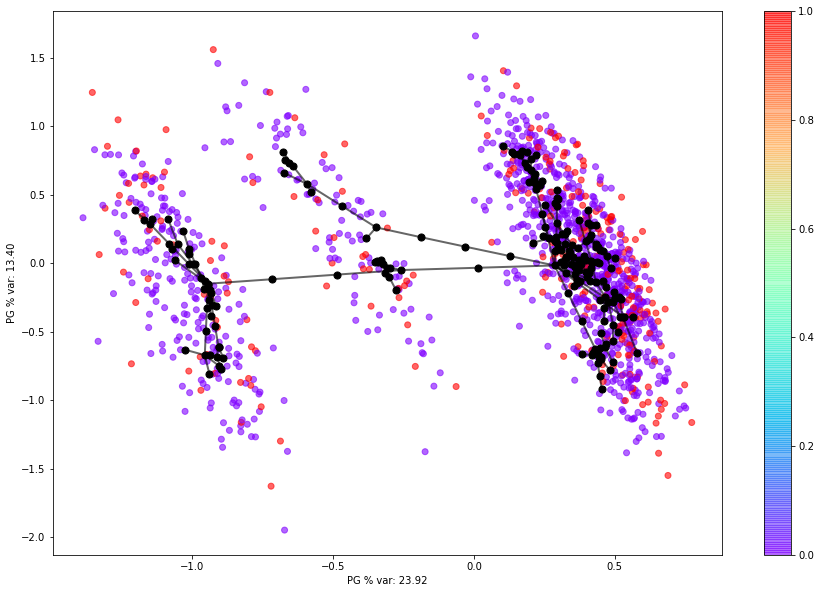

In [117]:
for n, i in enumerate(nice_data.keys()):
    print(n, ' ', i)
    elpigraph.plot.ColoredPlotPG(data, tree_200[0], X_color=nice_data[i].to_numpy(), X_cmap='rainbow')

In [34]:
curve_50 = elpigraph.computeElasticPrincipalCurve(data, 50)

Generating the initial configuration
Creating a chain in the 1st PC with 2 nodes
90% of the points have been used as initial conditions. Resetting.
Constructing tree 1 of 1 / Subset 1 of 1
Performing PCA
Using standard PCA
107 dimensions are being used
100.0 % of the original variance has been retained
The elastic matrix is being used. Edge configuration will be ignored
Computing EPG with  50  nodes on  1275  points and  107  dimensions
Nodes =  2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 

BARCODE	ENERGY	NNODES	NEDGES	NRIBS	NSTARS	NRAYS	NRAYS2	MSE	MSEP	FVE	FVEP	UE	UR	URN	URN2	URSD

0||50	4.0797	50	49	48	0	0	0	3.938	3.9345	0.2689	0.2695	0.0711	0.0706	3.5276	176.3789	0


10.0816  seconds elapsed


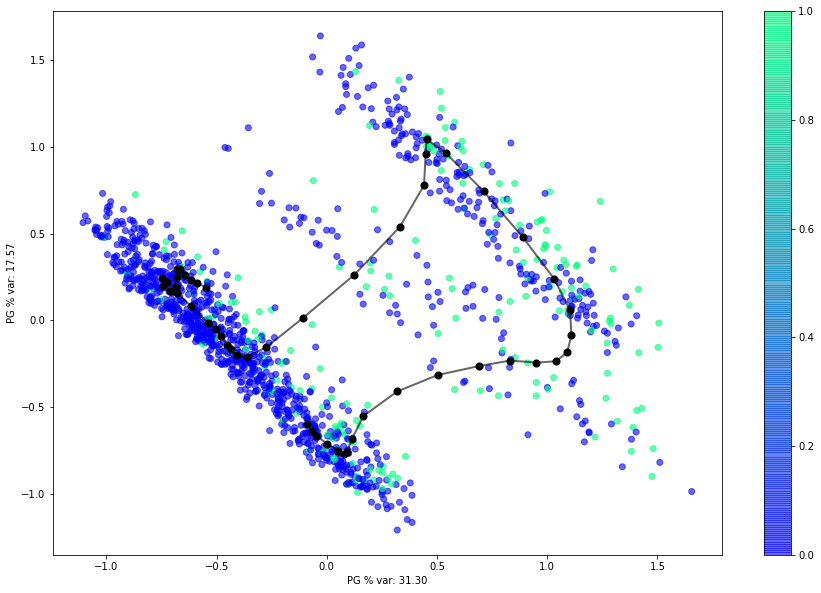

In [35]:
elpigraph.plot.ColoredPlotPG(data, curve_50[0], X_color=y_trains['LET_IS_BIN'].to_numpy(), X_cmap='winter')

In [37]:
curve_100 = elpigraph.computeElasticPrincipalCurve(data, 100)

Generating the initial configuration
Creating a chain in the 1st PC with 2 nodes
90% of the points have been used as initial conditions. Resetting.
Constructing tree 1 of 1 / Subset 1 of 1
Performing PCA
Using standard PCA
107 dimensions are being used
100.0 % of the original variance has been retained
The elastic matrix is being used. Edge configuration will be ignored
Computing EPG with  100  nodes on  1275  points and  107  dimensions
Nodes =  2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89 90 91 92 93 94 95 96 97 98 99 

BARCODE	ENERGY	NNODES	NEDGES	NRIBS	NSTARS	NRAYS	NRAYS2	MSE	MSEP	FVE	FVEP	UE	UR	URN	URN2	URSD

0||100	3.8538	100	99	98	0	0	0	3.6975	3.6959	0.3135	0.3138	0.0899	0.0665	6.6458	664.5807	0


52.8134  seconds elapsed


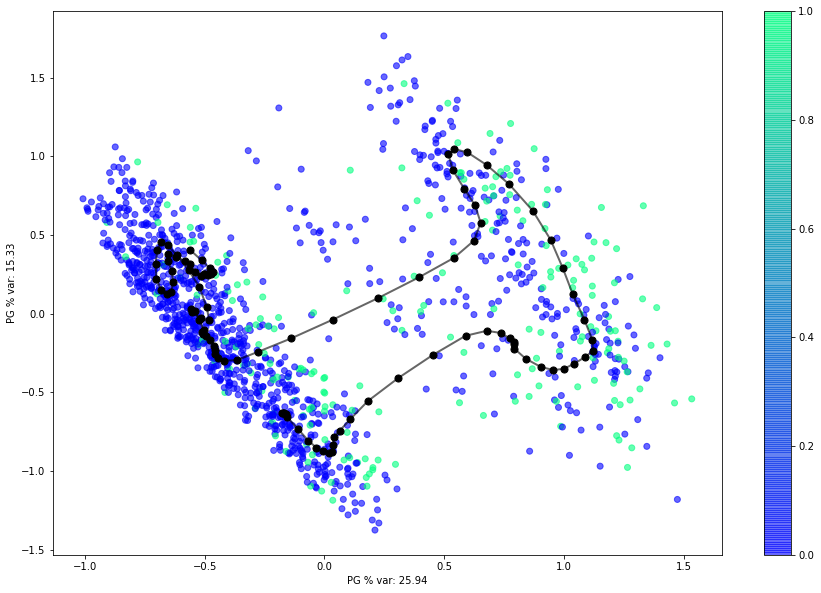

In [38]:
elpigraph.plot.ColoredPlotPG(data, curve_100[0], X_color=y_trains['LET_IS_BIN'].to_numpy(), X_cmap='winter')

In [41]:
curve_200 = elpigraph.computeElasticPrincipalCurve(data, 200)

Generating the initial configuration
Creating a chain in the 1st PC with 2 nodes
90% of the points have been used as initial conditions. Resetting.
Constructing tree 1 of 1 / Subset 1 of 1
Performing PCA
Using standard PCA
107 dimensions are being used
100.0 % of the original variance has been retained
The elastic matrix is being used. Edge configuration will be ignored
Computing EPG with  200  nodes on  1275  points and  107  dimensions
Nodes =  2 3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89 90 91 92 93 94 95 96 97 98 99 100 101 102 103 104 105 106 107 108 109 110 111 112 113 114 115 116 117 118 119 120 121 122 123 124 125 126 127 128 129 130 131 132 133 134 135 136 137 138 139 140 141 142 143 144 145 146 147 148 149 150 151 152 153 154 155 156 157 158 159 160 161 162 163 164 165

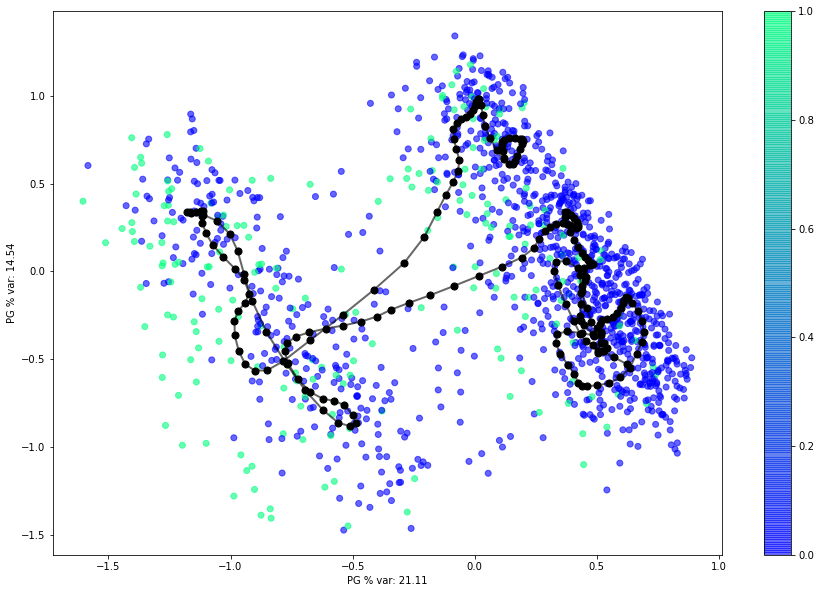

In [42]:
elpigraph.plot.ColoredPlotPG(data, curve_200[0], X_color=y_trains['LET_IS_BIN'].to_numpy(), X_cmap='winter')

In [43]:
circle_50 = elpigraph.computeElasticPrincipalCircle(data, 50)

The initial number of nodes must be at least 3. This will be fixed
Generating the initial configuration
Creating a circle in the plane induced by the 1st and 2nd PCs with 3 nodes
90% of the points have been used as initial conditions. Resetting.
Constructing tree 1 of 1 / Subset 1 of 1
Performing PCA
Using standard PCA
107 dimensions are being used
100.0 % of the original variance has been retained
The elastic matrix is being used. Edge configuration will be ignored
Computing EPG with  50  nodes on  1275  points and  107  dimensions
Nodes =  3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 

BARCODE	ENERGY	NNODES	NEDGES	NRIBS	NSTARS	NRAYS	NRAYS2	MSE	MSEP	FVE	FVEP	UE	UR	URN	URN2	URSD

0||50	4.0947	50	50	50	0	0	0	3.9456	3.9415	0.2674	0.2682	0.0737	0.0754	3.7692	188.4583	0


14.7927  seconds elapsed


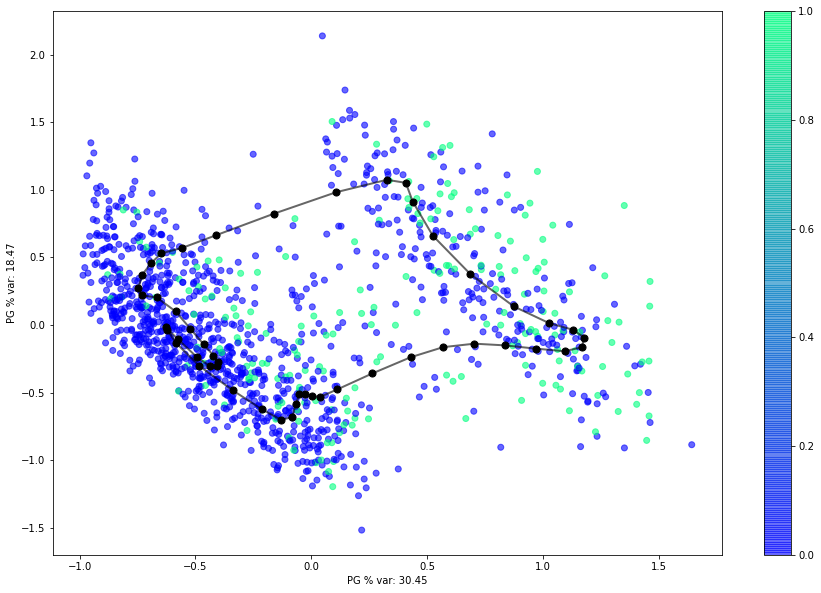

In [44]:
elpigraph.plot.ColoredPlotPG(data, circle_50[0], X_color=y_trains['LET_IS_BIN'].to_numpy(), X_cmap='winter')

In [45]:
circle_100 = elpigraph.computeElasticPrincipalCircle(data, 100)

The initial number of nodes must be at least 3. This will be fixed
Generating the initial configuration
Creating a circle in the plane induced by the 1st and 2nd PCs with 3 nodes
90% of the points have been used as initial conditions. Resetting.
Constructing tree 1 of 1 / Subset 1 of 1
Performing PCA
Using standard PCA
107 dimensions are being used
100.0 % of the original variance has been retained
The elastic matrix is being used. Edge configuration will be ignored
Computing EPG with  100  nodes on  1275  points and  107  dimensions
Nodes =  3 4 5 6 7 8 9 10 11 12 13 14 15 16 17 18 19 20 21 22 23 24 25 26 27 28 29 30 31 32 33 34 35 36 37 38 39 40 41 42 43 44 45 46 47 48 49 50 51 52 53 54 55 56 57 58 59 60 61 62 63 64 65 66 67 68 69 70 71 72 73 74 75 76 77 78 79 80 81 82 83 84 85 86 87 88 89 90 91 92 93 94 95 96 97 98 99 

BARCODE	ENERGY	NNODES	NEDGES	NRIBS	NSTARS	NRAYS	NRAYS2	MSE	MSEP	FVE	FVEP	UE	UR	URN	URN2	URSD

0||100	3.8572	100	100	100	0	0	0	3.6903	3.6888	0.3148	0.3151	0.0938	0.07

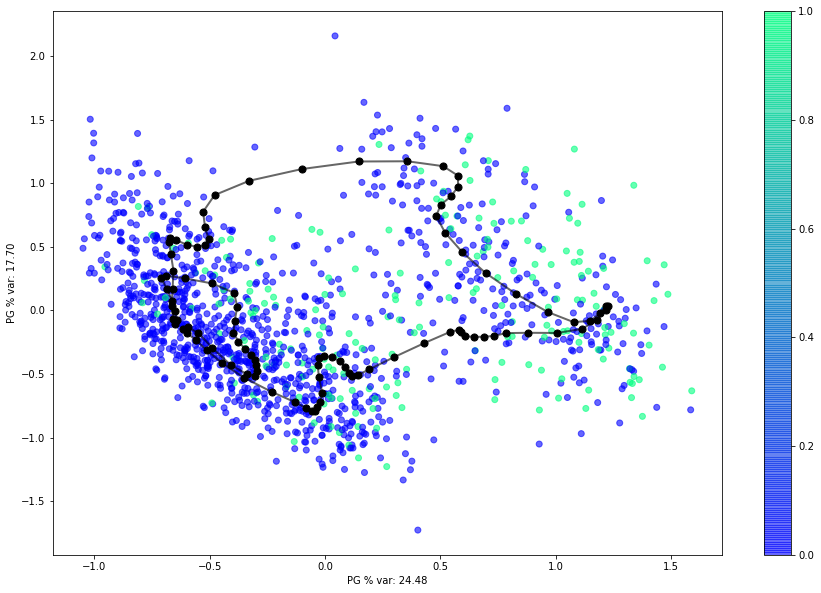

In [46]:
elpigraph.plot.ColoredPlotPG(data, circle_100[0], X_color=y_trains['LET_IS_BIN'].to_numpy(), X_cmap='winter')